In [34]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# **Learning Gradients of Convex Functions with monotone Gradient networks**

Thomas Gravier, Emilio Picard

In [35]:
import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

import os, sys

In [36]:
SEED = 7

DEVICE = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
torch.cuda.manual_seed(SEED)  # only if cuda is available

### **Toy Example of the paper**
The purpose here is to approximate the gradient of a convex function $f$.

Let $f$ be $f(x) = x_1^4 + \frac{x_2}{2} + \frac{x_1x_2}{2} + \frac{3x_2^2}{2} - \frac{x_2^3}{3}$, where $x = [x_1, x_2]^T$.

We want to approximate $\nabla f(x) = [4x_1^3 + \frac{x_2}{2}, \frac{1}{2}+ \frac{x_1}{2} + 3x_2 - x_2^2]$ with several methods of the paper.

In [37]:
# define f
def f(x1, x2):
    return x1**4 + (x2**2)/2 + (x1*x2)/2 + 3*(x2**2)/2 - (x2**3)/3

# define grad f
def grad_f(z): 
    x1 = z[:, 0]
    x2 = z[:, 1]
    return torch.stack([4*x1**3 + x2/2, 1/2 + x1/2 + 3*x2 - x2**2]).T

c:\Users\DAO.EZSPACE\anaconda3\envs\mva2\Lib\site-packages\torch\functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3610.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


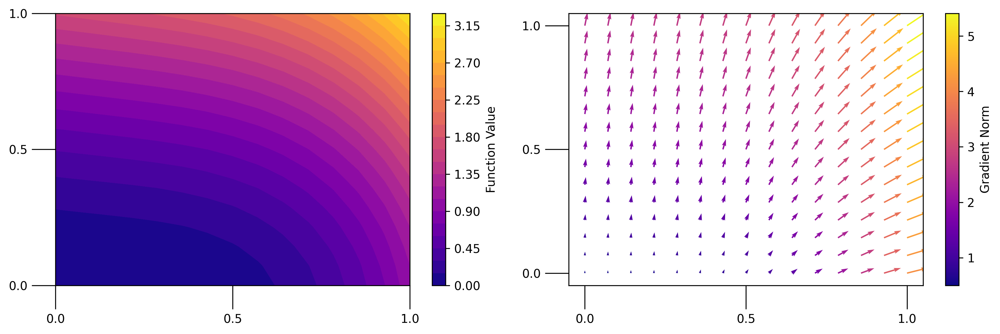

In [38]:
# WHAT WE WANT TO APPROXIMATE

x = torch.linspace(0, 1, 15)
y = torch.linspace(0, 1, 15)

X, Y = torch.meshgrid(x, y)
space = torch.cat([torch.reshape(X,(-1,1)),torch.reshape(Y,(-1,1))],1)
grad = grad_f(space)

cmap = 'plasma'
levels = 30

fig, axs = plt.subplots(1, 2, figsize=(12, 4), dpi=300)

# Create contour plot
contour = axs[0].contourf(x, y, f(space[:,0], space[:,1]).view(x.numel(),x.numel()).T, levels=levels, cmap=cmap)
axs[0].set_xticks([0, 0.5, 1.0])
axs[0].set_yticks([0, 0.5, 1.0])
axs[0].tick_params(axis='both', length=20, which='major')
cbar = fig.colorbar(contour, ax=axs[0])
cbar.set_label('Function Value')
cbar.ax.tick_params()

# Create quiver plot
quiver = axs[1].quiver(space[:,0], space[:,1], grad[:,0], grad[:,1], grad.norm(dim=-1), cmap=cmap)
axs[1].set_xticks([0, 0.5, 1.0])
axs[1].set_yticks([0, 0.5, 1.0])
axs[1].tick_params(axis='both', length=20, which='major')
cbar = fig.colorbar(quiver, ax=axs[1])
cbar.set_label('Gradient Norm')
cbar.ax.tick_params()

plt.tight_layout()
plt.show()
plt.close()

In [39]:
from torch.utils.data import TensorDataset, random_split, DataLoader
from models import CascadeGradNet, ModularGradNet

# get data: sample points from the unit square
sampled_points = torch.rand((1000000, 2))

DATASET = TensorDataset(sampled_points, grad_f(sampled_points))
split = int(0.8 * len(DATASET))
TRAIN_SET, VAL_SET = random_split(DATASET, [split, len(DATASET) - split])
TRAIN_LOADER = DataLoader(TRAIN_SET, batch_size=5000, shuffle=True)
VAL_LOADER = DataLoader(VAL_SET, batch_size=5000, shuffle=False)

NUM_LAYERS, NUM_MODULES = 3, 3
IN_DIM = 2
EMBED_DIM = 8
ACTIVATTION = lambda : nn.Tanh()

# CascadeGradNet
model1 = CascadeGradNet(
    num_layers=NUM_LAYERS,
    in_dim=IN_DIM,
    embed_dim=EMBED_DIM,
    activation=ACTIVATTION
).to(DEVICE)
print(f"number of learnable parameters: {sum(p.size().numel() for p in model1.parameters() if p.requires_grad)}")

number of learnable parameters: 90


Let's Train the Gradients Networks for the toy example of the paper:

In [40]:
from tqdm import tqdm

def train_model(model, train_loader, val_loader, grad_f, model_name):
    optimizer = optim.Adam(model.parameters(), lr=3e-4)
    criterion = nn.MSELoss()

    global DEVICE, NUM_EPOCHS

    model.to(DEVICE)
    train_losses, val_losses = [], []
    best_val_loss = 1
    for epoch in tqdm(range(NUM_EPOCHS), desc=f"Training"):
        model.train()
        train_loss = 0
        for x, grads in train_loader:
            x, grads = x.to(DEVICE), grads.to(DEVICE)
            outputs = model(x)
            loss = criterion(outputs, grads)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        train_losses.append(train_loss / len(train_loader))

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for x, grads in val_loader:
                x, grads = x.to(DEVICE), grads.to(DEVICE)
                outputs = model(x)
                loss = criterion(outputs, grads)
                val_loss += loss.item()
        val_losses.append(val_loss / len(val_loader))

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), f"{model_name}.pt")

        if epoch+1 % 100 == 0:
            print("Epoch: ", epoch, "Train Loss: ", train_loss / len(train_loader), "Val Loss: ", val_loss / len(val_loader))

    return train_losses, val_losses

In [ ]:
NUM_EPOCHS = 100
print("Training CascadeGradNet")
print("device used: ", DEVICE)
train_losses_C, val_losses_C = train_model(
        model1,
        train_loader=TRAIN_LOADER,
        val_loader=VAL_LOADER,
        grad_f=grad_f,
        model_name='CascadeGradNet'
    )

Training CascadeGradNet
device used:  cuda


Training:   0%|          | 0/100 [00:00<?, ?it/s]

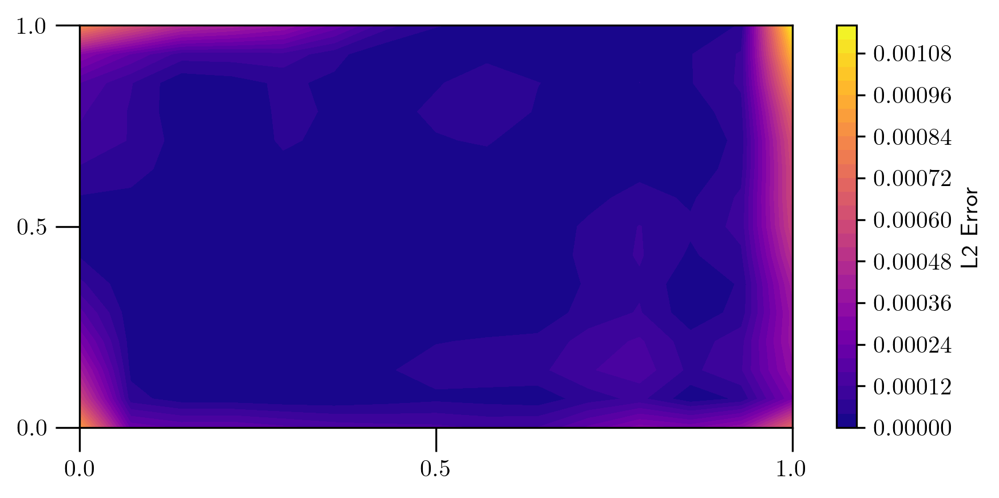

In [ ]:
# Compute the L2-error map
def compute_l2_error_map(model, space, grad_f):
    model.eval()
    with torch.no_grad():
        true_grads = grad_f(space).to(DEVICE)
        predicted_grads = model(space.to(DEVICE))
        l2_error = F.mse_loss(predicted_grads, true_grads, reduction='none').sum(dim=1).cpu()
    return l2_error

# Compute the L2-error map for CascadeGradNet
l2_error_map_C = compute_l2_error_map(model1, space, grad_f)

# Reshape the L2-error map to match the grid
l2_error_map_C = l2_error_map_C.view(x.numel(), y.numel()).T

# Plot the L2-error map
fig, ax = plt.subplots(figsize=(6, 3), dpi=300)
contour = ax.contourf(x, y, l2_error_map_C, levels=levels, cmap=cmap)
ax.set_xticks([0, 0.5, 1.0])
ax.set_yticks([0, 0.5, 1.0])
ax.tick_params(axis='both', length=10)
cbar = fig.colorbar(contour, ax=ax)
cbar.set_label('L2 Error')
cbar.ax.tick_params()

plt.tight_layout()
plt.show()
plt.close()

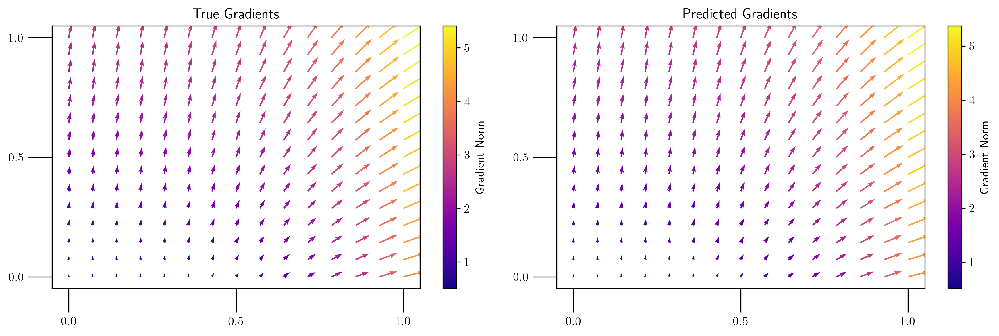

In [ ]:
# Predict gradients using the model
predicted_grad = model1(space.to(DEVICE)).detach().cpu()

# Plot the true and predicted gradients
fig, axs = plt.subplots(1, 2, figsize=(12, 4), dpi=300)

# Create quiver plot for true gradients
quiver_true = axs[0].quiver(space[:,0], space[:,1], grad[:,0], grad[:,1], grad.norm(dim=-1), cmap=cmap)
axs[0].set_title('True Gradients')
axs[0].set_xticks([0, 0.5, 1.0])
axs[0].set_yticks([0, 0.5, 1.0])
axs[0].tick_params(axis='both', length=20, which='major')
cbar_true = fig.colorbar(quiver_true, ax=axs[0])
cbar_true.set_label('Gradient Norm')
cbar_true.ax.tick_params()

# Create quiver plot for predicted gradients
quiver_pred = axs[1].quiver(space[:,0].cpu().numpy(), space[:,1].cpu().numpy(), predicted_grad[:,0].numpy(), predicted_grad[:,1].numpy(), predicted_grad.norm(dim=-1).numpy(), cmap=cmap)
axs[1].set_title('Predicted Gradients')
axs[1].set_xticks([0, 0.5, 1.0])
axs[1].set_yticks([0, 0.5, 1.0])
axs[1].tick_params(axis='both', length=20, which='major')
cbar_pred = fig.colorbar(quiver_pred, ax=axs[1])
cbar_pred.set_label('Gradient Norm')
cbar_pred.ax.tick_params()

plt.tight_layout()
plt.show()
plt.close()

## Toy Example 2 for another convex function:

$h(x) = \log(\exp(5x_1) + \exp(2x_2))$

$J_h(x) = [\frac{5\exp(5x_1)}{\exp(5x_1) + \exp(2x_2)}, \frac{2\exp(2x_2)}{\exp(5x_1) + \exp(2x_2)}]$

In [ ]:
# define f
def h(x1, x2):
    return torch.log(torch.exp(5 * x1) + torch.exp(2 * x2))

# define grad f
def grad_h(z): 
    x1 = z[:, 0]
    x2 = z[:, 1]
    return torch.stack([(5 * torch.exp(5 * x1)) / (torch.exp(5 * x1) + torch.exp(2 * x2)), 
                        (2 * torch.exp(2 * x2)) / (torch.exp(5 * x1) + torch.exp(2 * x2))]).T

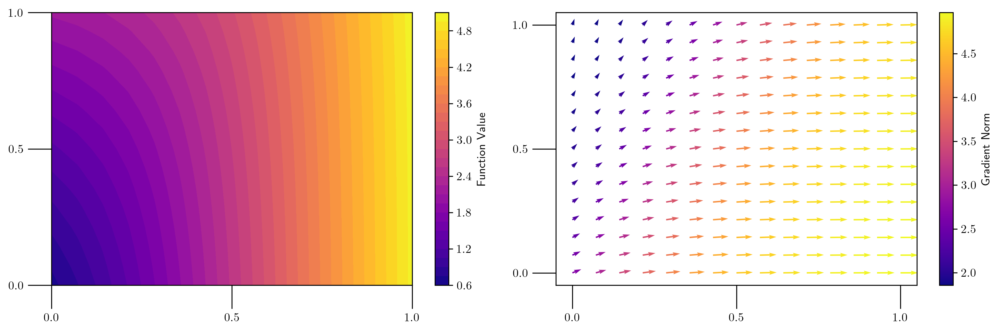

In [ ]:
# WHAT WE WANT TO APPROXIMATE

x = torch.linspace(0, 1, 15)
y = torch.linspace(0, 1, 15)

X, Y = torch.meshgrid(x, y)
space = torch.cat([torch.reshape(X,(-1,1)),torch.reshape(Y,(-1,1))],1)
grad = grad_h(space)

cmap = 'plasma'
levels = 30

fig, axs = plt.subplots(1, 2, figsize=(12, 4), dpi=300)

# Create contour plot
contour = axs[0].contourf(x, y, h(space[:,0], space[:,1]).view(x.numel(),x.numel()).T, levels=levels, cmap=cmap)
axs[0].set_xticks([0, 0.5, 1.0])
axs[0].set_yticks([0, 0.5, 1.0])
axs[0].tick_params(axis='both', length=20, which='major')
cbar = fig.colorbar(contour, ax=axs[0])
cbar.set_label('Function Value')
cbar.ax.tick_params()

# Create quiver plot
quiver = axs[1].quiver(space[:,0], space[:,1], grad[:,0], grad[:,1], grad.norm(dim=-1), cmap=cmap)
axs[1].set_xticks([0, 0.5, 1.0])
axs[1].set_yticks([0, 0.5, 1.0])
axs[1].tick_params(axis='both', length=20, which='major')
cbar = fig.colorbar(quiver, ax=axs[1])
cbar.set_label('Gradient Norm')
cbar.ax.tick_params()

plt.tight_layout()
plt.show()
plt.close()

In [ ]:
# ModularGradNet
model2 = ModularGradNet(
    num_modules=NUM_MODULES,
    in_dim=IN_DIM,
    embed_dim=EMBED_DIM,
    activation=ACTIVATTION
).to(DEVICE)
print(f"number of learnable parameters: {sum(p.size().numel() for p in model2.parameters() if p.requires_grad)}")

number of learnable parameters: 80


In [ ]:
NUM_EPOCHS = 100
print("Training ModularGradNet")
print("device used: ", DEVICE)
train_losses_C, val_losses_C = train_model(
        model2,
        train_loader=TRAIN_LOADER,
        val_loader=VAL_LOADER,
        grad_f=grad_f,
        model_name='ModularGradNet'
        
    )

Training ModularGradNet
device used:  cuda


Training:   0%|          | 0/100 [00:00<?, ?it/s]

Training: 100%|██████████| 100/100 [14:20<00:00,  8.61s/it]


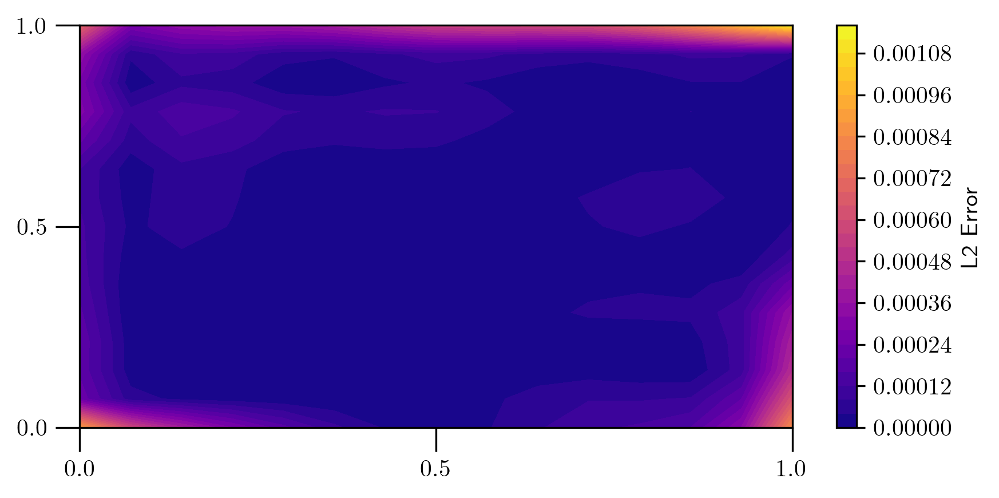

In [ ]:
# Compute the L2-error map for ModularGradNet
l2_error_map_M = compute_l2_error_map(model2, space, grad_h)
l2_error_map_M = l2_error_map_C.view(x.numel(), y.numel()).T

# Plot the L2-error map
fig, ax = plt.subplots(figsize=(6, 3), dpi=300)
contour = ax.contourf(x, y, l2_error_map_M, levels=levels, cmap=cmap)
ax.set_xticks([0, 0.5, 1.0])
ax.set_yticks([0, 0.5, 1.0])
ax.tick_params(axis='both', length=10)
cbar = fig.colorbar(contour, ax=ax)
cbar.set_label('L2 Error')
cbar.ax.tick_params()

plt.tight_layout()
plt.show()
plt.close()

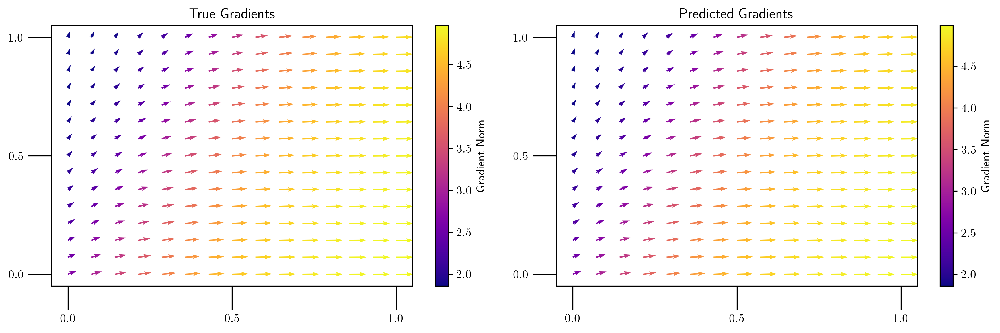

In [ ]:
# Predict gradients using the model
predicted_grad = model2(space.to(DEVICE)).detach().cpu()

# Plot the true and predicted gradients
fig, axs = plt.subplots(1, 2, figsize=(12, 4), dpi=300)

# Create quiver plot for true gradients
quiver_true = axs[0].quiver(space[:,0], space[:,1], grad[:,0], grad[:,1], grad.norm(dim=-1), cmap=cmap)
axs[0].set_title('True Gradients')
axs[0].set_xticks([0, 0.5, 1.0])
axs[0].set_yticks([0, 0.5, 1.0])
axs[0].tick_params(axis='both', length=20, which='major')
cbar_true = fig.colorbar(quiver_true, ax=axs[0])
cbar_true.set_label('Gradient Norm')
cbar_true.ax.tick_params()

# Create quiver plot for predicted gradients
quiver_pred = axs[1].quiver(space[:,0].cpu().numpy(), space[:,1].cpu().numpy(), predicted_grad[:,0].numpy(), predicted_grad[:,1].numpy(), predicted_grad.norm(dim=-1).numpy(), cmap=cmap)
axs[1].set_title('Predicted Gradients')
axs[1].set_xticks([0, 0.5, 1.0])
axs[1].set_yticks([0, 0.5, 1.0])
axs[1].tick_params(axis='both', length=20, which='major')
cbar_pred = fig.colorbar(quiver_pred, ax=axs[1])
cbar_pred.set_label('Gradient Norm')
cbar_pred.ax.tick_params()

plt.tight_layout()
plt.show()
plt.close()

## Train for transport of distribution

In [ ]:
import torch
import torch.optim as optim
from tqdm import tqdm

def train_model(model, train_loader, val_loader, CRITERION, NUM_EPOCHS, DEVICE, model_name='model'):
    optimizer = optim.Adam(model.parameters(), lr=3e-4)
    train_losses, val_losses = [], []
    best_val_loss = float('inf')

    for epoch in tqdm(range(NUM_EPOCHS), desc=f"Training {model_name}"):
        model.train()
        train_loss = 0

        for x, y in train_loader:
            x, y = x.to(DEVICE), y.to(DEVICE)
            outputs = model(x)
            loss = CRITERION(outputs, y)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        train_losses.append(train_loss / len(train_loader))

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for x, y in val_loader:
                x, y = x.to(DEVICE), y.to(DEVICE)
                outputs = model(x)
                loss = CRITERION(outputs, y)
                val_loss += loss.item()

        val_losses.append(val_loss / len(val_loader))

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), f"{model_name}.pt")

        if (epoch + 1) % 20 == 0:
            print(f"Epoch {epoch+1}/{NUM_EPOCHS} - Train Loss: {train_losses[-1]:.6f} - Val Loss: {val_losses[-1]:.6f}")

    return None


## **Transport Distributions: from Gaussian to Banana Shape**

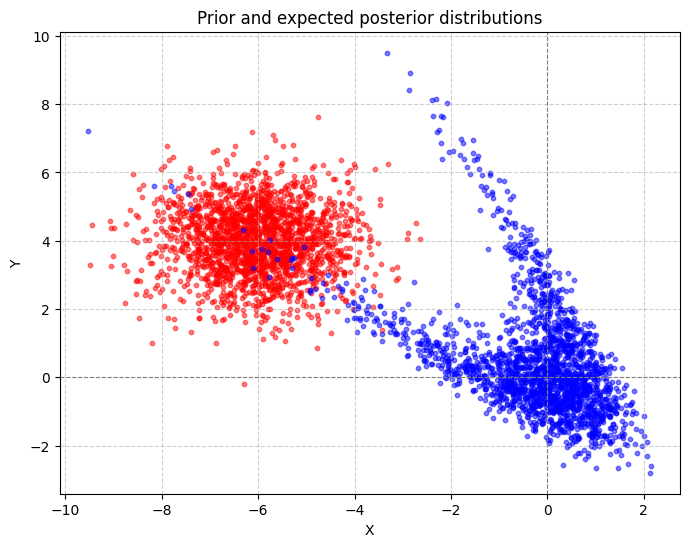

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from models import CascadeGradNet, ModularGradNet

n_samples = 2000  # Nombre d'échantillons

# Distribution en forme de banane
b = 1
c = 0.5
X_torch = torch.randn(n_samples)
Y_torch = torch.randn(n_samples)

Y_banana_torch = Y_torch + b * (X_torch**2 - c)
theta_torch = torch.tensor(np.pi / 5, dtype=torch.float32, device=X_torch.device)  # Rotation de π/5
rotation_matrix_torch = torch.tensor([
    [torch.cos(theta_torch), -torch.sin(theta_torch)],
    [torch.sin(theta_torch), torch.cos(theta_torch)]
], dtype=torch.float32, device=X_torch.device)

points_torch = torch.stack((X_torch, Y_banana_torch))  # Regrouper les points
rotated_points_torch = torch.matmul(rotation_matrix_torch, points_torch)  # Appliquer la rotation
X_rotated_torch, Y_rotated_torch = rotated_points_torch.cpu().numpy()

# Distribution gaussienne
mu = np.array([-6, 4])
cov = np.array([[1, 0], [0, 1]])
data2 = np.random.multivariate_normal(mu, cov, n_samples)
X_gaussian_torch = torch.tensor(data2[:, 0], dtype=torch.float32, device=X_torch.device)
Y_gaussian_torch = torch.tensor(data2[:, 1], dtype=torch.float32, device=X_torch.device)

# Tracé de la distribution en banane avec rotation
plt.figure(figsize=(8, 6))
plt.scatter(X_gaussian_torch, Y_gaussian_torch, alpha=0.5, s=10, color='red')
plt.scatter(X_rotated_torch, Y_rotated_torch, alpha=0.5, s=10, color='blue')
plt.title("Prior and expected posterior distributions")
plt.xlabel("X")
plt.ylabel("Y")
plt.axhline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne horizontale
plt.axvline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne verticale
plt.grid(True, linestyle='--', alpha=0.6)
plt.show(block=True)
plt.close()


In [ ]:
import torch 
from torch.utils.data import DataLoader, TensorDataset
import os

# Conversion des données en tenseurs PyTorch
tensor_data_gaussian = torch.tensor(data2, dtype=torch.float32)  # Source (gaussienne)
tensor_data_banana = rotated_points_torch.T  # Cible (banane), déjà un tenseur

# Vérification des dimensions pour éviter les erreurs
assert tensor_data_gaussian.shape == tensor_data_banana.shape, \
    f"Les formes des données ne correspondent pas: {tensor_data_gaussian.shape} vs {tensor_data_banana.shape}"

# Création des datasets
train_dataset = TensorDataset(tensor_data_gaussian[:1600], tensor_data_banana[:1600])
val_dataset = TensorDataset(tensor_data_gaussian[1600:], tensor_data_banana[1600:])

# Détection du nombre de workers optimisé
num_workers = min(4, os.cpu_count())  # Utilisation de 4 workers ou du max dispo

# Chargement des données optimisé
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)


### CascadeGradNet

In [ ]:
from geomloss import SamplesLoss
CRITERION = SamplesLoss("sinkhorn", p=2, blur=0.05, backend="tensorized")

NUM_EPOCHS = 1000

NUM_LAYERS = 6
IN_DIM = 2
EMBED_DIM = 16
ACTIVATION = lambda : nn.Tanh()

model1 = CascadeGradNet(
    num_layers=NUM_LAYERS,
    in_dim=IN_DIM,
    embed_dim=EMBED_DIM,
    activation=ACTIVATION
).to(DEVICE)

train_model(model1, train_loader, val_loader, CRITERION, NUM_EPOCHS, DEVICE, model_name='CascadeGradNet')

Training CascadeGradNet:   0%|          | 4/1000 [00:02<10:29,  1.58it/s]


KeyboardInterrupt: 

C:\Users\DAO.EZSPACE\AppData\Local\Temp\ipykernel_20344\2448879733.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load("CascadeGradNetBanan

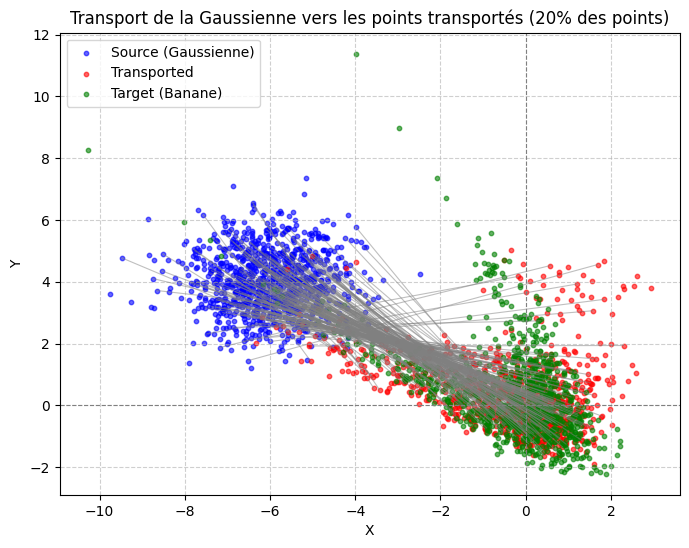

In [ ]:


# Charger le modèle entraîné
model1.load_state_dict(torch.load("CascadeGradNetBanana.pt"))
model1.eval()

# Générer un échantillon de la gaussienne source
source_samples = tensor_data_gaussian[:1000].to(DEVICE)  # Prendre 1000 points pour la visualisation

# Passer par le modèle pour obtenir les points transportés
with torch.no_grad():
    transported_samples = model1(source_samples).cpu().numpy()

# Récupérer les données originales pour comparer
source_samples = source_samples.cpu().numpy()
target_samples = tensor_data_banana[:1000].cpu().numpy()  # La banane est la distribution cible

# Définir la proportion de points à relier (20% des points)
sampling_rate = 0.2  # 20% des points
num_points = len(source_samples)
num_sampled = max(1, int(sampling_rate * num_points))  # S'assurer d'avoir au moins 1 point sélectionné

# Sélectionner aléatoirement les indices des points à connecter
sampled_indices = np.random.choice(num_points, num_sampled, replace=False)

plt.figure(figsize=(8, 6))

# Tracer les segments de transport (Source -> Transporté) pour 20% des points sélectionnés
for i in sampled_indices:
    plt.plot([source_samples[i, 0], transported_samples[i, 0]], 
             [source_samples[i, 1], transported_samples[i, 1]], 
             color='gray', alpha=0.5, linewidth=0.8)  # Traits gris pour visualiser le transport

# Source avant transport (en bleu)
plt.scatter(source_samples[:, 0], source_samples[:, 1], alpha=0.6, s=10, color='blue', label='Source (Gaussienne)')

# Source après transport par le modèle (en rouge)
plt.scatter(transported_samples[:, 0], transported_samples[:, 1], alpha=0.6, s=10, color='red', label='Transported')

# Distribution cible (Banane) (en vert) - sans traits
plt.scatter(target_samples[:, 0], target_samples[:, 1], alpha=0.6, s=10, color='green', label='Target (Banane)')

plt.title("Transport de la Gaussienne vers les points transportés (20% des points)")
plt.xlabel("X")
plt.ylabel("Y")
plt.axhline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne horizontale
plt.axvline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne verticale
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()


In [ ]:
from scipy.stats import wasserstein_distance

# Calculer la distance de Wasserstein pour chaque dimension séparément
wd_x = wasserstein_distance(transported_samples[:, 0], target_samples[:, 0])
wd_y = wasserstein_distance(transported_samples[:, 1], target_samples[:, 1])

# Distance moyenne entre les deux distributions
wasserstein_dist = (wd_x + wd_y) / 2

wasserstein_dist


0.19364033960644156

### M-MGN

In [ ]:
from geomloss import SamplesLoss
CRITERION = SamplesLoss("sinkhorn", p=2, blur=0.05, backend="tensorized")

NUM_EPOCHS = 1000

NUM_MODULES = 6
IN_DIM = 2
EMBED_DIM = 16
ACTIVATION = lambda : nn.Tanh()

model1 = ModularGradNet(
    num_modules=NUM_BLOCKS,
    in_dim=IN_DIM,
    embed_dim=EMBED_DIM,
    activation=ACTIVATION
).to(DEVICE)

train_model(model1, train_loader, val_loader, CRITERION, NUM_EPOCHS, DEVICE, model_name='M-GradNet')

Training M-GradNet:   2%|▏         | 20/1000 [00:12<10:16,  1.59it/s]

Epoch 20/1000 - Train Loss: 2.135186 - Val Loss: 2.556038


Training M-GradNet:   4%|▍         | 40/1000 [00:25<09:47,  1.64it/s]

Epoch 40/1000 - Train Loss: 1.038925 - Val Loss: 1.377906


Training M-GradNet:   6%|▌         | 60/1000 [00:37<09:49,  1.60it/s]

Epoch 60/1000 - Train Loss: 0.819241 - Val Loss: 1.133335


Training M-GradNet:   8%|▊         | 80/1000 [00:50<09:24,  1.63it/s]

Epoch 80/1000 - Train Loss: 0.717198 - Val Loss: 1.018434


Training M-GradNet:  10%|█         | 100/1000 [01:02<09:03,  1.66it/s]

Epoch 100/1000 - Train Loss: 0.666369 - Val Loss: 0.917816


Training M-GradNet:  12%|█▏        | 120/1000 [01:13<08:38,  1.70it/s]

Epoch 120/1000 - Train Loss: 0.571152 - Val Loss: 0.791748


Training M-GradNet:  14%|█▍        | 140/1000 [01:25<08:40,  1.65it/s]

Epoch 140/1000 - Train Loss: 0.478643 - Val Loss: 0.694002


Training M-GradNet:  16%|█▌        | 160/1000 [01:38<08:29,  1.65it/s]

Epoch 160/1000 - Train Loss: 0.446824 - Val Loss: 0.591888


Training M-GradNet:  18%|█▊        | 180/1000 [01:50<08:06,  1.68it/s]

Epoch 180/1000 - Train Loss: 0.349113 - Val Loss: 0.518980


Training M-GradNet:  20%|██        | 200/1000 [02:02<08:07,  1.64it/s]

Epoch 200/1000 - Train Loss: 0.320817 - Val Loss: 0.459518


Training M-GradNet:  22%|██▏       | 220/1000 [02:14<07:52,  1.65it/s]

Epoch 220/1000 - Train Loss: 0.272271 - Val Loss: 0.424389


Training M-GradNet:  24%|██▍       | 240/1000 [02:26<07:53,  1.60it/s]

Epoch 240/1000 - Train Loss: 0.303940 - Val Loss: 0.400194


Training M-GradNet:  26%|██▌       | 260/1000 [02:39<07:35,  1.63it/s]

Epoch 260/1000 - Train Loss: 0.292986 - Val Loss: 0.386190


Training M-GradNet:  28%|██▊       | 280/1000 [02:51<07:13,  1.66it/s]

Epoch 280/1000 - Train Loss: 0.299943 - Val Loss: 0.378399


Training M-GradNet:  30%|███       | 300/1000 [03:03<07:03,  1.65it/s]

Epoch 300/1000 - Train Loss: 0.286109 - Val Loss: 0.367536


Training M-GradNet:  32%|███▏      | 320/1000 [03:14<06:30,  1.74it/s]

Epoch 320/1000 - Train Loss: 0.342579 - Val Loss: 0.363009


Training M-GradNet:  34%|███▍      | 340/1000 [03:26<06:20,  1.73it/s]

Epoch 340/1000 - Train Loss: 0.278852 - Val Loss: 0.359879


Training M-GradNet:  36%|███▌      | 360/1000 [03:38<06:34,  1.62it/s]

Epoch 360/1000 - Train Loss: 0.315855 - Val Loss: 0.358542


Training M-GradNet:  38%|███▊      | 380/1000 [03:50<06:19,  1.63it/s]

Epoch 380/1000 - Train Loss: 0.287353 - Val Loss: 0.356833


Training M-GradNet:  40%|████      | 400/1000 [04:02<05:55,  1.69it/s]

Epoch 400/1000 - Train Loss: 0.291548 - Val Loss: 0.354797


Training M-GradNet:  42%|████▏     | 420/1000 [04:14<05:58,  1.62it/s]

Epoch 420/1000 - Train Loss: 0.332656 - Val Loss: 0.352490


Training M-GradNet:  44%|████▍     | 440/1000 [04:26<05:26,  1.72it/s]

Epoch 440/1000 - Train Loss: 0.273579 - Val Loss: 0.351150


Training M-GradNet:  46%|████▌     | 460/1000 [04:38<05:32,  1.62it/s]

Epoch 460/1000 - Train Loss: 0.304979 - Val Loss: 0.352282


Training M-GradNet:  48%|████▊     | 480/1000 [04:50<05:11,  1.67it/s]

Epoch 480/1000 - Train Loss: 0.314187 - Val Loss: 0.352010


Training M-GradNet:  50%|█████     | 500/1000 [05:02<05:02,  1.65it/s]

Epoch 500/1000 - Train Loss: 0.277754 - Val Loss: 0.350695


Training M-GradNet:  52%|█████▏    | 520/1000 [05:14<04:42,  1.70it/s]

Epoch 520/1000 - Train Loss: 0.259712 - Val Loss: 0.352477


Training M-GradNet:  54%|█████▍    | 540/1000 [05:26<04:42,  1.63it/s]

Epoch 540/1000 - Train Loss: 0.329563 - Val Loss: 0.348904


Training M-GradNet:  56%|█████▌    | 560/1000 [05:38<04:15,  1.72it/s]

Epoch 560/1000 - Train Loss: 0.331137 - Val Loss: 0.345524


Training M-GradNet:  58%|█████▊    | 580/1000 [05:50<04:11,  1.67it/s]

Epoch 580/1000 - Train Loss: 0.344257 - Val Loss: 0.348019


Training M-GradNet:  60%|██████    | 600/1000 [06:01<03:48,  1.75it/s]

Epoch 600/1000 - Train Loss: 0.354110 - Val Loss: 0.349304


Training M-GradNet:  62%|██████▏   | 620/1000 [06:13<03:43,  1.70it/s]

Epoch 620/1000 - Train Loss: 0.355027 - Val Loss: 0.348370


Training M-GradNet:  64%|██████▍   | 640/1000 [06:25<03:34,  1.68it/s]

Epoch 640/1000 - Train Loss: 0.295144 - Val Loss: 0.350806


Training M-GradNet:  66%|██████▌   | 660/1000 [06:38<03:28,  1.63it/s]

Epoch 660/1000 - Train Loss: 0.331466 - Val Loss: 0.346743


Training M-GradNet:  68%|██████▊   | 680/1000 [06:49<03:11,  1.67it/s]

Epoch 680/1000 - Train Loss: 0.339857 - Val Loss: 0.353261


Training M-GradNet:  70%|███████   | 700/1000 [07:01<02:54,  1.72it/s]

Epoch 700/1000 - Train Loss: 0.256075 - Val Loss: 0.348817


Training M-GradNet:  72%|███████▏  | 720/1000 [07:13<02:40,  1.75it/s]

Epoch 720/1000 - Train Loss: 0.309607 - Val Loss: 0.349622


Training M-GradNet:  74%|███████▍  | 740/1000 [07:24<02:30,  1.73it/s]

Epoch 740/1000 - Train Loss: 0.259660 - Val Loss: 0.352187


Training M-GradNet:  76%|███████▌  | 760/1000 [07:36<02:24,  1.66it/s]

Epoch 760/1000 - Train Loss: 0.282016 - Val Loss: 0.347504


Training M-GradNet:  78%|███████▊  | 780/1000 [07:48<02:07,  1.73it/s]

Epoch 780/1000 - Train Loss: 0.290103 - Val Loss: 0.347526


Training M-GradNet:  80%|████████  | 800/1000 [08:00<02:01,  1.64it/s]

Epoch 800/1000 - Train Loss: 0.325723 - Val Loss: 0.344523


Training M-GradNet:  82%|████████▏ | 820/1000 [08:12<01:54,  1.58it/s]

Epoch 820/1000 - Train Loss: 0.269388 - Val Loss: 0.347037


Training M-GradNet:  84%|████████▍ | 840/1000 [08:24<01:36,  1.65it/s]

Epoch 840/1000 - Train Loss: 0.332641 - Val Loss: 0.343077


Training M-GradNet:  86%|████████▌ | 860/1000 [08:37<01:25,  1.63it/s]

Epoch 860/1000 - Train Loss: 0.286768 - Val Loss: 0.343190


Training M-GradNet:  88%|████████▊ | 880/1000 [08:49<01:13,  1.64it/s]

Epoch 880/1000 - Train Loss: 0.306788 - Val Loss: 0.349211


Training M-GradNet:  90%|█████████ | 900/1000 [09:01<01:02,  1.60it/s]

Epoch 900/1000 - Train Loss: 0.291403 - Val Loss: 0.347758


Training M-GradNet:  92%|█████████▏| 920/1000 [09:14<00:48,  1.64it/s]

Epoch 920/1000 - Train Loss: 0.328629 - Val Loss: 0.341513


Training M-GradNet:  94%|█████████▍| 940/1000 [09:26<00:36,  1.64it/s]

Epoch 940/1000 - Train Loss: 0.317033 - Val Loss: 0.342572


Training M-GradNet:  96%|█████████▌| 960/1000 [09:37<00:22,  1.74it/s]

Epoch 960/1000 - Train Loss: 0.334668 - Val Loss: 0.344710


Training M-GradNet:  98%|█████████▊| 980/1000 [09:49<00:11,  1.70it/s]

Epoch 980/1000 - Train Loss: 0.342248 - Val Loss: 0.342932


Training M-GradNet: 100%|██████████| 1000/1000 [10:01<00:00,  1.66it/s]

Epoch 1000/1000 - Train Loss: 0.324662 - Val Loss: 0.342848


C:\Users\DAO.EZSPACE\AppData\Local\Temp\ipykernel_20344\2581720177.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load("M-GradNetBanana.pt"

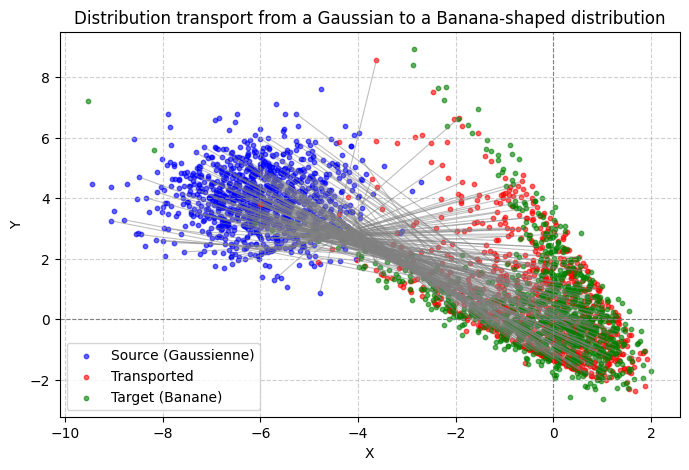

In [ ]:


# Charger le modèle entraîné
model1.load_state_dict(torch.load("M-GradNetBanana.pt"))
model1.eval()

# Générer un échantillon de la gaussienne source
source_samples = tensor_data_gaussian[:1000].to(DEVICE)  # Prendre 1000 points pour la visualisation

# Passer par le modèle pour obtenir les points transportés
with torch.no_grad():
    transported_samples = model1(source_samples).cpu().numpy()

# Récupérer les données originales pour comparer
source_samples = source_samples.cpu().numpy()
target_samples = tensor_data_banana[:1000].cpu().numpy()  # La banane est la distribution cible

# Définir la proportion de points à relier (20% des points)
sampling_rate = 0.2  # 20% des points
num_points = len(source_samples)
num_sampled = max(1, int(sampling_rate * num_points))  # S'assurer d'avoir au moins 1 point sélectionné

# Sélectionner aléatoirement les indices des points à connecter
sampled_indices = np.random.choice(num_points, num_sampled, replace=False)

plt.figure(figsize=(8, 5))

# Tracer les segments de transport (Source -> Transporté) pour 20% des points sélectionnés
for i in sampled_indices:
    plt.plot([source_samples[i, 0], transported_samples[i, 0]], 
             [source_samples[i, 1], transported_samples[i, 1]], 
             color='gray', alpha=0.5, linewidth=0.8)  # Traits gris pour visualiser le transport

# Source avant transport (en bleu)
plt.scatter(source_samples[:, 0], source_samples[:, 1], alpha=0.6, s=10, color='blue', label='Source (Gaussienne)')

# Source après transport par le modèle (en rouge)
plt.scatter(transported_samples[:, 0], transported_samples[:, 1], alpha=0.6, s=10, color='red', label='Transported')

# Distribution cible (Banane) (en vert) - sans traits
plt.scatter(target_samples[:, 0], target_samples[:, 1], alpha=0.6, s=10, color='green', label='Target (Banane)')

plt.title("Distribution transport from a Gaussian to a Banana-shaped distribution")
plt.xlabel("X")
plt.ylabel("Y")
plt.axhline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne horizontale
plt.axvline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne verticale
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.savefig("M-GradNet_Transport.pdf",dpi=300)
plt.show()


In [ ]:
from scipy.stats import wasserstein_distance

# Calculer la distance de Wasserstein pour chaque dimension séparément
wd_x = wasserstein_distance(transported_samples[:, 0], target_samples[:, 0])
wd_y = wasserstein_distance(transported_samples[:, 1], target_samples[:, 1])

# Distance moyenne entre les deux distributions
wasserstein_dist = (wd_x + wd_y) / 2

wasserstein_dist


0.17219109447766096

## **Transport Distributions: from Gaussian to another Gaussian**

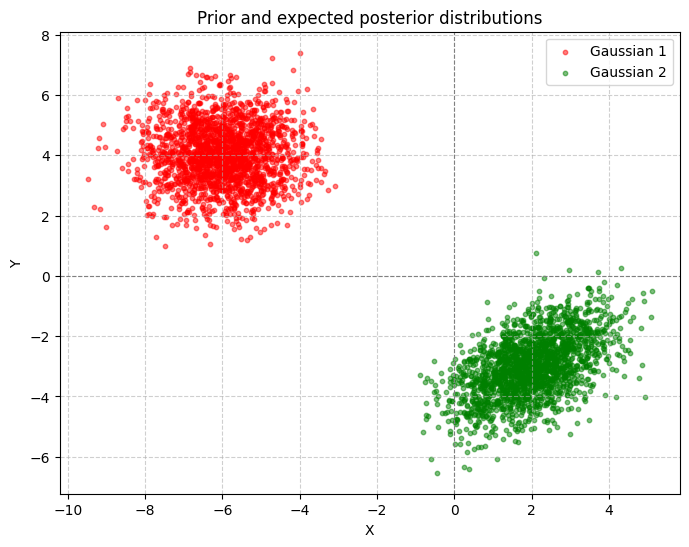

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

n_samples = 2000# Nombre d'échantillons

# Première distribution gaussienne
mu1 = np.array([-6, 4])
cov1 = np.array([[1, 0], [0, 1]])
data_gaussian1 = np.random.multivariate_normal(mu1, cov1, n_samples)
X_gaussian1 = data_gaussian1[:, 0]
Y_gaussian1 = data_gaussian1[:, 1]

# Deuxième distribution gaussienne
mu2 = np.array([2, -3])
cov2 = np.array([[1, 0.5], [0.5, 1]])
data_gaussian2 = np.random.multivariate_normal(mu2, cov2, n_samples)
X_gaussian2 = data_gaussian2[:, 0]
Y_gaussian2 = data_gaussian2[:, 1]

# Tracé des distributions
plt.figure(figsize=(8, 6))
plt.scatter(X_gaussian1, Y_gaussian1, alpha=0.5, s=10, color='red', label='Gaussian 1')
plt.scatter(X_gaussian2, Y_gaussian2, alpha=0.5, s=10, color='green', label='Gaussian 2')
plt.title("Prior and expected posterior distributions")
plt.xlabel("X")
plt.ylabel("Y")
plt.axhline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne horizontale
plt.axvline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne verticale
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()
plt.close()


In [ ]:
import torch
from torch.utils.data import DataLoader, TensorDataset
import os

# Conversion des données AVANT DataLoader pour éviter les répétitions inutiles
tensor_data_gaussian1 = torch.tensor(data_gaussian1, dtype=torch.float32)
tensor_data_gaussian2 = torch.tensor(data_gaussian2, dtype=torch.float32)

# Création des datasets
train_dataset = TensorDataset(tensor_data_gaussian1[:1600], tensor_data_gaussian2[:1600])
val_dataset = TensorDataset(tensor_data_gaussian1[1600:], tensor_data_gaussian2[1600:])

# Détection du nombre de workers
num_workers = min(4, os.cpu_count())  # Utilisation de 4 workers ou du max dispo

# Chargement optimisé des données
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)


### CascadeGradNet

In [ ]:
from geomloss import SamplesLoss
CRITERION = SamplesLoss("sinkhorn", p=2, blur=0.05, backend="tensorized")

NUM_EPOCHS = 500

NUM_LAYERS = 3
IN_DIM = 2
EMBED_DIM = 8
ACTIVATION = lambda : nn.Tanh()

model1 = CascadeGradNet(
    num_layers=NUM_LAYERS,
    in_dim=IN_DIM,
    embed_dim=EMBED_DIM,
    activation=ACTIVATION
).to(DEVICE)

train_model(model1, train_loader, val_loader, CRITERION, NUM_EPOCHS, DEVICE, model_name='CascadeGradNetGaussian')

Training CascadeGradNetGaussian:   4%|▍         | 20/500 [00:10<04:04,  1.96it/s]

Epoch 20/500 - Train Loss: 3.332385 - Val Loss: 3.187961


Training CascadeGradNetGaussian:   8%|▊         | 40/500 [00:20<03:56,  1.95it/s]

Epoch 40/500 - Train Loss: 1.242454 - Val Loss: 1.104477


Training CascadeGradNetGaussian:  12%|█▏        | 60/500 [00:30<03:47,  1.93it/s]

Epoch 60/500 - Train Loss: 0.594165 - Val Loss: 0.459447


Training CascadeGradNetGaussian:  16%|█▌        | 80/500 [00:41<03:33,  1.97it/s]

Epoch 80/500 - Train Loss: 0.341257 - Val Loss: 0.276800


Training CascadeGradNetGaussian:  20%|██        | 100/500 [00:51<03:25,  1.95it/s]

Epoch 100/500 - Train Loss: 0.288204 - Val Loss: 0.270068


Training CascadeGradNetGaussian:  24%|██▍       | 120/500 [01:01<03:18,  1.91it/s]

Epoch 120/500 - Train Loss: 0.301821 - Val Loss: 0.351821


Training CascadeGradNetGaussian:  28%|██▊       | 140/500 [01:12<03:14,  1.86it/s]

Epoch 140/500 - Train Loss: 0.382133 - Val Loss: 0.465494


Training CascadeGradNetGaussian:  32%|███▏      | 160/500 [01:22<02:50,  1.99it/s]

Epoch 160/500 - Train Loss: 0.455755 - Val Loss: 0.514567


Training CascadeGradNetGaussian:  36%|███▌      | 180/500 [01:32<02:50,  1.88it/s]

Epoch 180/500 - Train Loss: 0.395834 - Val Loss: 0.498933


Training CascadeGradNetGaussian:  40%|████      | 200/500 [01:43<02:34,  1.94it/s]

Epoch 200/500 - Train Loss: 0.318683 - Val Loss: 0.426968


Training CascadeGradNetGaussian:  44%|████▍     | 220/500 [01:53<02:25,  1.93it/s]

Epoch 220/500 - Train Loss: 0.251683 - Val Loss: 0.337993


Training CascadeGradNetGaussian:  48%|████▊     | 240/500 [02:03<02:13,  1.95it/s]

Epoch 240/500 - Train Loss: 0.196256 - Val Loss: 0.269167


Training CascadeGradNetGaussian:  52%|█████▏    | 260/500 [02:13<02:00,  2.00it/s]

Epoch 260/500 - Train Loss: 0.169298 - Val Loss: 0.231178


Training CascadeGradNetGaussian:  56%|█████▌    | 280/500 [02:24<01:56,  1.89it/s]

Epoch 280/500 - Train Loss: 0.157251 - Val Loss: 0.216540


Training CascadeGradNetGaussian:  60%|██████    | 300/500 [02:34<01:45,  1.89it/s]

Epoch 300/500 - Train Loss: 0.152968 - Val Loss: 0.200123


Training CascadeGradNetGaussian:  64%|██████▍   | 320/500 [02:45<01:32,  1.95it/s]

Epoch 320/500 - Train Loss: 0.140453 - Val Loss: 0.199560


Training CascadeGradNetGaussian:  68%|██████▊   | 340/500 [02:55<01:22,  1.93it/s]

Epoch 340/500 - Train Loss: 0.127163 - Val Loss: 0.193551


Training CascadeGradNetGaussian:  72%|███████▏  | 360/500 [03:05<01:12,  1.93it/s]

Epoch 360/500 - Train Loss: 0.142143 - Val Loss: 0.190505


Training CascadeGradNetGaussian:  76%|███████▌  | 380/500 [03:16<01:00,  1.97it/s]

Epoch 380/500 - Train Loss: 0.135685 - Val Loss: 0.181932


Training CascadeGradNetGaussian:  80%|████████  | 400/500 [03:26<00:51,  1.95it/s]

Epoch 400/500 - Train Loss: 0.132396 - Val Loss: 0.182630


Training CascadeGradNetGaussian:  84%|████████▍ | 420/500 [03:36<00:41,  1.94it/s]

Epoch 420/500 - Train Loss: 0.145903 - Val Loss: 0.179348


Training CascadeGradNetGaussian:  88%|████████▊ | 440/500 [03:46<00:31,  1.90it/s]

Epoch 440/500 - Train Loss: 0.133283 - Val Loss: 0.176964


Training CascadeGradNetGaussian:  92%|█████████▏| 460/500 [03:57<00:20,  1.93it/s]

Epoch 460/500 - Train Loss: 0.122729 - Val Loss: 0.175979


Training CascadeGradNetGaussian:  96%|█████████▌| 480/500 [04:07<00:10,  1.96it/s]

Epoch 480/500 - Train Loss: 0.122987 - Val Loss: 0.172060


Training CascadeGradNetGaussian: 100%|██████████| 500/500 [04:17<00:00,  1.94it/s]

Epoch 500/500 - Train Loss: 0.122861 - Val Loss: 0.168591


In [ ]:
import matplotlib.pyplot as plt

# Charger le modèle entraîné
model1.load_state_dict(torch.load("CascadeGradNetGaussian.pt"))
model1.eval()

# Générer un échantillon de la gaussienne source
source_samples = tensor_data_gaussian1[:1000].to(DEVICE)  # Prends 1000 points pour visualisation

# Passer par le modèle
with torch.no_grad():
    transported_samples = model1(source_samples).cpu().numpy()

# Récupérer les données originales pour comparer
source_samples = source_samples.cpu().numpy()
target_samples = tensor_data_gaussian2[:1000].cpu().numpy()  # Distribution cible


C:\Users\DAO.EZSPACE\AppData\Local\Temp\ipykernel_20344\2501981865.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load("CascadeGradNetGauss

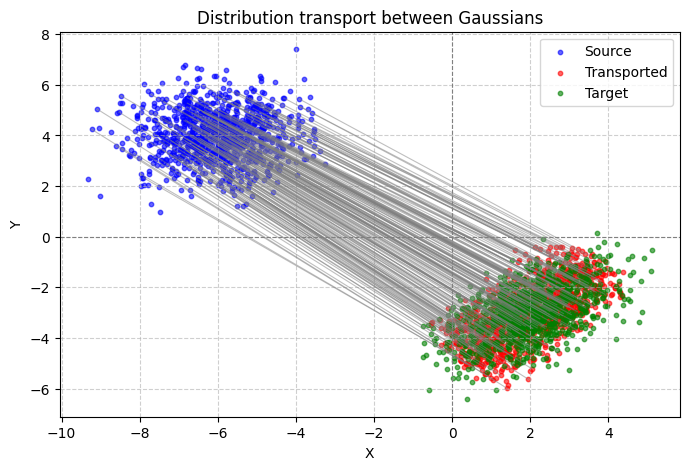

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Définir la proportion de points à relier (20% des points)
sampling_rate = 0.2  # 20% des points
num_points = len(source_samples)
num_sampled = max(1, int(sampling_rate * num_points))  # Au moins 1 point sélectionné

# Sélectionner aléatoirement les indices des points à connecter
sampled_indices = np.random.choice(num_points, num_sampled, replace=False)

plt.figure(figsize=(8, 5))

# Tracer les segments de transport (de source -> transporté) UNIQUEMENT pour les 20% sélectionnés
for i in sampled_indices:
    plt.plot([source_samples[i, 0], transported_samples[i, 0]], 
             [source_samples[i, 1], transported_samples[i, 1]], 
             color='gray', alpha=0.5, linewidth=0.8)  # Lignes grises semi-transparentes

# Source avant transport (en bleu)
plt.scatter(source_samples[:, 0], source_samples[:, 1], alpha=0.6, s=10, color='blue', label='Source')

# Source après transport par le modèle (en rouge)
plt.scatter(transported_samples[:, 0], transported_samples[:, 1], alpha=0.6, s=10, color='red', label='Transported')

# Distribution cible (en vert)
plt.scatter(target_samples[:, 0], target_samples[:, 1], alpha=0.6, s=10, color='green', label='Target')

plt.title("Distribution transport between Gaussians")
plt.xlabel("X")
plt.ylabel("Y")
plt.axhline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne horizontale
plt.axvline(0, color='gray', linestyle='--', linewidth=0.8)  # Ligne verticale
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)

plt.savefig("transport_gaussian012.pdf",dpi=300)
plt.show()


In [ ]:
from scipy.stats import wasserstein_distance

# Calculer la distance de Wasserstein pour chaque dimension séparément
wd_x = wasserstein_distance(transported_samples[:, 0], target_samples[:, 0])
wd_y = wasserstein_distance(transported_samples[:, 1], target_samples[:, 1])

# Distance moyenne entre les deux distributions
wasserstein_dist = (wd_x + wd_y) / 2

wasserstein_dist


0.12955092265610327

## MNIST Model

In [1]:
def train_mnist(model, train_loader, val_loader, CRITERION, NUM_EPOCHS, DEVICE, model_name='model'):
    optimizer = optim.Adam(model.parameters(), lr=3e-4)
    train_losses, val_losses = [], []
    best_val_loss = float('inf')

    for epoch in tqdm(range(NUM_EPOCHS), desc=f"Training {model_name}"):
        model.train()
        train_loss = 0

        for x, y in train_loader:
            x, y = x.to(DEVICE), y.to(DEVICE)
            outputs = model(x)
            loss = CRITERION(outputs, y)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        train_losses.append(train_loss / len(train_loader))

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for x, y in val_loader:
                x, y = x.to(DEVICE), y.to(DEVICE)
                outputs = model(x)
                loss = CRITERION(outputs, y)
                val_loss += loss.item()

        val_losses.append(val_loss / len(val_loader))

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), f"{model_name}.pt")

        if (epoch + 1) % 20 == 0:
            print(f"Epoch {epoch+1}/{NUM_EPOCHS} - Train Loss: {train_losses[-1]:.6f} - Val Loss: {val_losses[-1]:.6f}")

    return None

In [39]:
import torch
from torchvision.datasets import MNIST
from torchvision.transforms import ToTensor
from torch.utils.data import DataLoader
from models import CascadeGradNetImage
from geomloss import SamplesLoss
from tqdm import tqdm

from torch import nn, optim

mnist_train = MNIST(root="data", train=True, download=True, transform=ToTensor())
mnist_val = MNIST(root="data", train=False, download=True, transform=ToTensor())


DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


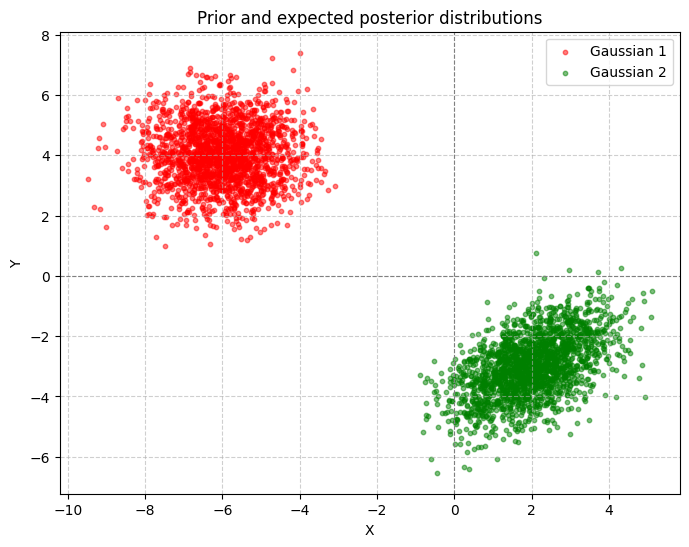

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

n_samples = 2000# Nombre d'échantillons

# Première distribution gaussienne
mu1 = np.array([-6, 4])
cov1 = np.array([[1, 0], [0, 1]])
data_gaussian1 = np.random.multivariate_normal(mu1, cov1, n_samples)
X_gaussian1 = data_gaussian1[:, 0]
Y_gaussian1 = data_gaussian1[:, 1]




In [ ]:
import torch
from torch.utils.data import DataLoader, TensorDataset
import os

# Conversion des données AVANT DataLoader pour éviter les répétitions inutiles
tensor_data_gaussian1 = torch.tensor(data_gaussian1, dtype=torch.float32)
tensor_data_gaussian2 = torch.tensor(data_gaussian2, dtype=torch.float32)

# Création des datasets
train_dataset = TensorDataset(tensor_data_gaussian1[:1600], tensor_data_gaussian2[:1600])
val_dataset = TensorDataset(tensor_data_gaussian1[1600:], tensor_data_gaussian2[1600:])

# Détection du nombre de workers
num_workers = min(4, os.cpu_count())  # Utilisation de 4 workers ou du max dispo

# Chargement optimisé des données
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)


In [11]:
num_layers = 3
in_channels = 1
out_channels = 10

activation = lambda : nn.Tanh()

CRITERION = SamplesLoss("sinkhorn", p=2, blur=0.05, backend="tensorized")

model_mnist1 = CascadeGradNetImage(
    num_layers=num_layers,
    in_channels=in_channels,
    activation=activation,
    embed_dim=16,
    image_size=28
).to(DEVICE)

def train_mnist_fixed(model, train_loader, val_loader, CRITERION, NUM_EPOCHS, DEVICE, model_name='model'):
    optimizer = optim.Adam(model.parameters(), lr=3e-4)
    train_losses, val_losses = [], []
    best_val_loss = float('inf')

    for epoch in tqdm(range(NUM_EPOCHS), desc=f"Training {model_name}"):
        model.train()
        train_loss = 0

        for x, y in train_loader:
            x, y = x.to(DEVICE), y.to(DEVICE)
            outputs = model(x)
            
            
            # Reshape outputs and y to match the expected shape for SamplesLoss
            outputs = outputs.view(outputs.size(0), -1)  # Flatten outputs to (N, D)
            y = y.view(y.size(0), -1)  # Flatten y to (N, D)

            print(outputs.shape, y.shape)
            
            loss = CRITERION(outputs, y)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        train_losses.append(train_loss / len(train_loader))

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for x, y in val_loader:
                x, y = x.to(DEVICE), y.to(DEVICE)
                outputs = model(x)
                
                # Reshape outputs and y to match the expected shape for SamplesLoss
                outputs = outputs.view(outputs.size(0), -1)  # Flatten outputs to (N, D)
                y = y.view(y.size(0), -1)  # Flatten y to (N, D)

                loss = CRITERION(outputs, y)
                val_loss += loss.item()

        val_losses.append(val_loss / len(val_loader))

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), f"{model_name}.pt")

        if (epoch + 1) % 20 == 0:
            print(f"Epoch {epoch+1}/{NUM_EPOCHS} - Train Loss: {train_losses[-1]:.6f} - Val Loss: {val_losses[-1]:.6f}")

    return None

train_mnist_fixed(model_mnist1, train_loader, val_loader, CRITERION, 10, DEVICE, model_name='ConvCascadeGradNet')

Training ConvCascadeGradNet:   0%|          | 0/10 [00:00<?, ?it/s]

torch.Size([64, 784]) torch.Size([64, 1])


ValueError: Input samples 'x' and 'y' should have the same last dimension.

In [11]:
num_layers = 3
in_channels = 1
out_channels = 16
kernel_size = 3
activation = lambda: nn.Tanh()

model = ConvCascadeGradNet(num_layers, in_channels, out_channels, kernel_size, activation).to("cuda")

x = torch.randn(1, 1, 28, 28).to("cuda")
output = model(x)

print("Taille de sortie :", output.shape)  # Devrait être (1, 1, 28, 28)


RuntimeError: Given transposed=1, weight of size [1, 16, 3, 3], expected input[1, 16, 28, 28] to have 1 channels, but got 16 channels instead

Epoch 1/60, Loss: 357.824782


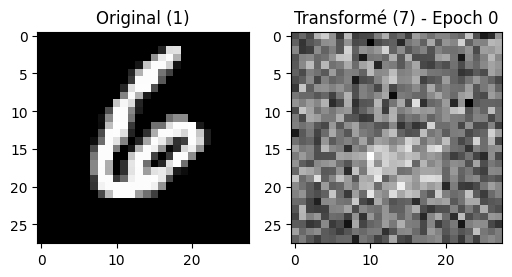

Epoch 2/60, Loss: 352.344799
Epoch 3/60, Loss: 342.879432
Epoch 4/60, Loss: 329.889068
Epoch 5/60, Loss: 314.679836
Epoch 6/60, Loss: 298.478159


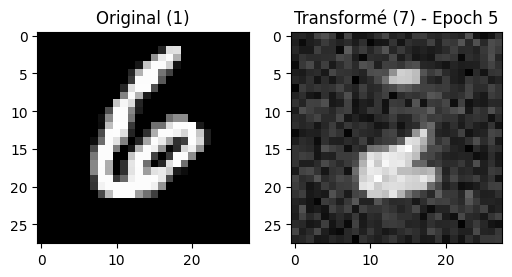

Epoch 7/60, Loss: 282.192710
Epoch 8/60, Loss: 266.336313
Epoch 9/60, Loss: 251.320482
Epoch 10/60, Loss: 237.120283
Epoch 11/60, Loss: 223.894406


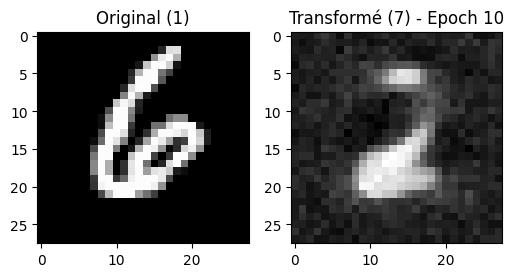

Epoch 12/60, Loss: 211.591333
Epoch 13/60, Loss: 200.169553
Epoch 14/60, Loss: 189.556536
Epoch 15/60, Loss: 179.908749
Epoch 16/60, Loss: 171.074440


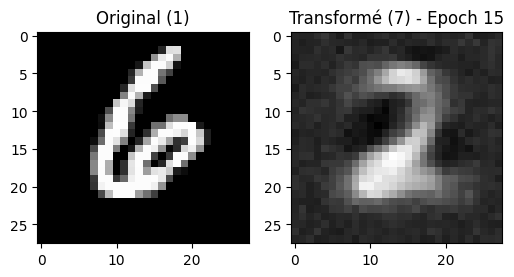

Epoch 17/60, Loss: 162.823984
Epoch 18/60, Loss: 155.271804
Epoch 19/60, Loss: 148.317856
Epoch 20/60, Loss: 141.980600
Epoch 21/60, Loss: 136.355538


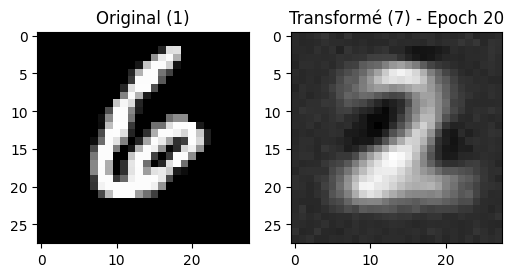

Epoch 22/60, Loss: 131.134135
Epoch 23/60, Loss: 126.226713
Epoch 24/60, Loss: 122.067937
Epoch 25/60, Loss: 118.242464
Epoch 26/60, Loss: 114.688304


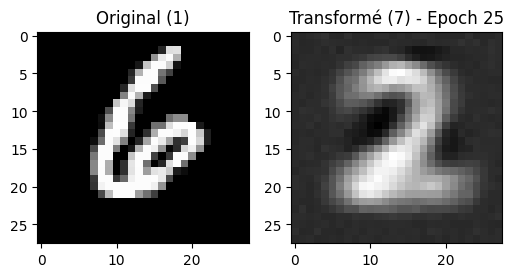

Epoch 27/60, Loss: 111.669649
Epoch 28/60, Loss: 108.854259
Epoch 29/60, Loss: 106.549755
Epoch 30/60, Loss: 104.253901
Epoch 31/60, Loss: 102.165160


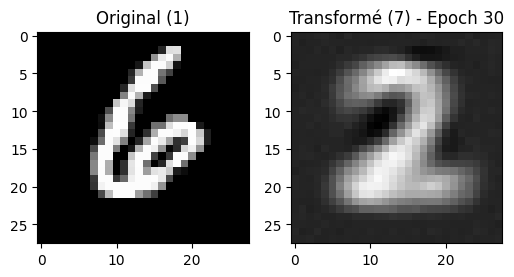

Epoch 32/60, Loss: 100.667729
Epoch 33/60, Loss: 99.022932
Epoch 34/60, Loss: 97.635836
Epoch 35/60, Loss: 96.443937
Epoch 36/60, Loss: 95.451603


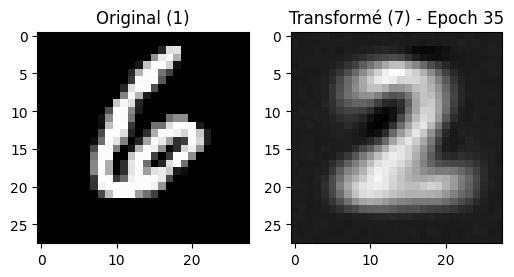

Epoch 37/60, Loss: 94.392886
Epoch 38/60, Loss: 93.563239
Epoch 39/60, Loss: 92.996643
Epoch 40/60, Loss: 92.376263
Epoch 41/60, Loss: 91.688409


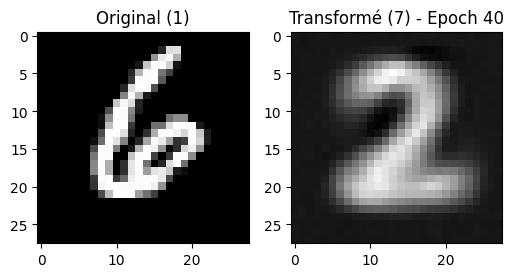

Epoch 42/60, Loss: 91.186478
Epoch 43/60, Loss: 90.791193
Epoch 44/60, Loss: 90.495680
Epoch 45/60, Loss: 90.115854
Epoch 46/60, Loss: 89.636029


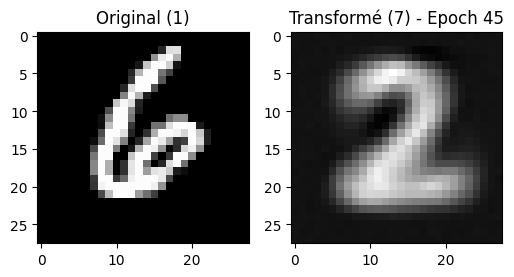

Epoch 47/60, Loss: 89.340656
Epoch 48/60, Loss: 89.202998
Epoch 49/60, Loss: 88.785704
Epoch 50/60, Loss: 88.512392
Epoch 51/60, Loss: 88.271520


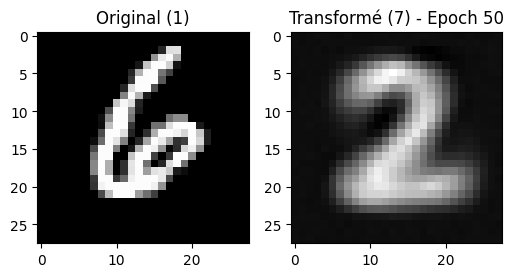

Epoch 52/60, Loss: 88.079913
Epoch 53/60, Loss: 87.929994
Epoch 54/60, Loss: 87.770417
Epoch 55/60, Loss: 87.492233
Epoch 56/60, Loss: 87.144375


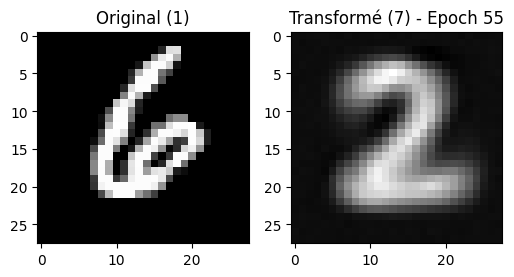

Epoch 57/60, Loss: 87.135617
Epoch 58/60, Loss: 86.813362
Epoch 59/60, Loss: 86.606461
Epoch 60/60, Loss: 86.532653


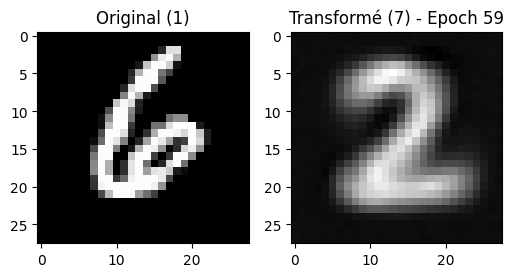

In [43]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision import datasets, transforms
import matplotlib.pyplot as plt

# Fonction d'initialisation des poids et biais
def init_W(out_dim, in_dim):
    return torch.randn(out_dim, in_dim) * 0.01

def init_b(out_dim, in_dim):
    return torch.zeros(out_dim)

# Définition du modèle CascadeGradNet
class CascadeGradNet(nn.Module): 
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()

        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for i in range(num_layers)])

        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(init_b(embed_dim, embed_dim), requires_grad=True) for i in range(num_layers+1)])
        self.bias[0] = nn.Parameter(init_b(embed_dim, in_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(init_b(in_dim, embed_dim), requires_grad=True)

        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for i in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for i in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1,-1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i+1].view(1,-1) * F.linear(x, self.W, self.bias[i+1])
            z = skip + self.alpha[i].view(1,-1) * self.nonlinearity[i](z)

        z = self.alpha[-1].view(1,-1) * self.nonlinearity[-1](z)  # Correction
        z = F.linear(z, self.W.T, self.bias[-1])

        return z

# Charger MNIST et préparer les données
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

mnist_train = datasets.MNIST(root='./data', train=True, download=True, transform=transform)

# Sélectionner deux classes spécifiques (ex: 1 et 7)
class_1, class_2 = 6, 2
X_data, Y_data = [], []

for img, label in mnist_train:
    img_flat = img.view(-1)  # Transformer en vecteur 784
    if label == class_1:
        X_data.append(img_flat)
    elif label == class_2:
        Y_data.append(img_flat)

# Convertir en tenseurs
X_data = torch.stack(X_data)
Y_data = torch.stack(Y_data)

# Équilibrer les tailles pour éviter l'erreur de mismatch
min_size = min(len(X_data), len(Y_data))
X_data = X_data[:min_size]
Y_data = Y_data[:min_size]

# Initialisation du modèle
input_dim = 28*28  # Taille de l'image (784)
embed_dim = 512     # Taille de l'espace intermédiaire
num_layers = 3      # Nombre de couches

model = CascadeGradNet(num_layers, input_dim, embed_dim, activation=nn.Tanh)

# Optimisation et perte
optimizer = optim.Adam(model.parameters(), lr=1e-5)
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.05, backend="tensorized")

# Fonction pour afficher la transformation en cours
def show_progress(original, transformed, epoch):
    fig, axes = plt.subplots(1, 2, figsize=(6, 3))
    axes[0].imshow(original.view(28, 28).detach().cpu().numpy(), cmap='gray')
    axes[0].set_title('Original (1)')
    axes[1].imshow(transformed.view(28, 28).detach().cpu().numpy(), cmap='gray')
    axes[1].set_title(f'Transformé (7) - Epoch {epoch}')
    plt.show()

# Entraînement
num_epochs = 60 # Plus d'époques pour mieux voir l'évolution
batch_size = 128

dataset = torch.utils.data.TensorDataset(X_data, Y_data)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

test_sample = X_data[0].unsqueeze(0)  # Prendre un exemple fixe pour le suivi

for epoch in range(num_epochs):
    total_loss = 0
    for x_batch, y_batch in dataloader:
        optimizer.zero_grad()
        g_x = model(x_batch)
        loss = loss_fn(g_x, y_batch)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    
    print(f'Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(dataloader):.6f}')

    # Affichage de la transformation toutes les 5 époques
    if epoch % 5 == 0 or epoch == num_epochs - 1:
        transformed_sample = model(test_sample)
        show_progress(test_sample, transformed_sample, epoch)


In [27]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import wasserstein_distance  # Pour la distance de Wasserstein


In [31]:
# Appliquer la transformation aux "1"
X_transformed = model(X_data).detach().cpu().numpy()
Y_original = Y_data.detach().cpu().numpy()  # Distribution réelle des "7"


In [32]:
# Calculer la distance de Wasserstein pixel par pixel
wasserstein_distances = [
    wasserstein_distance(X_transformed[:, i], Y_original[:, i])
    for i in range(X_transformed.shape[1])
]

# Moyenne des distances sur tous les pixels
wasserstein_score = np.mean(wasserstein_distances)

print(f"Distance de Wasserstein moyenne entre les distributions des '1' transformés et des '7' : {wasserstein_score:.4f}")


Distance de Wasserstein moyenne entre les distributions des '1' transformés et des '7' : 0.2247


Distance de Wasserstein moyenne entre les distributions des '1' transformés et des '7' : 0.2643


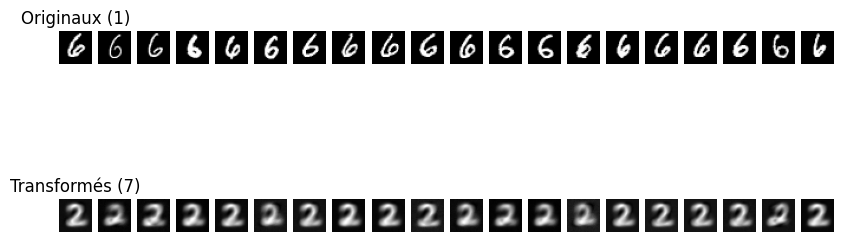

In [44]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import wasserstein_distance

# Appliquer la transformation aux 20 premiers chiffres "1"
num_samples = 20
X_samples = X_data[:num_samples]  # Prendre 20 "1"
X_transformed = model(X_samples).detach().cpu().numpy()
Y_original = Y_data[:num_samples].detach().cpu().numpy()  # Prendre 20 "7"

# Calculer la distance de Wasserstein pixel par pixel
wasserstein_distances = [
    wasserstein_distance(X_transformed[:, i], Y_original[:, i])
    for i in range(X_transformed.shape[1])
]

# Moyenne des distances sur tous les pixels
wasserstein_score = np.mean(wasserstein_distances)

print(f"Distance de Wasserstein moyenne entre les distributions des '1' transformés et des '7' : {wasserstein_score:.4f}")

# Affichage sous forme de grille
def show_grid(originals, transformed, rows=4, cols=5):
    fig, axes = plt.subplots(2, rows * cols, figsize=(cols * 2, 4))
    
    for i in range(rows * cols):
        if i < num_samples:
            # Image originale "1"
            axes[0, i].imshow(originals[i].reshape(28, 28), cmap="gray")
            axes[0, i].axis("off")

            # Image transformée vers "7"
            axes[1, i].imshow(transformed[i].reshape(28, 28), cmap="gray")
            axes[1, i].axis("off")

    axes[0, 0].set_title("Originaux (1)")
    axes[1, 0].set_title("Transformés (7)")

    plt.show()

# Afficher les images originales et transformées
show_grid(X_samples.detach().cpu().numpy(), X_transformed)



Distance de Wasserstein moyenne entre les distributions bruitées et des '7' : 0.9518


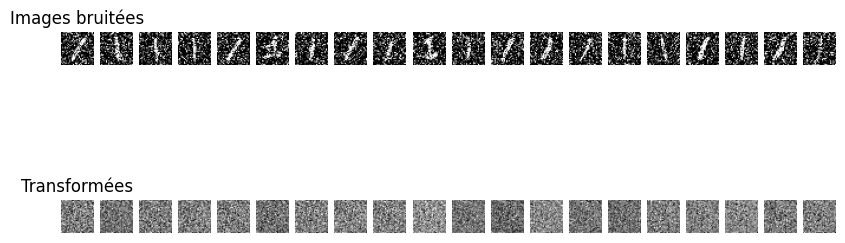

Epoch 1/60, Train Loss: 359.584290, Val Loss: 358.567902


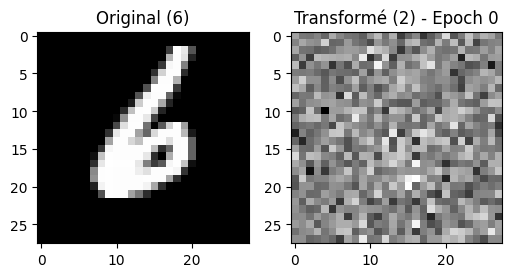

Epoch 2/60, Train Loss: 358.873842, Val Loss: 357.699695
Epoch 3/60, Train Loss: 357.824540, Val Loss: 356.447720
Epoch 4/60, Train Loss: 356.395300, Val Loss: 354.834073
Epoch 5/60, Train Loss: 354.637975, Val Loss: 352.931052
Epoch 6/60, Train Loss: 352.629454, Val Loss: 350.815671


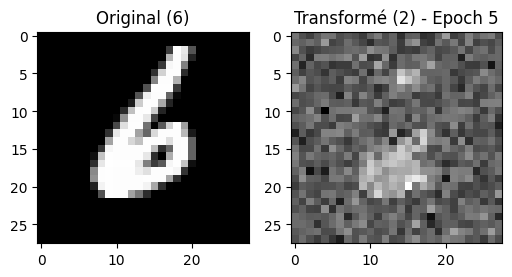

Epoch 7/60, Train Loss: 350.441910, Val Loss: 348.554755
Epoch 8/60, Train Loss: 348.136533, Val Loss: 346.200842
Epoch 9/60, Train Loss: 345.756955, Val Loss: 343.792255
Epoch 10/60, Train Loss: 343.335638, Val Loss: 341.356247
Epoch 11/60, Train Loss: 340.896685, Val Loss: 338.908408


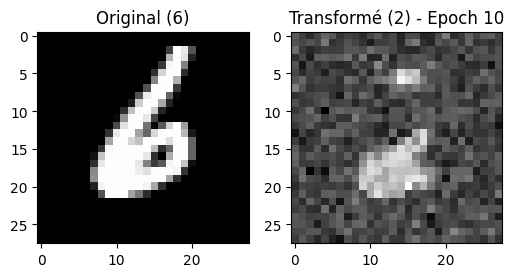

Epoch 12/60, Train Loss: 338.452670, Val Loss: 336.463303
Epoch 13/60, Train Loss: 336.013465, Val Loss: 334.030444
Epoch 14/60, Train Loss: 333.591077, Val Loss: 331.611292
Epoch 15/60, Train Loss: 331.184028, Val Loss: 329.209747
Epoch 16/60, Train Loss: 328.793935, Val Loss: 326.828271


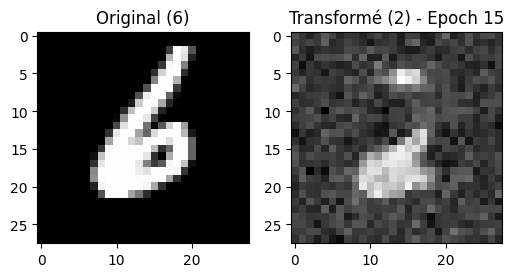

Epoch 17/60, Train Loss: 326.427488, Val Loss: 324.468112
Epoch 18/60, Train Loss: 324.079531, Val Loss: 322.127069
Epoch 19/60, Train Loss: 321.750526, Val Loss: 319.805899
Epoch 20/60, Train Loss: 319.446392, Val Loss: 317.504443
Epoch 21/60, Train Loss: 317.158089, Val Loss: 315.223120


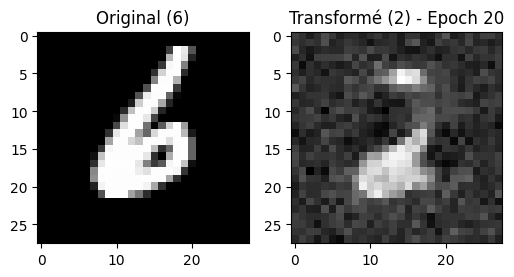

Epoch 22/60, Train Loss: 314.890261, Val Loss: 312.962387
Epoch 23/60, Train Loss: 312.643338, Val Loss: 310.720413
Epoch 24/60, Train Loss: 310.412913, Val Loss: 308.496512
Epoch 25/60, Train Loss: 308.206654, Val Loss: 306.292117
Epoch 26/60, Train Loss: 306.014391, Val Loss: 304.103412


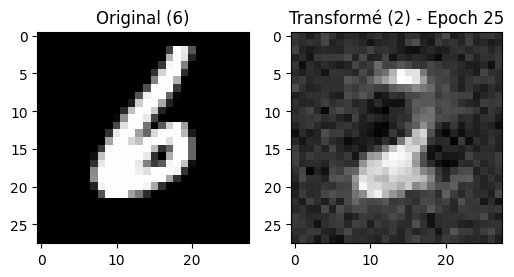

Epoch 27/60, Train Loss: 303.839647, Val Loss: 301.931564
Epoch 28/60, Train Loss: 301.681661, Val Loss: 299.780103
Epoch 29/60, Train Loss: 299.545419, Val Loss: 297.645084
Epoch 30/60, Train Loss: 297.427180, Val Loss: 295.526917
Epoch 31/60, Train Loss: 295.320142, Val Loss: 293.433603


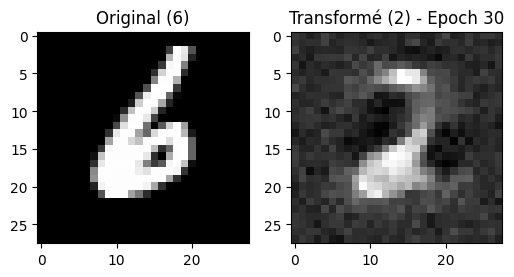

Epoch 32/60, Train Loss: 293.237265, Val Loss: 291.344388
Epoch 33/60, Train Loss: 291.167269, Val Loss: 289.286243
Epoch 34/60, Train Loss: 289.117283, Val Loss: 287.236502
Epoch 35/60, Train Loss: 287.084063, Val Loss: 285.204056
Epoch 36/60, Train Loss: 285.066730, Val Loss: 283.193985


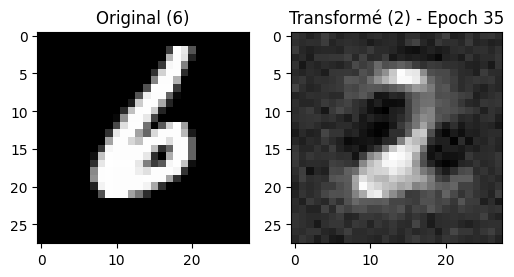

Epoch 37/60, Train Loss: 283.067829, Val Loss: 281.194687
Epoch 38/60, Train Loss: 281.083527, Val Loss: 279.214951
Epoch 39/60, Train Loss: 279.117658, Val Loss: 277.243604
Epoch 40/60, Train Loss: 277.163151, Val Loss: 275.302451
Epoch 41/60, Train Loss: 275.226555, Val Loss: 273.371133


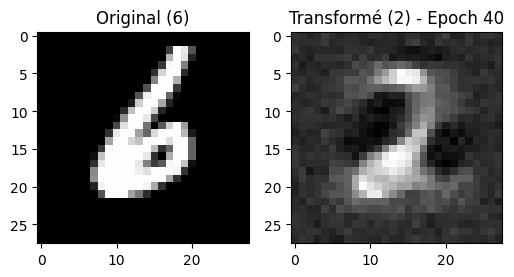

Epoch 42/60, Train Loss: 273.314417, Val Loss: 271.449405
Epoch 43/60, Train Loss: 271.410587, Val Loss: 269.551089
Epoch 44/60, Train Loss: 269.517240, Val Loss: 267.664175
Epoch 45/60, Train Loss: 267.645481, Val Loss: 265.796567
Epoch 46/60, Train Loss: 265.799169, Val Loss: 263.940820


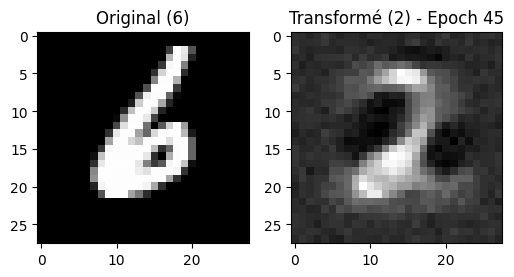

Epoch 47/60, Train Loss: 263.948503, Val Loss: 262.105484
Epoch 48/60, Train Loss: 262.124398, Val Loss: 260.273264
Epoch 49/60, Train Loss: 260.306739, Val Loss: 258.470380
Epoch 50/60, Train Loss: 258.517521, Val Loss: 256.669810
Epoch 51/60, Train Loss: 256.730861, Val Loss: 254.893365


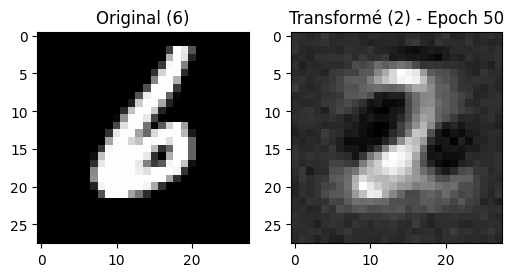

Epoch 52/60, Train Loss: 254.954946, Val Loss: 253.121748
Epoch 53/60, Train Loss: 253.200954, Val Loss: 251.362738
Epoch 54/60, Train Loss: 251.450437, Val Loss: 249.631148
Epoch 55/60, Train Loss: 249.738101, Val Loss: 247.907179
Epoch 56/60, Train Loss: 248.009082, Val Loss: 246.196297


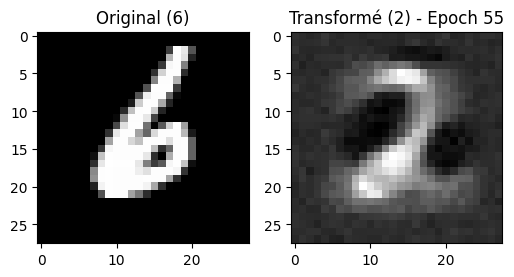

Epoch 57/60, Train Loss: 246.315674, Val Loss: 244.489049
Epoch 58/60, Train Loss: 244.629240, Val Loss: 242.792603
Epoch 59/60, Train Loss: 242.939967, Val Loss: 241.138940
Epoch 60/60, Train Loss: 241.291929, Val Loss: 239.475371


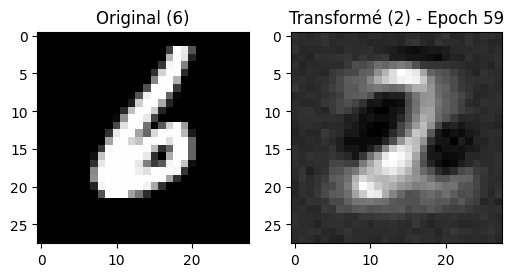

In [53]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
import numpy as np
from geomloss import SamplesLoss  # Pour la loss Sinkhorn

# Fonction d'initialisation des poids et biais
def init_W(out_dim, in_dim):
    return torch.randn(out_dim, in_dim) * 0.01

def init_b(out_dim, in_dim):
    return torch.zeros(out_dim)

# Définition du modèle CascadeGradNet
class CascadeGradNet(nn.Module): 
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()

        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])

        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(init_b(embed_dim, embed_dim), requires_grad=True) for _ in range(num_layers+1)])
        self.bias[0] = nn.Parameter(init_b(embed_dim, in_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(init_b(in_dim, embed_dim), requires_grad=True)

        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1,-1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i+1].view(1,-1) * F.linear(x, self.W, self.bias[i+1])
            z = skip + self.alpha[i].view(1,-1) * self.nonlinearity[i](z)

        z = self.alpha[-1].view(1,-1) * self.nonlinearity[-1](z)
        z = F.linear(z, self.W.T, self.bias[-1])

        return z

# Charger MNIST et préparer les données
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

mnist_train = datasets.MNIST(root='./data', train=True, download=True, transform=transform)

# Sélectionner les classes 6 et 2
class_1, class_2 = 6, 2
X_data, Y_data = [], []

for img, label in mnist_train:
    img_flat = img.view(-1)  # Transformer en vecteur 784
    if label == class_1:
        X_data.append(img_flat)
    elif label == class_2:
        Y_data.append(img_flat)

# Convertir en tenseurs et équilibrer
X_data = torch.stack(X_data)
Y_data = torch.stack(Y_data)
min_size = min(len(X_data), len(Y_data))
X_data = X_data[:min_size]
Y_data = Y_data[:min_size]

# Diviser en train / validation (80% train, 20% validation)
train_size = int(0.8 * min_size)
X_train, X_val = X_data[:train_size], X_data[train_size:]
Y_train, Y_val = Y_data[:train_size], Y_data[train_size:]

# Initialisation du modèle
input_dim = 28*28
embed_dim = 56
num_layers = 2
model = CascadeGradNet(num_layers, input_dim, embed_dim, activation=nn.Tanh)

# Optimisation et perte Sinkhorn
optimizer = optim.Adam(model.parameters(), lr=1e-5)
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.05, backend="tensorized")

# Fonction pour afficher la transformation en cours
def show_progress(original, transformed, epoch):
    fig, axes = plt.subplots(1, 2, figsize=(6, 3))
    axes[0].imshow(original.view(28, 28).detach().cpu().numpy(), cmap='gray')
    axes[0].set_title('Original (6)')
    axes[1].imshow(transformed.view(28, 28).detach().cpu().numpy(), cmap='gray')
    axes[1].set_title(f'Transformé (2) - Epoch {epoch}')
    plt.show()

# Entraînement
num_epochs = 60
batch_size = 128

train_dataset = torch.utils.data.TensorDataset(X_train, Y_train)
val_dataset = torch.utils.data.TensorDataset(X_val, Y_val)

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

test_sample = X_val[0].unsqueeze(0)  # Exemple de validation pour affichage

for epoch in range(num_epochs):
    model.train()
    total_train_loss = 0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        g_x = model(x_batch)
        loss = loss_fn(g_x, y_batch)
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item()
    
    # Évaluation sur le dataset de validation
    model.eval()
    total_val_loss = 0
    with torch.no_grad():
        for x_batch, y_batch in val_loader:
            g_x = model(x_batch)
            loss = loss_fn(g_x, y_batch)
            total_val_loss += loss.item()

    # Affichage des pertes
    print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {total_train_loss/len(train_loader):.6f}, Val Loss: {total_val_loss/len(val_loader):.6f}')

    # Affichage de la transformation toutes les 5 époques
    if epoch % 5 == 0 or epoch == num_epochs - 1:
        transformed_sample = model(test_sample)
        show_progress(test_sample, transformed_sample, epoch)


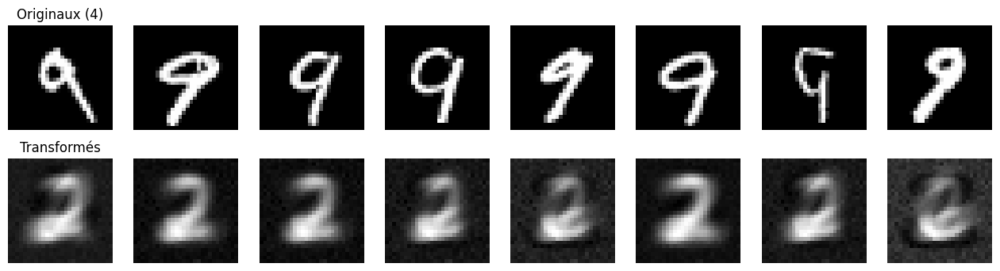

In [51]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision import datasets, transforms

# Charger MNIST et extraire uniquement les images de "4"
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

mnist_train = datasets.MNIST(root='./data', train=False, download=True, transform=transform)

# Sélectionner uniquement 8 images de "4"
X_data = []
for img, label in mnist_train:
    if label == 9:
        X_data.append(img.view(-1))  # Transformer en vecteur 784
    if len(X_data) >= 8:
        break  # Stopper après avoir trouvé 8 images

X_data = torch.stack(X_data)  # Convertir en tenseur

model.eval()  # Mode évaluation

# Appliquer la transformation aux "4"
X_transformed = model(X_data).detach().cpu()

# Fonction pour afficher la grille des transformations
def show_grid(originals, transformed):
    fig, axes = plt.subplots(2, len(originals), figsize=(len(originals) * 2, 4))
    
    for i in range(len(originals)):
        axes[0, i].imshow(originals[i].reshape(28, 28), cmap="gray")
        axes[0, i].axis("off")
        axes[1, i].imshow(transformed[i].reshape(28, 28), cmap="gray")
        axes[1, i].axis("off")

    axes[0, 0].set_title("Originaux (4)")
    axes[1, 0].set_title("Transformés")

    plt.show()

# Afficher la grille des transformations
show_grid(X_data, X_transformed)


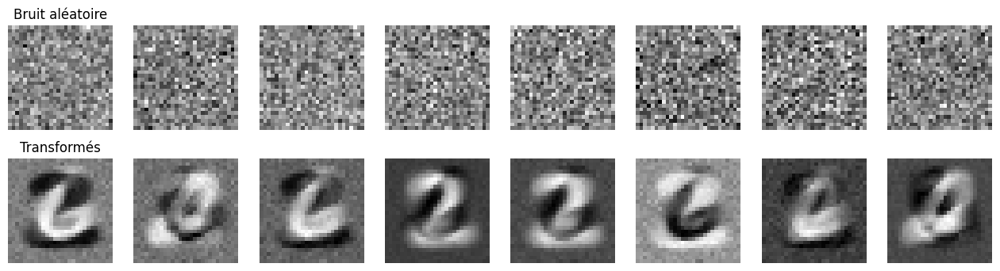

In [50]:
# Générer du bruit aléatoire 28x28
num_samples = 8  # Nombre d'images de bruit
noise_data = torch.randn(num_samples, 28 * 28)  # Bruit aléatoire de même dimension que MNIST

# Appliquer le modèle sur le bruit
noise_transformed = model(noise_data).detach().cpu()

# Fonction pour afficher la grille des transformations
def show_grid(originals, transformed):
    fig, axes = plt.subplots(2, len(originals), figsize=(len(originals) * 2, 4))
    
    for i in range(len(originals)):
        axes[0, i].imshow(originals[i].reshape(28, 28), cmap="gray")
        axes[0, i].axis("off")
        axes[1, i].imshow(transformed[i].reshape(28, 28), cmap="gray")
        axes[1, i].axis("off")

    axes[0, 0].set_title("Bruit aléatoire")
    axes[1, 0].set_title("Transformés")

    plt.show()

# Afficher la grille des transformations sur le bruit
show_grid(noise_data, noise_transformed)


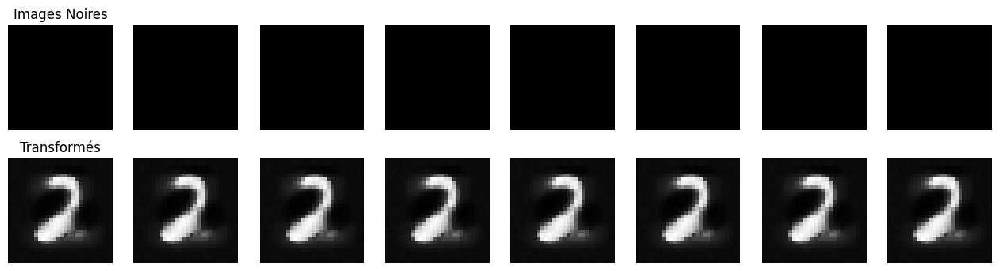

In [54]:
# Générer une image complètement noire (28x28)
num_samples = 8  # Nombre d'images
black_images = torch.zeros((num_samples, 28 * 28))  # Images entièrement noires

# Appliquer le modèle sur ces images noires
black_transformed = model(black_images).detach().cpu()

# Fonction pour afficher la grille des transformations
def show_grid(originals, transformed):
    fig, axes = plt.subplots(2, len(originals), figsize=(len(originals) * 2, 4))
    
    for i in range(len(originals)):
        axes[0, i].imshow(originals[i].reshape(28, 28), cmap="gray")
        axes[0, i].axis("off")
        axes[1, i].imshow(transformed[i].reshape(28, 28), cmap="gray")
        axes[1, i].axis("off")

    axes[0, 0].set_title("Images Noires")
    axes[1, 0].set_title("Transformés")

    plt.show()

# Afficher la grille des transformations sur les images noires
show_grid(black_images, black_transformed)


Epoch 1/50, Train Loss: 356.033529, Val Loss: 354.847862


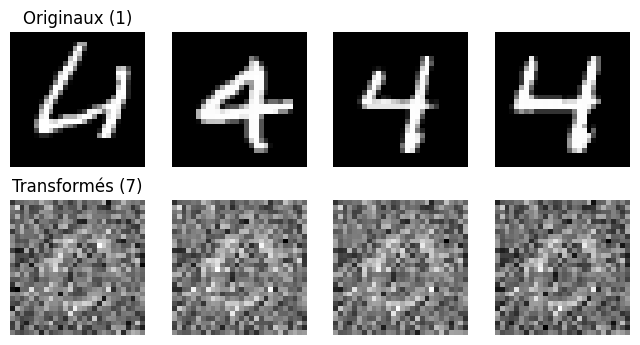

Epoch 2/50, Train Loss: 353.097201, Val Loss: 350.767204
Epoch 3/50, Train Loss: 347.990504, Val Loss: 344.700218
Epoch 4/50, Train Loss: 341.225267, Val Loss: 337.401360
Epoch 5/50, Train Loss: 333.618192, Val Loss: 329.597366
Epoch 6/50, Train Loss: 325.593027, Val Loss: 321.682243
Epoch 7/50, Train Loss: 317.532614, Val Loss: 313.786560
Epoch 8/50, Train Loss: 309.524118, Val Loss: 305.967468
Epoch 9/50, Train Loss: 301.669882, Val Loss: 298.281265
Epoch 10/50, Train Loss: 293.939986, Val Loss: 290.821960
Epoch 11/50, Train Loss: 286.348621, Val Loss: 283.550667


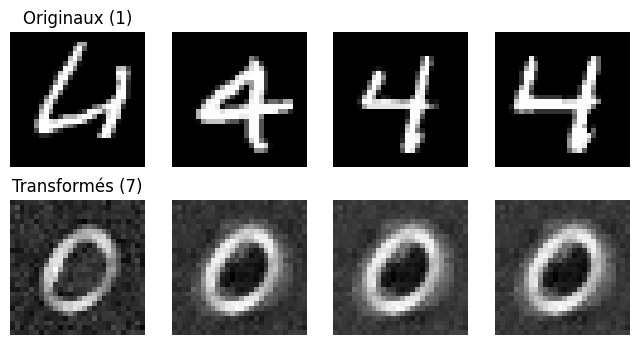

Epoch 12/50, Train Loss: 278.996289, Val Loss: 276.491547
Epoch 13/50, Train Loss: 271.929103, Val Loss: 269.748169
Epoch 14/50, Train Loss: 265.063958, Val Loss: 263.009735
Epoch 15/50, Train Loss: 258.315214, Val Loss: 256.682404
Epoch 16/50, Train Loss: 251.887492, Val Loss: 250.410164
Epoch 17/50, Train Loss: 245.710349, Val Loss: 244.421597
Epoch 18/50, Train Loss: 239.597115, Val Loss: 238.664803
Epoch 19/50, Train Loss: 233.869308, Val Loss: 232.890270
Epoch 20/50, Train Loss: 228.265121, Val Loss: 227.488819
Epoch 21/50, Train Loss: 222.764657, Val Loss: 222.144020


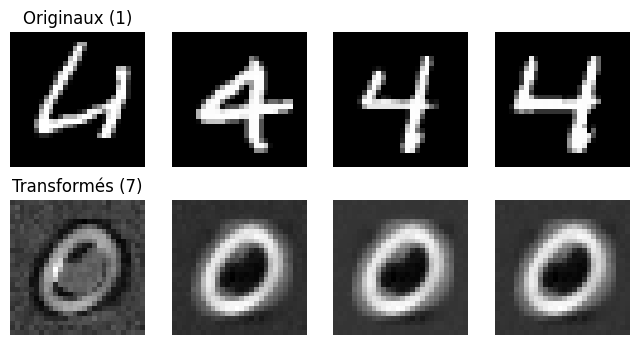

Epoch 22/50, Train Loss: 217.437658, Val Loss: 216.980061
Epoch 23/50, Train Loss: 212.262553, Val Loss: 211.880806
Epoch 24/50, Train Loss: 207.121199, Val Loss: 206.991367
Epoch 25/50, Train Loss: 202.223696, Val Loss: 202.180462
Epoch 26/50, Train Loss: 197.405608, Val Loss: 197.442196
Epoch 27/50, Train Loss: 192.932358, Val Loss: 192.951889
Epoch 28/50, Train Loss: 188.002478, Val Loss: 188.099110
Epoch 29/50, Train Loss: 183.670829, Val Loss: 183.744720
Epoch 30/50, Train Loss: 178.841992, Val Loss: 179.105186
Epoch 31/50, Train Loss: 174.624978, Val Loss: 174.770676


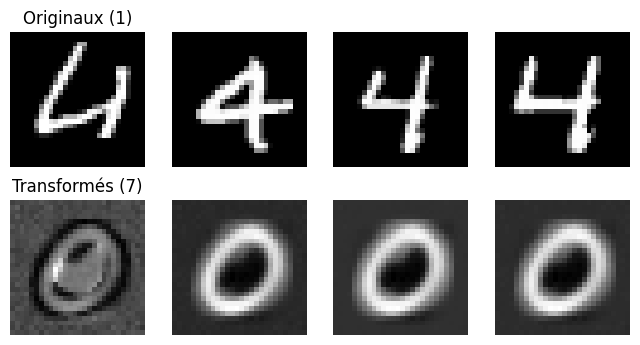

Epoch 32/50, Train Loss: 170.199454, Val Loss: 170.473061
Epoch 33/50, Train Loss: 165.741623, Val Loss: 166.205769
Epoch 34/50, Train Loss: 161.695300, Val Loss: 162.463573
Epoch 35/50, Train Loss: 157.997422, Val Loss: 158.525219
Epoch 36/50, Train Loss: 154.260147, Val Loss: 154.759163
Epoch 37/50, Train Loss: 150.416215, Val Loss: 151.591694
Epoch 38/50, Train Loss: 147.610502, Val Loss: 148.417332
Epoch 39/50, Train Loss: 144.267287, Val Loss: 145.269615
Epoch 40/50, Train Loss: 141.689583, Val Loss: 142.705784
Epoch 41/50, Train Loss: 138.846148, Val Loss: 139.621613


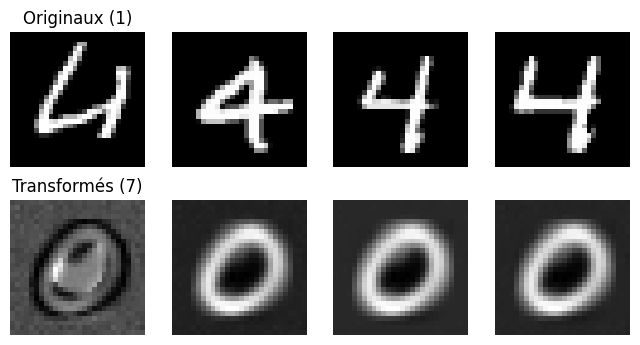

Epoch 42/50, Train Loss: 135.960345, Val Loss: 137.326693
Epoch 43/50, Train Loss: 133.465107, Val Loss: 134.793869
Epoch 44/50, Train Loss: 130.999174, Val Loss: 132.336555
Epoch 45/50, Train Loss: 128.689642, Val Loss: 130.419437
Epoch 46/50, Train Loss: 126.302466, Val Loss: 127.908367
Epoch 47/50, Train Loss: 124.528901, Val Loss: 126.214577
Epoch 48/50, Train Loss: 122.675968, Val Loss: 124.115520
Epoch 49/50, Train Loss: 120.675406, Val Loss: 122.483505
Epoch 50/50, Train Loss: 119.326545, Val Loss: 120.957287


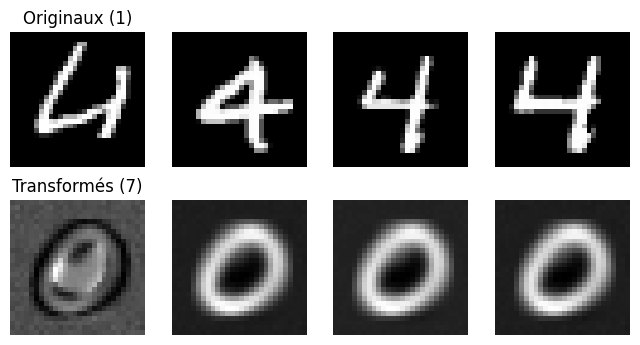

In [57]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
from geomloss import SamplesLoss  # Importer la Sinkhorn Loss

# Fonction d'initialisation des poids et biais
def init_W(out_dim, in_dim):
    return torch.randn(out_dim, in_dim) * 0.01

def init_b(out_dim, in_dim):
    return torch.zeros(out_dim)

# Définition du modèle C-MGN
class CMGN(nn.Module): 
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()

        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])

        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(init_b(embed_dim, embed_dim), requires_grad=True) for _ in range(num_layers+1)])
        self.bias[0] = nn.Parameter(init_b(embed_dim, in_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(init_b(in_dim, embed_dim), requires_grad=True)

        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1,-1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i+1].view(1,-1) * F.linear(x, self.W, self.bias[i+1])
            z = skip + self.alpha[i].view(1,-1) * self.nonlinearity[i](z)

        z = self.alpha[-1].view(1,-1) * self.nonlinearity[-1](z)
        z = F.linear(z, self.W.T, self.bias[-1])

        return z

# Charger MNIST et extraire uniquement les chiffres "1" et "7"
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

mnist_train = datasets.MNIST(root='./data', train=True, download=True, transform=transform)

# Sélectionner uniquement les images de "1" et "7"
X_data, Y_data = [], []

for img, label in mnist_train:
    img_flat = img.view(-1)  # Transformer en vecteur 784
    if label == 4:
        X_data.append(img_flat)
    elif label == 0:
        Y_data.append(img_flat)
    if len(X_data) >= 2000 and len(Y_data) >= 2000:  # Limiter à 2000 exemples pour éviter les problèmes mémoire
        break

# Convertir en tenseurs et équilibrer les tailles
X_data = torch.stack(X_data)
Y_data = torch.stack(Y_data)

min_size = min(len(X_data), len(Y_data))
X_data = X_data[:min_size]
Y_data = Y_data[:min_size]

# Séparer en train / validation (80% train, 20% validation)
train_size = int(0.8 * min_size)
X_train, X_val = X_data[:train_size], X_data[train_size:]
Y_train, Y_val = Y_data[:train_size], Y_data[train_size:]

# Initialisation du modèle
input_dim = 28 * 28
embed_dim = 56
num_layers = 3
model = CMGN(num_layers, input_dim, embed_dim, activation=nn.Tanh)

# Optimisation et Sinkhorn Loss
optimizer = optim.Adam(model.parameters(), lr=1e-4)
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.05)

# Entraînement
num_epochs = 50
batch_size = 128

train_dataset = torch.utils.data.TensorDataset(X_train, Y_train)
val_dataset = torch.utils.data.TensorDataset(X_val, Y_val)

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Sélectionner 4 images de validation pour suivi
test_samples = X_val[:4]

for epoch in range(num_epochs):
    model.train()
    total_train_loss = 0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        g_x = model(x_batch)
        loss = loss_fn(g_x, y_batch)
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item()
    
    # Évaluation sur validation
    model.eval()
    total_val_loss = 0
    with torch.no_grad():
        for x_batch, y_batch in val_loader:
            g_x = model(x_batch)
            loss = loss_fn(g_x, y_batch)
            total_val_loss += loss.item()

    # Affichage des pertes
    print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {total_train_loss/len(train_loader):.6f}, Val Loss: {total_val_loss/len(val_loader):.6f}')

    # Affichage de la transformation toutes les 10 époques
    if epoch % 10 == 0 or epoch == num_epochs - 1:
        with torch.no_grad():
            transformed_samples = model(test_samples).cpu()

        # Fonction pour afficher la transformation en grille
        def show_grid(originals, transformed):
            fig, axes = plt.subplots(2, len(originals), figsize=(len(originals) * 2, 4))
            
            for i in range(len(originals)):
                axes[0, i].imshow(originals[i].reshape(28, 28).detach().cpu().numpy(), cmap="gray")
                axes[0, i].axis("off")
                axes[1, i].imshow(transformed[i].reshape(28, 28).detach().cpu().numpy(), cmap="gray")
                axes[1, i].axis("off")

            axes[0, 0].set_title("Originaux (1)")
            axes[1, 0].set_title("Transformés (7)")

            plt.show()

        show_grid(test_samples, transformed_samples)


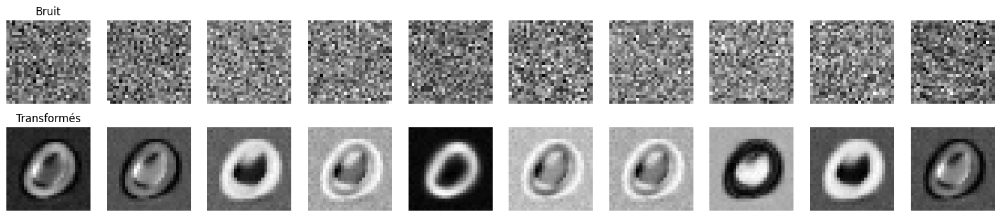

In [58]:
# Générer des images de bruit aléatoire 28x28
num_noise_samples = 10
noise_data = torch.randn(num_noise_samples, 28 * 28)  # Bruit aléatoire

# Faire passer le bruit dans le modèle
noise_transformed = model(noise_data).detach().cpu()

# Afficher la transformation du bruit
def show_grid(originals, transformed, title1="Bruit", title2="Transformés"):
    fig, axes = plt.subplots(2, len(originals), figsize=(len(originals) * 2, 4))
    
    for i in range(len(originals)):
        axes[0, i].imshow(originals[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[0, i].axis("off")
        axes[1, i].imshow(transformed[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[1, i].axis("off")

    axes[0, 0].set_title(title1)
    axes[1, 0].set_title(title2)
    plt.show()

# Afficher les transformations du bruit
show_grid(noise_data, noise_transformed)


In [61]:
# Ajout du bruit au dataset d'entraînement
num_noise_train = int(0.1 * train_size)  # 10% du dataset
noise_train = torch.randn(num_noise_train, 28 * 28)  # Bruit aléatoire

# Modification de l'entraînement
for epoch in range(num_epochs):
    model.train()
    total_train_loss = 0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        g_x = model(x_batch)

        # Calcul de la loss normale (1 → 7)
        loss_transform = loss_fn(g_x, y_batch)

        # Calcul de la loss sur le bruit (il doit rester bruit)
        noise_batch = torch.randn_like(x_batch)  # Générer du bruit
        noise_output = model(noise_batch)
        loss_noise = loss_fn(noise_output, noise_batch)  # Il doit rester bruit

        # Combiner les pertes
        loss = loss_transform + 0.5 * loss_noise  # On pèse la perte du bruit
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item()

    print(f'Epoch {epoch+1}, Train Loss: {total_train_loss/len(train_loader):.6f}')


Epoch 1, Train Loss: 284.431378
Epoch 2, Train Loss: 283.707872
Epoch 3, Train Loss: 283.059422
Epoch 4, Train Loss: 282.895515
Epoch 5, Train Loss: 281.995124
Epoch 6, Train Loss: 282.038922
Epoch 7, Train Loss: 281.575721
Epoch 8, Train Loss: 282.145602
Epoch 9, Train Loss: 280.523639
Epoch 10, Train Loss: 280.732948
Epoch 11, Train Loss: 280.158086
Epoch 12, Train Loss: 280.007209
Epoch 13, Train Loss: 279.955318
Epoch 14, Train Loss: 279.452200
Epoch 15, Train Loss: 279.459088
Epoch 16, Train Loss: 279.370955
Epoch 17, Train Loss: 280.143613
Epoch 18, Train Loss: 278.519818
Epoch 19, Train Loss: 278.472208
Epoch 20, Train Loss: 277.978574
Epoch 21, Train Loss: 277.760561
Epoch 22, Train Loss: 277.762606
Epoch 23, Train Loss: 277.465435
Epoch 24, Train Loss: 277.279116
Epoch 25, Train Loss: 277.556103
Epoch 26, Train Loss: 277.315871
Epoch 27, Train Loss: 276.534968
Epoch 28, Train Loss: 276.786454
Epoch 29, Train Loss: 276.948810
Epoch 30, Train Loss: 275.675164
Epoch 31, Train Los

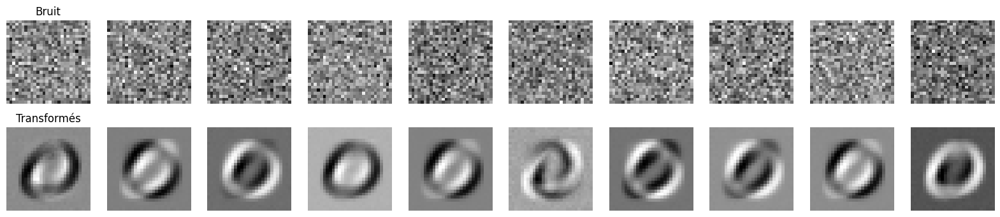

In [62]:
# Générer des images de bruit aléatoire 28x28
num_noise_samples = 10
noise_data = torch.randn(num_noise_samples, 28 * 28)  # Bruit aléatoire

# Faire passer le bruit dans le modèle
noise_transformed = model(noise_data).detach().cpu()

# Afficher la transformation du bruit
def show_grid(originals, transformed, title1="Bruit", title2="Transformés"):
    fig, axes = plt.subplots(2, len(originals), figsize=(len(originals) * 2, 4))
    
    for i in range(len(originals)):
        axes[0, i].imshow(originals[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[0, i].axis("off")
        axes[1, i].imshow(transformed[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[1, i].axis("off")

    axes[0, 0].set_title(title1)
    axes[1, 0].set_title(title2)
    plt.show()

# Afficher les transformations du bruit
show_grid(noise_data, noise_transformed)


Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 9912422/9912422 [00:01<00:00, 9602035.91it/s] 


Extracting /mnt/data\MNIST\raw\train-images-idx3-ubyte.gz to /mnt/data\MNIST\raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 28881/28881 [00:00<00:00, 346460.32it/s]


Extracting /mnt/data\MNIST\raw\train-labels-idx1-ubyte.gz to /mnt/data\MNIST\raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 1648877/1648877 [00:00<00:00, 3112488.99it/s]


Extracting /mnt/data\MNIST\raw\t10k-images-idx3-ubyte.gz to /mnt/data\MNIST\raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 4542/4542 [00:00<?, ?it/s]


Extracting /mnt/data\MNIST\raw\t10k-labels-idx1-ubyte.gz to /mnt/data\MNIST\raw

Epoch 1/200, Train Loss: 163.431723, Val Loss: 85.195513, LR: 0.001000
Epoch 2/200, Train Loss: 82.422403, Val Loss: 81.731296, LR: 0.001000
Epoch 3/200, Train Loss: 80.522687, Val Loss: 80.498239, LR: 0.001000
Epoch 4/200, Train Loss: 79.267646, Val Loss: 79.330985, LR: 0.001000
Epoch 5/200, Train Loss: 78.342255, Val Loss: 78.650531, LR: 0.001000
Epoch 6/200, Train Loss: 77.707605, Val Loss: 78.219227, LR: 0.001000
Epoch 7/200, Train Loss: 77.246402, Val Loss: 77.830307, LR: 0.001000
Epoch 8/200, Train Loss: 76.931030, Val Loss: 77.531931, LR: 0.001000
Epoch 9/200, Train Loss: 76.652140, Val Loss: 77.299808, LR: 0.001000
Epoch 10/200, Train Loss: 76.356433, Val Loss: 77.164158, LR: 0.001000
Epoch 11/200, Train Loss: 76.171951, Val Loss: 77.008914, LR: 0.001000
Epoch 12/200, Train Loss: 76.067293, Val Loss: 76.895508, LR: 0.001000
Epoch 13/200, Train Loss: 75.881781, Val Loss: 76.825036, LR: 0.001000
Epoc

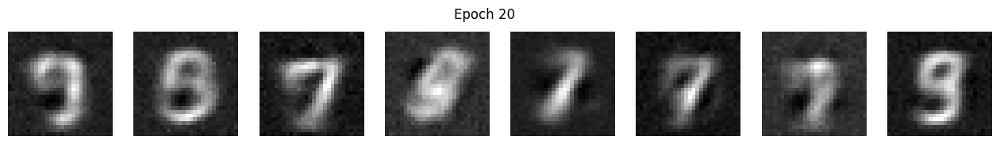

Epoch 21/200, Train Loss: 74.886894, Val Loss: 76.034557, LR: 0.001000
Epoch 22/200, Train Loss: 74.818425, Val Loss: 75.970161, LR: 0.001000
Epoch 23/200, Train Loss: 74.774708, Val Loss: 75.982620, LR: 0.001000
Epoch 24/200, Train Loss: 74.629705, Val Loss: 75.871410, LR: 0.001000
Epoch 25/200, Train Loss: 74.555138, Val Loss: 75.884603, LR: 0.001000
Epoch 26/200, Train Loss: 74.544484, Val Loss: 75.769914, LR: 0.001000
Epoch 27/200, Train Loss: 74.283204, Val Loss: 75.739148, LR: 0.001000
Epoch 28/200, Train Loss: 74.268132, Val Loss: 75.677085, LR: 0.001000
Epoch 29/200, Train Loss: 74.331399, Val Loss: 75.686789, LR: 0.001000
Epoch 30/200, Train Loss: 74.176098, Val Loss: 75.638810, LR: 0.001000
Epoch 31/200, Train Loss: 74.123737, Val Loss: 75.629462, LR: 0.001000
Epoch 32/200, Train Loss: 74.079243, Val Loss: 75.688813, LR: 0.001000
Epoch 33/200, Train Loss: 74.146468, Val Loss: 75.663013, LR: 0.001000
Epoch 34/200, Train Loss: 73.938695, Val Loss: 75.491107, LR: 0.001000
Epoch 

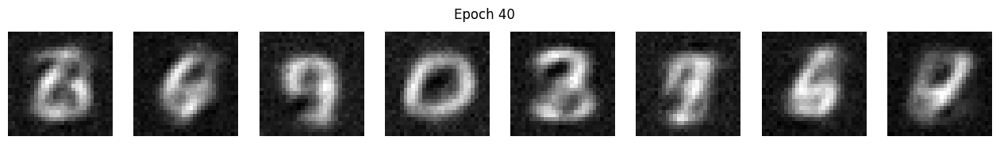

Epoch 41/200, Train Loss: 73.756647, Val Loss: 75.356198, LR: 0.001000
Epoch 42/200, Train Loss: 73.641356, Val Loss: 75.377439, LR: 0.001000
Epoch 43/200, Train Loss: 73.674890, Val Loss: 75.364915, LR: 0.001000
Epoch 44/200, Train Loss: 73.687797, Val Loss: 75.451362, LR: 0.001000
Epoch 45/200, Train Loss: 73.596761, Val Loss: 75.399992, LR: 0.001000
Epoch 46/200, Train Loss: 73.513577, Val Loss: 75.367801, LR: 0.001000
Epoch 47/200, Train Loss: 73.525044, Val Loss: 75.384339, LR: 0.001000
Epoch 48/200, Train Loss: 73.584509, Val Loss: 75.255865, LR: 0.001000
Epoch 49/200, Train Loss: 73.511600, Val Loss: 75.311845, LR: 0.001000
Epoch 50/200, Train Loss: 73.442943, Val Loss: 75.351301, LR: 0.000500
Epoch 51/200, Train Loss: 73.178155, Val Loss: 75.134623, LR: 0.000500
Epoch 52/200, Train Loss: 73.013280, Val Loss: 75.080213, LR: 0.000500
Epoch 53/200, Train Loss: 73.012489, Val Loss: 75.026167, LR: 0.000500
Epoch 54/200, Train Loss: 72.847890, Val Loss: 75.053029, LR: 0.000500
Epoch 

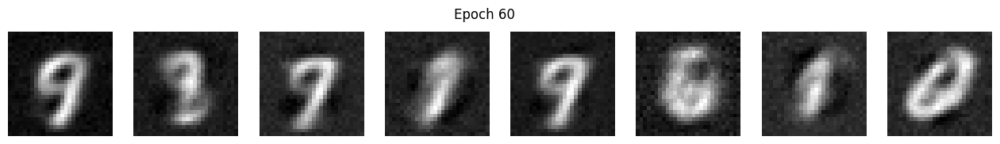

Epoch 61/200, Train Loss: 72.625932, Val Loss: 74.986264, LR: 0.000500
Epoch 62/200, Train Loss: 72.548488, Val Loss: 74.994985, LR: 0.000500
Epoch 63/200, Train Loss: 72.536735, Val Loss: 75.014097, LR: 0.000500
Epoch 64/200, Train Loss: 72.547107, Val Loss: 75.037865, LR: 0.000500


KeyboardInterrupt: 

In [69]:
# Recharger les bibliothèques nécessaires
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
from geomloss import SamplesLoss  # Importer la Sinkhorn Loss
from torchvision import datasets, transforms

# Définition du modèle C-MGN pour la génération d'images
class CMGN_Generator(nn.Module): 
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()
        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])
        self.W = nn.Parameter(torch.randn(embed_dim, in_dim) * 0.01, requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(torch.zeros(embed_dim), requires_grad=True) for _ in range(num_layers+1)])
        self.bias[0] = nn.Parameter(torch.zeros(embed_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(torch.zeros(in_dim), requires_grad=True)
        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1,-1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i+1].view(1,-1) * F.linear(x, self.W, self.bias[i+1])
            z = skip + self.alpha[i].view(1,-1) * self.nonlinearity[i](z)
        z = self.alpha[-1].view(1,-1) * self.nonlinearity[-1](z)
        z = F.linear(z, self.W.T, self.bias[-1])
        return z

# Préparation des données MNIST
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

mnist_train_full = datasets.MNIST(root='/mnt/data', train=True, download=True, transform=transform)

# Split train/val
train_size = 50000
val_size = 10000
mnist_train, mnist_val = torch.utils.data.random_split(mnist_train_full, [train_size, val_size])

mnist_train_samples = torch.stack([img.view(-1) for img, _ in mnist_train])
mnist_val_samples = torch.stack([img.view(-1) for img, _ in mnist_val])

# Données de bruit
gaussian_train = torch.randn(train_size, 28 * 28)
gaussian_val = torch.randn(val_size, 28 * 28)

# Datasets & Loaders
batch_size = 128

train_dataset = torch.utils.data.TensorDataset(gaussian_train, mnist_train_samples)
val_dataset = torch.utils.data.TensorDataset(gaussian_val, mnist_val_samples)

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Initialisation du modèle et de la loss
input_dim = 28 * 28
embed_dim = 256
num_layers = 10
generator = CMGN_Generator(num_layers, input_dim, embed_dim, activation=nn.Tanh)

optimizer = optim.Adam(generator.parameters(), lr=1e-3)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)  # Réduction du LR toutes les 50 époques
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.05)

# Fonction pour afficher une grille d’images
def show_grid(generated, title=''):
    fig, axes = plt.subplots(1, len(generated), figsize=(len(generated) * 2, 2))
    for i in range(len(generated)):
        axes[i].imshow(generated[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[i].axis("off")
    if title:
        plt.suptitle(title)
    plt.show()

# Boucle d'entraînement
num_epochs = 200
for epoch in range(num_epochs):
    generator.train()
    total_train_loss = 0

    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        g_x = generator(x_batch)
        loss = loss_fn(g_x, y_batch)
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item()

    scheduler.step()  # Mise à jour du learning rate

    # Validation
    generator.eval()
    total_val_loss = 0
    with torch.no_grad():
        for x_batch, y_batch in val_loader:
            g_x = generator(x_batch)
            val_loss = loss_fn(g_x, y_batch)
            total_val_loss += val_loss.item()

    print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {total_train_loss/len(train_loader):.6f}, Val Loss: {total_val_loss/len(val_loader):.6f}, LR: {scheduler.get_last_lr()[0]:.6f}')

    # Affichage toutes les 20 époques
    if (epoch + 1) % 20 == 0 or epoch == num_epochs - 1:
        with torch.no_grad():
            generated_samples = generator(torch.randn(8, 28 * 28)).cpu()
        show_grid(generated_samples, title=f"Epoch {epoch+1}")


Epoch 1/200, Loss: 143.334346
Epoch 2/200, Loss: 85.302640
Epoch 3/200, Loss: 82.897565
Epoch 4/200, Loss: 78.830279
Epoch 5/200, Loss: 76.370584
Epoch 6/200, Loss: 75.202814
Epoch 7/200, Loss: 74.258377
Epoch 8/200, Loss: 73.360539
Epoch 9/200, Loss: 72.771777
Epoch 10/200, Loss: 72.042709
Epoch 11/200, Loss: 71.451348
Epoch 12/200, Loss: 71.060277
Epoch 13/200, Loss: 70.734375
Epoch 14/200, Loss: 70.301823
Epoch 15/200, Loss: 69.980859
Epoch 16/200, Loss: 69.703779
Epoch 17/200, Loss: 69.614823
Epoch 18/200, Loss: 69.086920
Epoch 19/200, Loss: 69.148936
Epoch 20/200, Loss: 68.904522


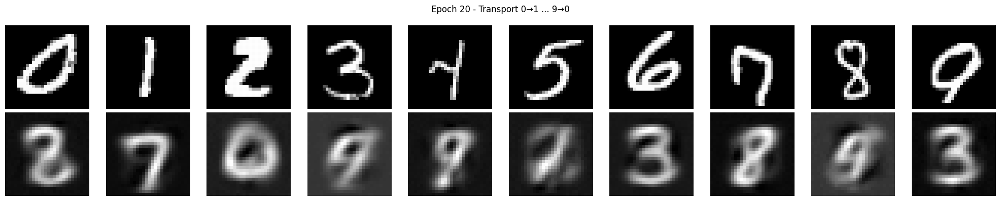

Epoch 21/200, Loss: 68.739496
Epoch 22/200, Loss: 68.524537
Epoch 23/200, Loss: 68.529573
Epoch 24/200, Loss: 68.345228
Epoch 25/200, Loss: 68.450868
Epoch 26/200, Loss: 68.063968
Epoch 27/200, Loss: 67.919436
Epoch 28/200, Loss: 67.765016
Epoch 29/200, Loss: 67.798227
Epoch 30/200, Loss: 67.724104
Epoch 31/200, Loss: 67.393859
Epoch 32/200, Loss: 67.431711
Epoch 33/200, Loss: 67.235013
Epoch 34/200, Loss: 67.138393
Epoch 35/200, Loss: 67.159964
Epoch 36/200, Loss: 67.223519
Epoch 37/200, Loss: 67.136994
Epoch 38/200, Loss: 66.986059
Epoch 39/200, Loss: 66.991107
Epoch 40/200, Loss: 66.963832


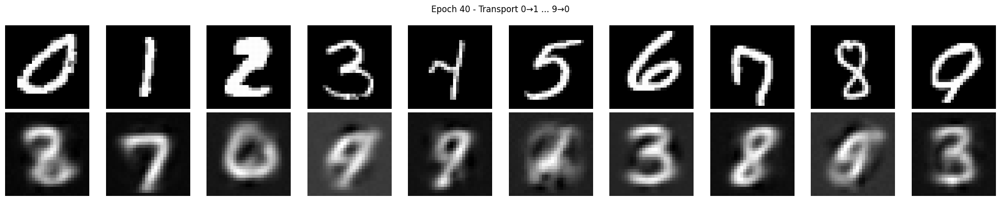

Epoch 41/200, Loss: 66.907180
Epoch 42/200, Loss: 66.792862
Epoch 43/200, Loss: 66.906803
Epoch 44/200, Loss: 66.758542
Epoch 45/200, Loss: 66.659003
Epoch 46/200, Loss: 66.729561
Epoch 47/200, Loss: 66.803695
Epoch 48/200, Loss: 66.576185
Epoch 49/200, Loss: 66.551938
Epoch 50/200, Loss: 66.360735
Epoch 51/200, Loss: 66.319513
Epoch 52/200, Loss: 66.173257
Epoch 53/200, Loss: 66.056188
Epoch 54/200, Loss: 66.186195
Epoch 55/200, Loss: 66.138961
Epoch 56/200, Loss: 66.136100
Epoch 57/200, Loss: 65.875411
Epoch 58/200, Loss: 66.037664
Epoch 59/200, Loss: 66.079084
Epoch 60/200, Loss: 66.165028


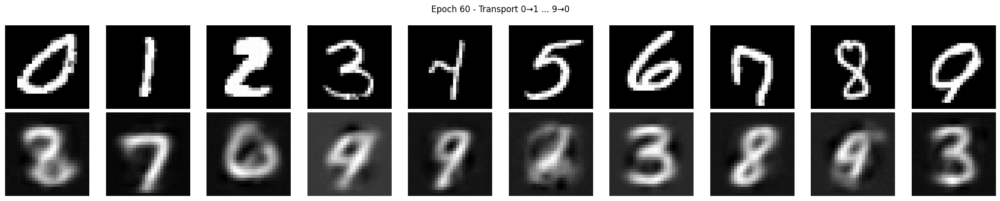

Epoch 61/200, Loss: 66.091124
Epoch 62/200, Loss: 66.070094
Epoch 63/200, Loss: 65.933914
Epoch 64/200, Loss: 65.857251
Epoch 65/200, Loss: 65.979577
Epoch 66/200, Loss: 65.811715
Epoch 67/200, Loss: 65.691082
Epoch 68/200, Loss: 65.841076
Epoch 69/200, Loss: 65.823188
Epoch 70/200, Loss: 65.734398
Epoch 71/200, Loss: 65.777127
Epoch 72/200, Loss: 65.820197
Epoch 73/200, Loss: 65.694564
Epoch 74/200, Loss: 65.833820
Epoch 75/200, Loss: 65.677688
Epoch 76/200, Loss: 65.717649
Epoch 77/200, Loss: 65.666095
Epoch 78/200, Loss: 65.725435
Epoch 79/200, Loss: 65.520604
Epoch 80/200, Loss: 65.962352


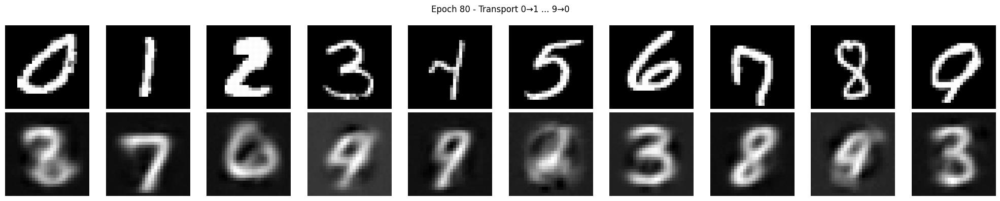

Epoch 81/200, Loss: 65.550713
Epoch 82/200, Loss: 65.627910
Epoch 83/200, Loss: 65.745965
Epoch 84/200, Loss: 65.603223
Epoch 85/200, Loss: 65.639770
Epoch 86/200, Loss: 65.520968
Epoch 87/200, Loss: 65.757342
Epoch 88/200, Loss: 65.707706
Epoch 89/200, Loss: 65.536079
Epoch 90/200, Loss: 65.604669
Epoch 91/200, Loss: 65.415764
Epoch 92/200, Loss: 65.486061
Epoch 93/200, Loss: 65.434822
Epoch 94/200, Loss: 65.452131
Epoch 95/200, Loss: 65.336930
Epoch 96/200, Loss: 65.745179
Epoch 97/200, Loss: 65.492436
Epoch 98/200, Loss: 65.387837
Epoch 99/200, Loss: 65.411699
Epoch 100/200, Loss: 65.393463


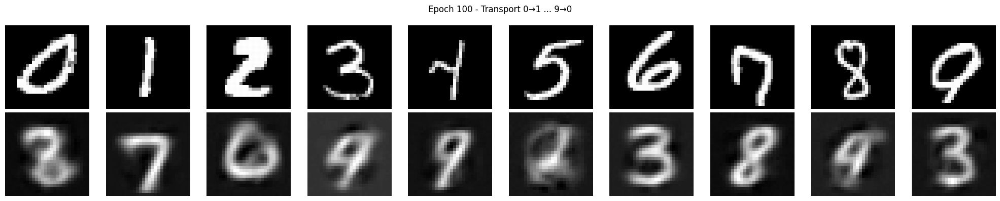

Epoch 101/200, Loss: 65.167571
Epoch 102/200, Loss: 65.229843
Epoch 103/200, Loss: 65.128084
Epoch 104/200, Loss: 65.296935
Epoch 105/200, Loss: 65.144751
Epoch 106/200, Loss: 65.107835
Epoch 107/200, Loss: 65.108662
Epoch 108/200, Loss: 65.175413
Epoch 109/200, Loss: 65.050954
Epoch 110/200, Loss: 64.959774


KeyboardInterrupt: 

In [77]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision import datasets, transforms
from geomloss import SamplesLoss
from torch.utils.data import random_split, DataLoader, TensorDataset

# ----- Modèle CMGN -----
class CMGN_Generator(nn.Module): 
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()
        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])
        self.W = nn.Parameter(torch.randn(embed_dim, in_dim) * 0.01, requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(torch.zeros(embed_dim), requires_grad=True) for _ in range(num_layers+1)])
        self.bias[0] = nn.Parameter(torch.zeros(embed_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(torch.zeros(in_dim), requires_grad=True)
        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1,-1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i+1].view(1,-1) * F.linear(x, self.W, self.bias[i+1])
            z = skip + self.alpha[i].view(1,-1) * self.nonlinearity[i](z)
        z = self.alpha[-1].view(1,-1) * self.nonlinearity[-1](z)
        z = F.linear(z, self.W.T, self.bias[-1])
        return z

# ----- Utils -----
def show_comparison_grid(inputs, outputs, title=''):
    """Affiche les inputs (ligne 1) et outputs (ligne 2) côte à côte"""
    fig, axes = plt.subplots(2, len(inputs), figsize=(len(inputs) * 2, 4))
    for i in range(len(inputs)):
        axes[0, i].imshow(inputs[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[0, i].axis("off")
        axes[1, i].imshow(outputs[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[1, i].axis("off")
    axes[0, 0].set_ylabel("Input", fontsize=12)
    axes[1, 0].set_ylabel("Output", fontsize=12)
    if title:
        plt.suptitle(title)
    plt.tight_layout()
    plt.show()

def extract_digits(dataset, digit, n):
    return torch.stack([img.view(-1) for img, label in dataset if label == digit][:n])

def get_single_digit_samples(dataset, digits):
    samples = []
    for d in digits:
        for img, label in dataset:
            if label == d:
                samples.append(img.view(-1))
                break
    return torch.stack(samples)

# ----- Préparation des données -----
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

mnist_full = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
mnist_train, mnist_val = random_split(mnist_full, [50000, 10000])  # 50k train / 10k val

digit_pairs = [(i, (i + 1) % 10) for i in range(10)]
samples_per_digit = 2000

# Préparer les données d'entraînement
all_source_images = []
all_target_images = []

for src, tgt in digit_pairs:
    src_imgs = extract_digits(mnist_train, src, samples_per_digit)
    tgt_imgs = extract_digits(mnist_train, tgt, samples_per_digit)
    all_source_images.append(src_imgs)
    all_target_images.append(tgt_imgs)

X_all = torch.cat(all_source_images, dim=0)
Y_all = torch.cat(all_target_images, dim=0)

train_dataset = TensorDataset(X_all, Y_all)
train_loader = DataLoader(train_dataset, batch_size=256, shuffle=True)

# ----- Initialisation -----
generator = CMGN_Generator(num_layers=12, in_dim=28*28, embed_dim=512, activation=nn.Tanh)
optimizer = optim.Adam(generator.parameters(), lr=5e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.03)

# ----- Entraînement -----
num_epochs = 200
for epoch in range(num_epochs):
    generator.train()
    total_loss = 0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        g_x = generator(x_batch)
        loss = loss_fn(g_x, y_batch)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    scheduler.step()
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(train_loader):.6f}")

    if (epoch + 1) % 20 == 0 or epoch == num_epochs - 1:
        with torch.no_grad():
            test_inputs = torch.cat([imgs[:1] for imgs in all_source_images], dim=0)  # 0 à 9
            test_outputs = generator(test_inputs)
            show_comparison_grid(test_inputs, test_outputs, title=f"Epoch {epoch+1} - Transport 0→1 ... 9→0")

# ----- Test final sur la validation -----
print("\n🎯 Test final (données jamais vues) :")
input_digits = list(range(10))  # 0 à 9
val_inputs = get_single_digit_samples(mnist_val, input_digits)

with torch.no_grad():
    val_outputs = generator(val_inputs)

# Afficher la ligne des transformations et labels
transformations = [f"{i}→{(i+1)%10}" for i in range(10)]
input_labels = [f"[{i}]" for i in range(10)]

print("  ".join(transformations))
print("  ".join(input_labels))

# Grille comparaison input/output
show_comparison_grid(val_inputs, val_outputs, title="Résultat final - Validation (0→1 ... 9→0)")


Résultat du transport :


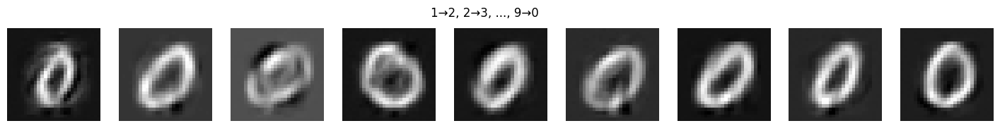

In [71]:
# 🔍 Test final : donner les chiffres 1 à 9 et montrer les images transformées
def get_single_digit_samples(dataset, digits):
    samples = []
    for d in digits:
        for img, label in dataset:
            if label == d:
                samples.append(img.view(-1))
                break  # prendre la première occurrence
    return torch.stack(samples)

# Données d'entrée : chiffres 1 à 9
input_digits = list(range(1, 10))  # [1, 2, ..., 9]
input_images = get_single_digit_samples(mnist_train_full, input_digits)

# Génération
with torch.no_grad():
    transformed_images = generator(input_images)

# Affichage
print("Résultat du transport :")
show_grid(transformed_images, title="1→2, 2→3, ..., 9→0")


## Meme chose avec M-MGN

Epoch 1/200, Loss: 77.171764
Epoch 2/200, Loss: 66.435795
Epoch 3/200, Loss: 66.238290
Epoch 4/200, Loss: 66.152660
Epoch 5/200, Loss: 65.905527
Epoch 6/200, Loss: 65.863697
Epoch 7/200, Loss: 65.602396
Epoch 8/200, Loss: 65.567807
Epoch 9/200, Loss: 65.055661
Epoch 10/200, Loss: 64.627092
Epoch 11/200, Loss: 64.557843
Epoch 12/200, Loss: 64.261065
Epoch 13/200, Loss: 64.034912
Epoch 14/200, Loss: 64.065128
Epoch 15/200, Loss: 63.703299
Epoch 16/200, Loss: 63.796195
Epoch 17/200, Loss: 63.622293
Epoch 18/200, Loss: 63.171635
Epoch 19/200, Loss: 63.308474
Epoch 20/200, Loss: 63.352034


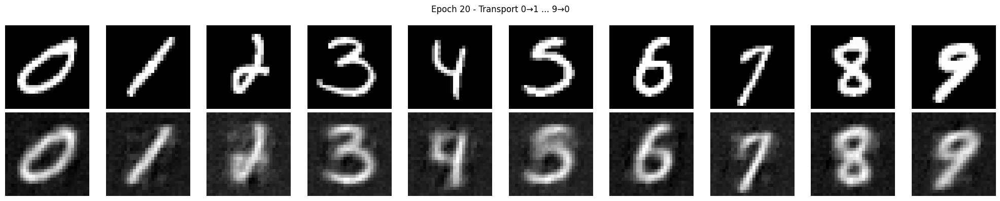

Epoch 21/200, Loss: 63.183733
Epoch 22/200, Loss: 62.951222
Epoch 23/200, Loss: 62.763238
Epoch 24/200, Loss: 62.949283
Epoch 25/200, Loss: 62.859728
Epoch 26/200, Loss: 62.664468
Epoch 27/200, Loss: 62.739425
Epoch 28/200, Loss: 62.634084
Epoch 29/200, Loss: 62.689106
Epoch 30/200, Loss: 62.550422
Epoch 31/200, Loss: 62.237785
Epoch 32/200, Loss: 62.257043
Epoch 33/200, Loss: 62.374317
Epoch 34/200, Loss: 62.346681
Epoch 35/200, Loss: 62.309814
Epoch 36/200, Loss: 62.241995
Epoch 37/200, Loss: 62.375689
Epoch 38/200, Loss: 62.185608
Epoch 39/200, Loss: 62.237181
Epoch 40/200, Loss: 62.207654


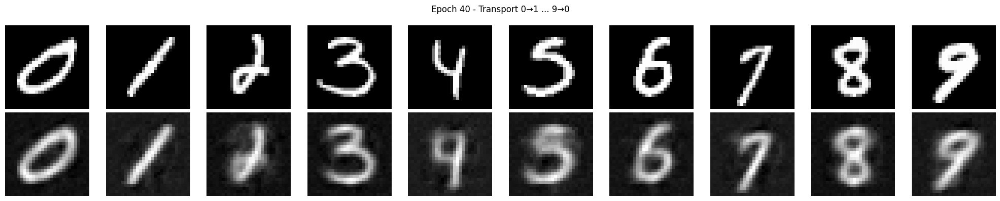

Epoch 41/200, Loss: 62.070099
Epoch 42/200, Loss: 61.968322
Epoch 43/200, Loss: 61.913836
Epoch 44/200, Loss: 62.235929
Epoch 45/200, Loss: 61.986603
Epoch 46/200, Loss: 61.683757
Epoch 47/200, Loss: 62.005735
Epoch 48/200, Loss: 61.952112
Epoch 49/200, Loss: 61.744149
Epoch 50/200, Loss: 62.105202
Epoch 51/200, Loss: 61.321689
Epoch 52/200, Loss: 61.228906
Epoch 53/200, Loss: 61.429920
Epoch 54/200, Loss: 61.272268
Epoch 55/200, Loss: 61.152656
Epoch 56/200, Loss: 61.224976
Epoch 57/200, Loss: 61.321787
Epoch 58/200, Loss: 61.226219
Epoch 59/200, Loss: 61.161831
Epoch 60/200, Loss: 61.330554


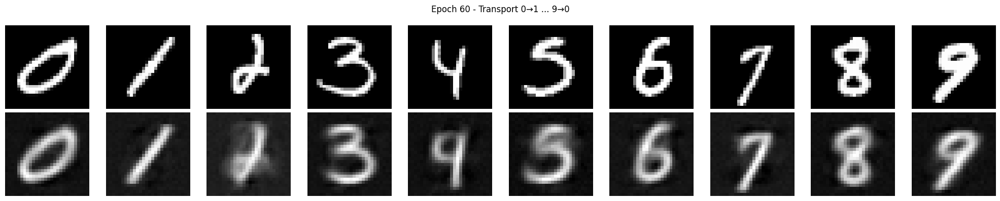

Epoch 61/200, Loss: 61.302349
Epoch 62/200, Loss: 61.200504
Epoch 63/200, Loss: 61.286287
Epoch 64/200, Loss: 61.218163
Epoch 65/200, Loss: 61.005661
Epoch 66/200, Loss: 61.339212
Epoch 67/200, Loss: 61.439278
Epoch 68/200, Loss: 61.043713
Epoch 69/200, Loss: 61.157676
Epoch 70/200, Loss: 61.087231
Epoch 71/200, Loss: 61.417367
Epoch 72/200, Loss: 61.431746
Epoch 73/200, Loss: 61.256173
Epoch 74/200, Loss: 61.068813
Epoch 75/200, Loss: 61.512729
Epoch 76/200, Loss: 61.030611
Epoch 77/200, Loss: 61.113915
Epoch 78/200, Loss: 61.065841
Epoch 79/200, Loss: 61.300785
Epoch 80/200, Loss: 61.275893


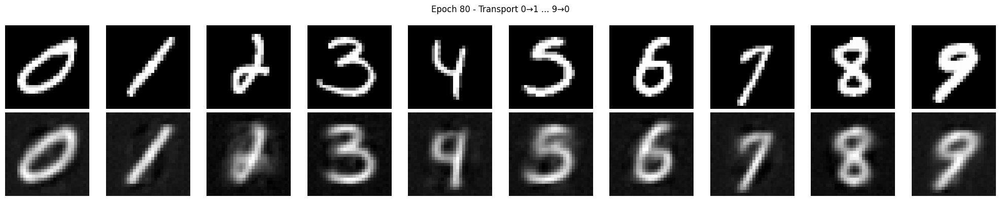

Epoch 81/200, Loss: 61.319566


KeyboardInterrupt: 

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision import datasets, transforms
from geomloss import SamplesLoss
from torch.utils.data import random_split, DataLoader, TensorDataset

# ----- Initializers -----
def init_W(embed_dim, in_dim):
    return torch.randn(embed_dim, in_dim) * 0.01

def init_b(size):
    return torch.zeros(size)

# ----- Modèle ModularGradNet -----
class Module_ModularGN(nn.Module):
    def __init__(self, in_dim, embed_dim, activation):
        super().__init__()
        self.beta = nn.Parameter(torch.rand(1), requires_grad=True)
        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.b = nn.Parameter(init_b(embed_dim), requires_grad=True)
        self.act = activation()

    def forward(self, x):
        z = F.linear(x, weight=self.W, bias=self.b)
        z = self.act(z * F.softplus(self.beta))
        z = F.linear(z, weight=self.W.T)
        return z

class ModularGradNet(nn.Module):
    def __init__(self, num_modules, in_dim, embed_dim, activation):
        super().__init__()
        self.num_modules = num_modules
        self.mmgn_modules = nn.ModuleList([Module_ModularGN(in_dim, embed_dim, activation) for _ in range(num_modules)])
        self.alpha = nn.Parameter(torch.randn(num_modules), requires_grad=True)
        self.bias = nn.Parameter(init_b(in_dim), requires_grad=True)

    def forward(self, x):
        out = 0
        for i in range(self.num_modules):
            out += self.alpha[i] * self.mmgn_modules[i](x)
        out += self.bias
        return out

# ----- Utils -----
def show_comparison_grid(inputs, outputs, title=''):
    fig, axes = plt.subplots(2, len(inputs), figsize=(len(inputs) * 2, 4))
    for i in range(len(inputs)):
        axes[0, i].imshow(inputs[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[0, i].axis("off")
        axes[1, i].imshow(outputs[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[1, i].axis("off")
    axes[0, 0].set_ylabel("Input", fontsize=12)
    axes[1, 0].set_ylabel("Output", fontsize=12)
    if title:
        plt.suptitle(title)
    plt.tight_layout()
    plt.show()

def extract_digits(dataset, digit, n):
    return torch.stack([img.view(-1) for img, label in dataset if label == digit][:n])

def get_single_digit_samples(dataset, digits):
    samples = []
    for d in digits:
        for img, label in dataset:
            if label == d:
                samples.append(img.view(-1))
                break
    return torch.stack(samples)

# ----- Préparation des données -----
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

mnist_full = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
mnist_train, mnist_val = random_split(mnist_full, [50000, 10000])

digit_pairs = [(i, (i + 1) % 10) for i in range(10)]
samples_per_digit = 2000

all_source_images = []
all_target_images = []

for src, tgt in digit_pairs:
    src_imgs = extract_digits(mnist_train, src, samples_per_digit)
    tgt_imgs = extract_digits(mnist_train, tgt, samples_per_digit)
    all_source_images.append(src_imgs)
    all_target_images.append(tgt_imgs)

X_all = torch.cat(all_source_images, dim=0)
Y_all = torch.cat(all_target_images, dim=0)

train_dataset = TensorDataset(X_all, Y_all)
train_loader = DataLoader(train_dataset, batch_size=256, shuffle=True)

# ----- Initialisation -----
generator = ModularGradNet(num_modules=20, in_dim=28*28, embed_dim=256, activation=nn.Tanh)
optimizer = optim.Adam(generator.parameters(), lr=5e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.03)

# ----- Entraînement -----
num_epochs = 200
for epoch in range(num_epochs):
    generator.train()
    total_loss = 0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        g_x = generator(x_batch)
        loss = loss_fn(g_x, y_batch)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    scheduler.step()
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(train_loader):.6f}")

    if (epoch + 1) % 20 == 0 or epoch == num_epochs - 1:
        with torch.no_grad():
            test_inputs = torch.cat([imgs[:1] for imgs in all_source_images], dim=0)
            test_outputs = generator(test_inputs)
            show_comparison_grid(test_inputs, test_outputs, title=f"Epoch {epoch+1} - Transport 0→1 ... 9→0")

# ----- Test final sur la validation -----
print("\n🎯 Test final (données jamais vues) :")
input_digits = list(range(10))
val_inputs = get_single_digit_samples(mnist_val, input_digits)

with torch.no_grad():
    val_outputs = generator(val_inputs)

transformations = [f"{i}→{(i+1)%10}" for i in range(10)]
input_labels = [f"[{i}]" for i in range(10)]

print("  ".join(transformations))
print("  ".join(input_labels))

show_comparison_grid(val_inputs, val_outputs, title="Résultat final - Validation (0→1 ... 9→0)")


Epoch 1/200 | Train Loss: 348.195523 | Val Loss: 203.408163
Epoch 2/200 | Train Loss: 149.681358 | Val Loss: 101.752356
Epoch 3/200 | Train Loss: 99.961794 | Val Loss: 92.748959
Epoch 4/200 | Train Loss: 96.593200 | Val Loss: 92.153106
Epoch 5/200 | Train Loss: 96.570333 | Val Loss: 92.075196
Epoch 6/200 | Train Loss: 95.879751 | Val Loss: 91.354421
Epoch 7/200 | Train Loss: 95.561525 | Val Loss: 91.080346
Epoch 8/200 | Train Loss: 94.117526 | Val Loss: 89.951866
Epoch 9/200 | Train Loss: 92.833834 | Val Loss: 89.836942
Epoch 10/200 | Train Loss: 92.603804 | Val Loss: 88.685163
Epoch 11/200 | Train Loss: 91.099516 | Val Loss: 87.957137
Epoch 12/200 | Train Loss: 89.911186 | Val Loss: 87.687649
Epoch 13/200 | Train Loss: 90.300739 | Val Loss: 87.270269
Epoch 14/200 | Train Loss: 89.170235 | Val Loss: 86.692796
Epoch 15/200 | Train Loss: 88.065853 | Val Loss: 85.659332
Epoch 16/200 | Train Loss: 87.211133 | Val Loss: 84.927884
Epoch 17/200 | Train Loss: 86.497195 | Val Loss: 84.718750
Ep

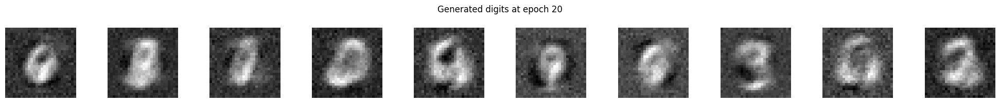

Epoch 21/200 | Train Loss: 84.180541 | Val Loss: 82.991488
Epoch 22/200 | Train Loss: 83.847290 | Val Loss: 83.028216
Epoch 23/200 | Train Loss: 83.863827 | Val Loss: 82.579401
Epoch 24/200 | Train Loss: 83.752755 | Val Loss: 82.772045
Epoch 25/200 | Train Loss: 82.933215 | Val Loss: 81.837223
Epoch 26/200 | Train Loss: 82.674718 | Val Loss: 82.239600
Epoch 27/200 | Train Loss: 82.333399 | Val Loss: 81.346815
Epoch 28/200 | Train Loss: 81.917747 | Val Loss: 81.719368
Epoch 29/200 | Train Loss: 81.674873 | Val Loss: 81.344144
Epoch 30/200 | Train Loss: 81.479161 | Val Loss: 80.847617
Epoch 31/200 | Train Loss: 80.987996 | Val Loss: 80.861838
Epoch 32/200 | Train Loss: 81.251480 | Val Loss: 80.488640
Epoch 33/200 | Train Loss: 80.525317 | Val Loss: 80.696259
Epoch 34/200 | Train Loss: 80.369101 | Val Loss: 80.296336
Epoch 35/200 | Train Loss: 80.359458 | Val Loss: 80.376563
Epoch 36/200 | Train Loss: 80.078397 | Val Loss: 80.248343
Epoch 37/200 | Train Loss: 79.759765 | Val Loss: 79.8347

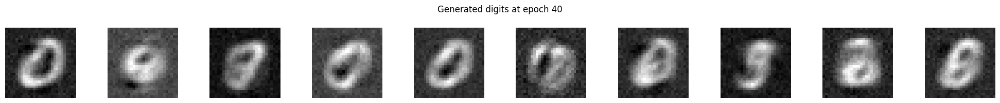

Epoch 41/200 | Train Loss: 78.975254 | Val Loss: 79.761747
Epoch 42/200 | Train Loss: 78.782188 | Val Loss: 79.513917
Epoch 43/200 | Train Loss: 78.710646 | Val Loss: 79.519344
Epoch 44/200 | Train Loss: 78.271242 | Val Loss: 79.194080
Epoch 45/200 | Train Loss: 78.586987 | Val Loss: 79.923450
Epoch 46/200 | Train Loss: 78.701317 | Val Loss: 79.450435
Epoch 47/200 | Train Loss: 78.356457 | Val Loss: 79.043566
Epoch 48/200 | Train Loss: 77.777308 | Val Loss: 79.251721
Epoch 49/200 | Train Loss: 77.888776 | Val Loss: 79.191276
Epoch 50/200 | Train Loss: 77.497329 | Val Loss: 79.234285
Epoch 51/200 | Train Loss: 76.811919 | Val Loss: 78.205965
Epoch 52/200 | Train Loss: 76.027595 | Val Loss: 77.807197
Epoch 53/200 | Train Loss: 75.977083 | Val Loss: 78.001405
Epoch 54/200 | Train Loss: 75.915875 | Val Loss: 78.001409
Epoch 55/200 | Train Loss: 75.661140 | Val Loss: 77.917127
Epoch 56/200 | Train Loss: 75.838159 | Val Loss: 77.957860
Epoch 57/200 | Train Loss: 76.083142 | Val Loss: 78.1251

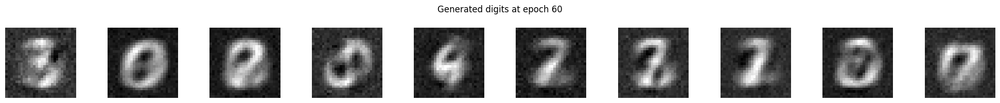

Epoch 61/200 | Train Loss: 75.732741 | Val Loss: 78.172969
Epoch 62/200 | Train Loss: 75.540092 | Val Loss: 77.979795
Epoch 63/200 | Train Loss: 75.478820 | Val Loss: 78.031381
Epoch 64/200 | Train Loss: 75.456501 | Val Loss: 77.862535
Epoch 65/200 | Train Loss: 75.661377 | Val Loss: 77.727407
Epoch 66/200 | Train Loss: 75.175141 | Val Loss: 78.187016
Epoch 67/200 | Train Loss: 75.017086 | Val Loss: 78.119777
Epoch 68/200 | Train Loss: 75.323368 | Val Loss: 78.046615
Epoch 69/200 | Train Loss: 75.366572 | Val Loss: 78.183588
Epoch 70/200 | Train Loss: 75.228499 | Val Loss: 77.563319
Epoch 71/200 | Train Loss: 75.042297 | Val Loss: 77.974113
Epoch 72/200 | Train Loss: 75.118601 | Val Loss: 77.534831
Epoch 73/200 | Train Loss: 74.925911 | Val Loss: 77.613542
Epoch 74/200 | Train Loss: 75.072530 | Val Loss: 77.749190
Epoch 75/200 | Train Loss: 74.490997 | Val Loss: 77.934144
Epoch 76/200 | Train Loss: 74.428223 | Val Loss: 77.731330
Epoch 77/200 | Train Loss: 74.608086 | Val Loss: 77.7690

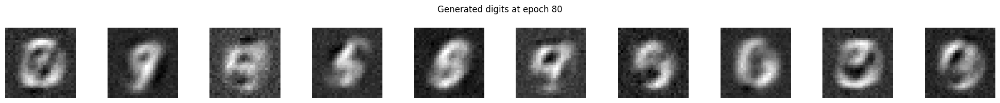

Epoch 81/200 | Train Loss: 73.748422 | Val Loss: 77.730761
Epoch 82/200 | Train Loss: 73.574146 | Val Loss: 78.041285
Epoch 83/200 | Train Loss: 73.535408 | Val Loss: 78.058446
Epoch 84/200 | Train Loss: 73.514407 | Val Loss: 78.134644
Epoch 85/200 | Train Loss: 73.314142 | Val Loss: 78.081077
Epoch 86/200 | Train Loss: 73.038483 | Val Loss: 78.055585
Epoch 87/200 | Train Loss: 72.983246 | Val Loss: 78.236754
Epoch 88/200 | Train Loss: 72.479911 | Val Loss: 78.105687
Epoch 89/200 | Train Loss: 72.221408 | Val Loss: 78.201980
Epoch 90/200 | Train Loss: 71.955169 | Val Loss: 78.184658
Epoch 91/200 | Train Loss: 71.841838 | Val Loss: 78.335697
Epoch 92/200 | Train Loss: 71.766121 | Val Loss: 78.337556
Epoch 93/200 | Train Loss: 71.595603 | Val Loss: 78.362903
Epoch 94/200 | Train Loss: 71.284761 | Val Loss: 78.303130
Epoch 95/200 | Train Loss: 71.226808 | Val Loss: 78.369593
Epoch 96/200 | Train Loss: 70.890113 | Val Loss: 78.331732
Epoch 97/200 | Train Loss: 70.588836 | Val Loss: 78.3762

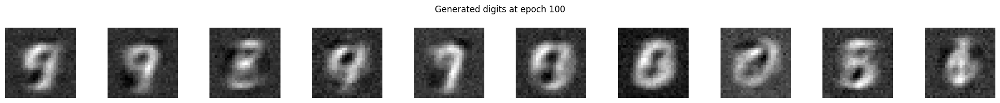

Epoch 101/200 | Train Loss: 69.320827 | Val Loss: 78.045168
Epoch 102/200 | Train Loss: 68.922094 | Val Loss: 78.062883
Epoch 103/200 | Train Loss: 69.025692 | Val Loss: 78.027150
Epoch 104/200 | Train Loss: 68.487253 | Val Loss: 78.056103
Epoch 105/200 | Train Loss: 68.562689 | Val Loss: 78.027890


KeyboardInterrupt: 

In [88]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision import datasets, transforms
from geomloss import SamplesLoss
from torch.utils.data import random_split, DataLoader, TensorDataset

# ----- Initializers -----
def init_W(embed_dim, in_dim):
    return torch.randn(embed_dim, in_dim) * 0.01

def init_b(size):
    return torch.zeros(size)

# ----- Modèle ModularGradNet -----
class Module_ModularGN(nn.Module):
    def __init__(self, in_dim, embed_dim, activation):
        super().__init__()
        self.beta = nn.Parameter(torch.rand(1), requires_grad=True)
        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.b = nn.Parameter(init_b(embed_dim), requires_grad=True)
        self.act = activation()

    def forward(self, x):
        z = F.linear(x, weight=self.W, bias=self.b)
        z = self.act(z * F.softplus(self.beta))
        z = F.linear(z, weight=self.W.T)
        return z

class ModularGradNet(nn.Module):
    def __init__(self, num_modules, in_dim, embed_dim, activation):
        super().__init__()
        self.num_modules = num_modules
        self.mmgn_modules = nn.ModuleList([Module_ModularGN(in_dim, embed_dim, activation) for _ in range(num_modules)])
        self.alpha = nn.Parameter(torch.randn(num_modules), requires_grad=True)
        self.bias = nn.Parameter(init_b(in_dim), requires_grad=True)

    def forward(self, x):
        out = 0
        for i in range(self.num_modules):
            out += self.alpha[i] * self.mmgn_modules[i](x)
        out += self.bias
        return out

# ----- Utils -----
def show_grid(images, title=''):
    fig, axes = plt.subplots(1, len(images), figsize=(len(images) * 2, 2))
    for i in range(len(images)):
        axes[i].imshow(images[i].reshape(28, 28).cpu().numpy(), cmap="gray")
        axes[i].axis("off")
    if title:
        plt.suptitle(title)
    plt.tight_layout()
    plt.show()

# ----- Données MNIST -----
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

mnist_full = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
mnist_train, mnist_val = random_split(mnist_full, [50000, 10000])

# ----- Préparation du dataset bruit → image -----
num_train_samples = 10000
num_val_samples = 2000
input_dim = 28 * 28

# Entrées = bruit aléatoire, cibles = vraies images
train_noise = torch.randn(num_train_samples, input_dim)
train_targets = torch.stack([img.view(-1) for img, _ in list(mnist_train)[:num_train_samples]])

val_noise = torch.randn(num_val_samples, input_dim)
val_targets = torch.stack([img.view(-1) for img, _ in list(mnist_val)[:num_val_samples]])

train_dataset = TensorDataset(train_noise, train_targets)
val_dataset = TensorDataset(val_noise, val_targets)

train_loader = DataLoader(train_dataset, batch_size=256, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=256, shuffle=False)

# ----- Initialisation -----
generator = ModularGradNet(num_modules=50, in_dim=input_dim, embed_dim=512, activation=nn.Tanh)
optimizer = optim.Adam(generator.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.03)

# ----- Entraînement -----
num_epochs = 200
for epoch in range(num_epochs):
    generator.train()
    total_loss = 0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        g_x = generator(x_batch)
        loss = loss_fn(g_x, y_batch)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    scheduler.step()

    # Validation loss (optionnel mais utile)
    generator.eval()
    total_val_loss = 0
    with torch.no_grad():
        for x_val, y_val in val_loader:
            g_val = generator(x_val)
            val_loss = loss_fn(g_val, y_val)
            total_val_loss += val_loss.item()

    print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {total_loss/len(train_loader):.6f} | Val Loss: {total_val_loss/len(val_loader):.6f}")

    if (epoch + 1) % 20 == 0 or epoch == num_epochs - 1:
        with torch.no_grad():
            z = torch.randn(10, input_dim)
            samples = generator(z)
            show_grid(samples, title=f"Generated digits at epoch {epoch+1}")

# ----- Test final -----
print("\n🎯 Génération finale depuis du bruit (validation)")
with torch.no_grad():
    z = torch.randn(10, input_dim)
    samples = generator(z)
    show_grid(samples, title="Final generated digits from noise")


In [91]:
import os
import tarfile
import shutil

# 📂 Chemin vers le dossier contenant les fichiers compressés
data_root = "./data_codan/data"
output_root = "./data_codan/extracted"

# 📌 Fichiers à fusionner (pour train)
train_parts = [
    "codan_train.tar.bz2.part0",
    "codan_train.tar.bz2.part1",
    "codan_train.tar.bz2.part2"
]

# 📌 Fichiers tar.bz2 à extraire
compressed_files = [
    "codan_train.tar.bz2",
    "codan_val.tar.bz2",
    "codan_test_day.tar.bz2",
    "codan_test_night.tar.bz2"
]

# 📌 Étape 1 : Fusionner les fichiers `.part0`, `.part1`, `.part2` en un seul fichier `.tar.bz2`
train_merged_file = os.path.join(data_root, "codan_train.tar.bz2")

if not os.path.exists(train_merged_file):
    print("🔄 Fusion des fichiers train...")
    with open(train_merged_file, "wb") as output_file:
        for part in train_parts:
            with open(os.path.join(data_root, part), "rb") as part_file:
                shutil.copyfileobj(part_file, output_file)
    print("✅ Fusion terminée !")

# 📌 Étape 2 : Extraire les fichiers `.tar.bz2`
def extract_bz2(filepath):
    """Décompresse un fichier .tar.bz2"""
    print(f"🔄 Extraction de {filepath}...")
    with tarfile.open(filepath, "r:bz2") as tar:
        tar.extractall(data_root)
    print(f"✅ {filepath} extrait avec succès !")

for file in compressed_files:
    filepath = os.path.join(data_root, file)
    if os.path.exists(filepath):
        extract_bz2(filepath)

# 📌 Étape 3 : Extraire les fichiers `.tar`
def extract_tar(filepath, destination):
    """Extrait un fichier .tar dans un dossier donné"""
    print(f"🔄 Extraction de {filepath}...")
    with tarfile.open(filepath, "r") as tar:
        tar.extractall(destination)
    print(f"✅ {filepath} extrait avec succès !")

# Extraire les fichiers TAR
tar_files = [
    "codan_train.tar",
    "codan_val.tar",
    "codan_test_day.tar",
    "codan_test_night.tar"
]

for tar_file in tar_files:
    tar_path = os.path.join(data_root, tar_file)
    if os.path.exists(tar_path):
        extract_tar(tar_path, output_root)

print("🎉 Extraction complète ! Les fichiers sont dans :", output_root)


🔄 Fusion des fichiers train...
✅ Fusion terminée !
🔄 Extraction de ./data_codan/data\codan_train.tar.bz2...


C:\Users\DAO.EZSPACE\AppData\Local\Temp\ipykernel_16644\280281377.py:40: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extractall(data_root)


✅ ./data_codan/data\codan_train.tar.bz2 extrait avec succès !
🔄 Extraction de ./data_codan/data\codan_val.tar.bz2...
✅ ./data_codan/data\codan_val.tar.bz2 extrait avec succès !
🔄 Extraction de ./data_codan/data\codan_test_day.tar.bz2...
✅ ./data_codan/data\codan_test_day.tar.bz2 extrait avec succès !
🔄 Extraction de ./data_codan/data\codan_test_night.tar.bz2...
✅ ./data_codan/data\codan_test_night.tar.bz2 extrait avec succès !
🎉 Extraction complète ! Les fichiers sont dans : ./data_codan/extracted


Files already downloaded and verified
Epoch 1/350 | Train Loss: 318.229818 | Val Loss: 296.822960
✅ Nouveau meilleur modèle sauvegardé à epoch 1 (val_loss = 296.822960)
Epoch 2/350 | Train Loss: 270.383511 | Val Loss: 254.878996
✅ Nouveau meilleur modèle sauvegardé à epoch 2 (val_loss = 254.878996)
Epoch 3/350 | Train Loss: 247.498283 | Val Loss: 237.630846
✅ Nouveau meilleur modèle sauvegardé à epoch 3 (val_loss = 237.630846)
Epoch 4/350 | Train Loss: 230.393698 | Val Loss: 228.274277
✅ Nouveau meilleur modèle sauvegardé à epoch 4 (val_loss = 228.274277)
Epoch 5/350 | Train Loss: 227.989778 | Val Loss: 224.393814
✅ Nouveau meilleur modèle sauvegardé à epoch 5 (val_loss = 224.393814)
Epoch 6/350 | Train Loss: 223.890069 | Val Loss: 223.009920
✅ Nouveau meilleur modèle sauvegardé à epoch 6 (val_loss = 223.009920)
Epoch 7/350 | Train Loss: 220.885594 | Val Loss: 222.493917
✅ Nouveau meilleur modèle sauvegardé à epoch 7 (val_loss = 222.493917)
Epoch 8/350 | Train Loss: 218.359550 | Val Lo

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9952961..0.87877375].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.82190555..0.99990004].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.82138395..0.9484373].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8997377..0.8152028].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9259471..0.9906922].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8516702..0.9003282].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.98

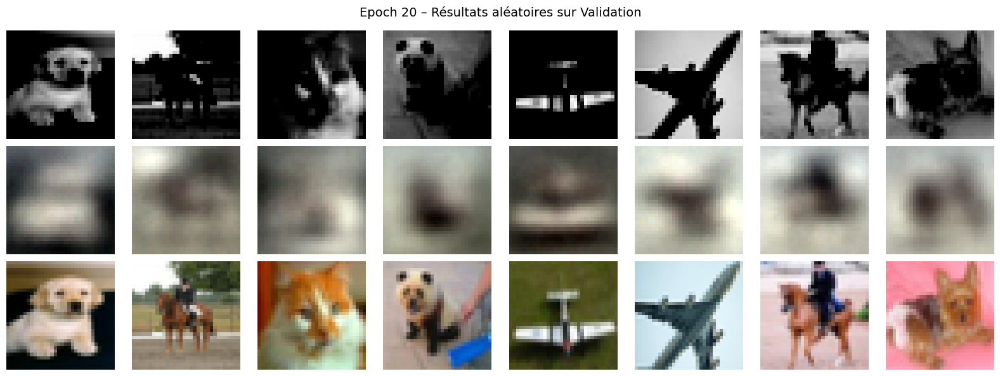

Epoch 21/350 | Train Loss: 104.398375 | Val Loss: 101.650947
✅ Nouveau meilleur modèle sauvegardé à epoch 21 (val_loss = 101.650947)
Epoch 22/350 | Train Loss: 101.411494 | Val Loss: 98.781183
✅ Nouveau meilleur modèle sauvegardé à epoch 22 (val_loss = 98.781183)
Epoch 23/350 | Train Loss: 98.130306 | Val Loss: 95.857033
✅ Nouveau meilleur modèle sauvegardé à epoch 23 (val_loss = 95.857033)
Epoch 24/350 | Train Loss: 95.298553 | Val Loss: 93.303472
✅ Nouveau meilleur modèle sauvegardé à epoch 24 (val_loss = 93.303472)
Epoch 25/350 | Train Loss: 92.156970 | Val Loss: 90.710190
✅ Nouveau meilleur modèle sauvegardé à epoch 25 (val_loss = 90.710190)
Epoch 26/350 | Train Loss: 89.643576 | Val Loss: 88.296052
✅ Nouveau meilleur modèle sauvegardé à epoch 26 (val_loss = 88.296052)
Epoch 27/350 | Train Loss: 87.300345 | Val Loss: 86.308955
✅ Nouveau meilleur modèle sauvegardé à epoch 27 (val_loss = 86.308955)
Epoch 28/350 | Train Loss: 85.337195 | Val Loss: 84.370257
✅ Nouveau meilleur modèle s

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5905628..0.91243726].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8939863..0.56623966].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.4676451..0.46846864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99990004..0.8809478].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.95284593..0.99755573].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9601321..0.8014482].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.

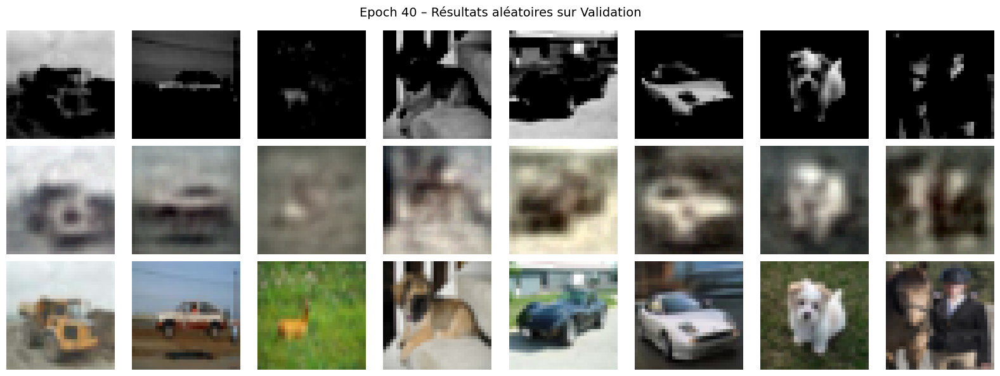

Epoch 41/350 | Train Loss: 65.529058 | Val Loss: 69.726702
✅ Nouveau meilleur modèle sauvegardé à epoch 41 (val_loss = 69.726702)
Epoch 42/350 | Train Loss: 64.181536 | Val Loss: 69.391109
✅ Nouveau meilleur modèle sauvegardé à epoch 42 (val_loss = 69.391109)
Epoch 43/350 | Train Loss: 62.814769 | Val Loss: 68.959441
✅ Nouveau meilleur modèle sauvegardé à epoch 43 (val_loss = 68.959441)
Epoch 44/350 | Train Loss: 62.102506 | Val Loss: 68.543144
✅ Nouveau meilleur modèle sauvegardé à epoch 44 (val_loss = 68.543144)
Epoch 45/350 | Train Loss: 61.454548 | Val Loss: 68.021722
✅ Nouveau meilleur modèle sauvegardé à epoch 45 (val_loss = 68.021722)
Epoch 46/350 | Train Loss: 60.373793 | Val Loss: 67.707129
✅ Nouveau meilleur modèle sauvegardé à epoch 46 (val_loss = 67.707129)
Epoch 47/350 | Train Loss: 59.433829 | Val Loss: 67.264374
✅ Nouveau meilleur modèle sauvegardé à epoch 47 (val_loss = 67.264374)
Epoch 48/350 | Train Loss: 58.464540 | Val Loss: 66.647478
✅ Nouveau meilleur modèle sauve

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.67285216..0.53396755].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9981118..0.8961879].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.77741295..0.77840674].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.78550863..0.78206635].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7821871..0.73637766].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.97837925..0.99116355].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [

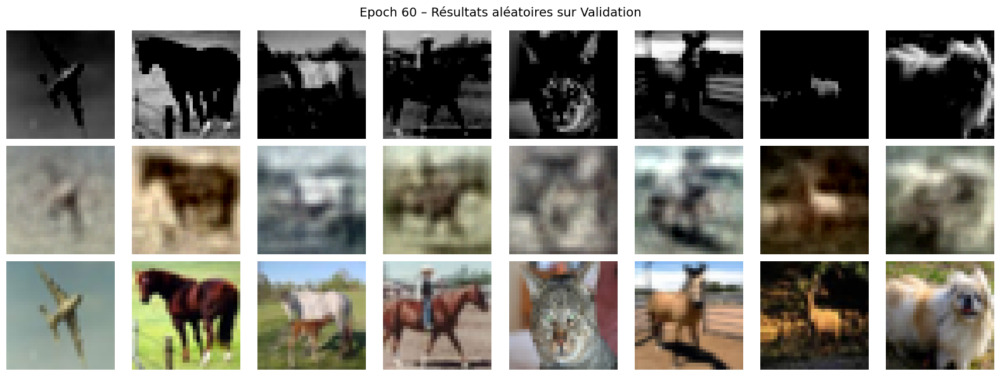

Epoch 61/350 | Train Loss: 51.673606 | Val Loss: 64.265020
✅ Nouveau meilleur modèle sauvegardé à epoch 61 (val_loss = 64.265020)
Epoch 62/350 | Train Loss: 51.457952 | Val Loss: 64.081532
✅ Nouveau meilleur modèle sauvegardé à epoch 62 (val_loss = 64.081532)
Epoch 63/350 | Train Loss: 50.794683 | Val Loss: 64.037025
✅ Nouveau meilleur modèle sauvegardé à epoch 63 (val_loss = 64.037025)
Epoch 64/350 | Train Loss: 50.397404 | Val Loss: 63.834442
✅ Nouveau meilleur modèle sauvegardé à epoch 64 (val_loss = 63.834442)
Epoch 65/350 | Train Loss: 50.015814 | Val Loss: 63.809459
✅ Nouveau meilleur modèle sauvegardé à epoch 65 (val_loss = 63.809459)
Epoch 66/350 | Train Loss: 49.858368 | Val Loss: 63.976807
Epoch 67/350 | Train Loss: 49.471803 | Val Loss: 63.653413
✅ Nouveau meilleur modèle sauvegardé à epoch 67 (val_loss = 63.653413)
Epoch 68/350 | Train Loss: 49.312312 | Val Loss: 63.699639
Epoch 69/350 | Train Loss: 49.080537 | Val Loss: 63.544558
✅ Nouveau meilleur modèle sauvegardé à epoc

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.853831..0.9762882].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6327597..0.36578164].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9875024..0.99721766].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6726968..0.9751408].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99990004..0.6192326].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.873929..0.69192195].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999

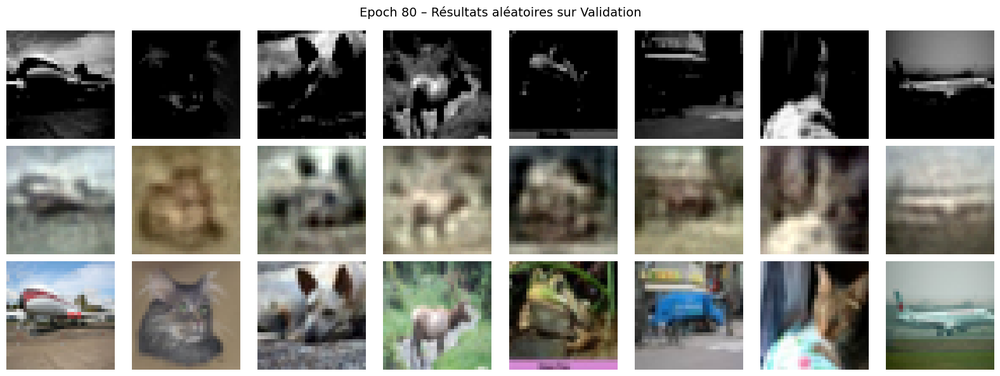

Epoch 81/350 | Train Loss: 45.295557 | Val Loss: 63.046944
Epoch 82/350 | Train Loss: 45.266494 | Val Loss: 63.017014
Epoch 83/350 | Train Loss: 45.346358 | Val Loss: 62.553816
✅ Nouveau meilleur modèle sauvegardé à epoch 83 (val_loss = 62.553816)
Epoch 84/350 | Train Loss: 45.275881 | Val Loss: 62.700414
Epoch 85/350 | Train Loss: 44.493793 | Val Loss: 62.429143
✅ Nouveau meilleur modèle sauvegardé à epoch 85 (val_loss = 62.429143)
Epoch 86/350 | Train Loss: 44.339317 | Val Loss: 62.435766
Epoch 87/350 | Train Loss: 44.287477 | Val Loss: 62.414480
✅ Nouveau meilleur modèle sauvegardé à epoch 87 (val_loss = 62.414480)
Epoch 88/350 | Train Loss: 43.945953 | Val Loss: 62.607523
Epoch 89/350 | Train Loss: 43.736070 | Val Loss: 62.458405
Epoch 90/350 | Train Loss: 43.172048 | Val Loss: 62.200702
✅ Nouveau meilleur modèle sauvegardé à epoch 90 (val_loss = 62.200702)
Epoch 91/350 | Train Loss: 42.913178 | Val Loss: 62.259664
Epoch 92/350 | Train Loss: 42.779101 | Val Loss: 62.354875
Epoch 93

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8901792..0.78816205].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.680031..0.6296828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8591605..0.9990059].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.72184116..0.99990004].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99990004..0.56666315].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.79970866..0.9990059].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9

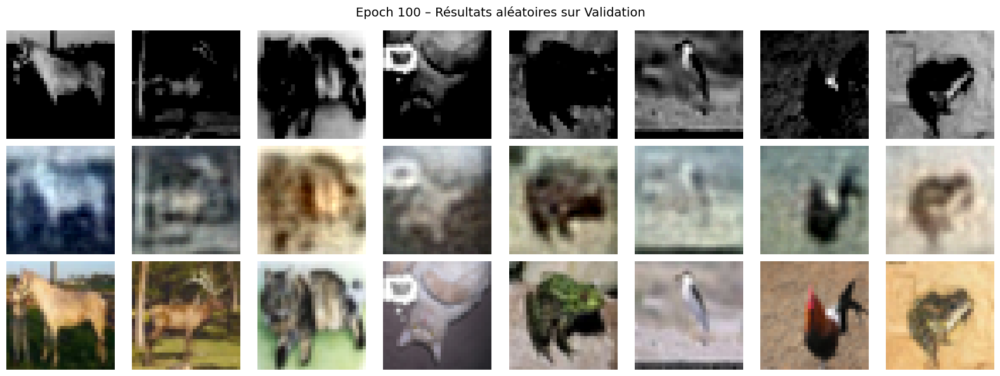

KeyboardInterrupt: 

In [108]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Dataset, Subset, random_split
import matplotlib.pyplot as plt
from geomloss import SamplesLoss

# ----- Initialisation -----
def init_W(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim, in_dim) - k

def init_b(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim,) - k

class CascadeGradNet(nn.Module):
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()
        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])
        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(init_b(embed_dim, embed_dim), requires_grad=True) for _ in range(num_layers+1)])
        self.bias[0] = nn.Parameter(init_b(embed_dim, in_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(init_b(in_dim, embed_dim), requires_grad=True)
        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1,-1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i+1].view(1,-1) * F.linear(x, self.W, self.bias[i+1])
            z = skip + self.alpha[i].view(1,-1) * self.nonlinearity[i](z)
        z = self.alpha[-1].view(1,-1) * self.nonlinearity[-1](z)
        z = F.linear(z, self.W.T, self.bias[-1])
        return z

# ----- Dataset personnalisé -----
class GrayscaleToColorDataset(Dataset):
    def __init__(self, dataset):
        self.dataset = dataset
        self.to_grayscale = transforms.Grayscale(num_output_channels=1)
    def __len__(self):
        return len(self.dataset)
    def __getitem__(self, idx):
        color_img, _ = self.dataset[idx]
        gray_img = self.to_grayscale(color_img)
        gray_img = gray_img.expand(3, -1, -1).contiguous()
        return gray_img.reshape(-1), color_img.contiguous().reshape(-1)

# ----- Préparation CIFAR10 -----
data_root = "./data_cifar10"
image_size = 32
subset_size = 5000

transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

full_dataset = datasets.CIFAR10(root=data_root, train=True, download=True, transform=transform)
indices = np.random.choice(len(full_dataset), subset_size, replace=False)
dataset = Subset(full_dataset, indices)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_subset, val_subset = random_split(dataset, [train_size, val_size])
train_dataset = GrayscaleToColorDataset(train_subset)
val_dataset = GrayscaleToColorDataset(val_subset)

train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False)

# ----- Initialisation du modèle -----
input_dim = image_size * image_size * 3
generator = CascadeGradNet(num_layers=24, in_dim=input_dim, embed_dim=512, activation=nn.Tanh)
optimizer = torch.optim.Adam(generator.parameters(), lr=5e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.03)

# ----- Entraînement -----
num_epochs = 350
best_val_loss = float("inf")
train_losses = []
val_losses = []
model_path = "best_generator.pt"

for epoch in range(num_epochs):
    generator.train()
    total_loss = 0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        output = generator(x_batch)
        loss = loss_fn(output, y_batch)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    scheduler.step()

    avg_train_loss = total_loss / len(train_loader)
    train_losses.append(avg_train_loss)

    # Validation
    generator.eval()
    total_val_loss = 0
    with torch.no_grad():
        for x_val, y_val in val_loader:
            val_output = generator(x_val)
            val_loss = loss_fn(val_output, y_val)
            total_val_loss += val_loss.item()
    avg_val_loss = total_val_loss / len(val_loader)
    val_losses.append(avg_val_loss)

    print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_train_loss:.6f} | Val Loss: {avg_val_loss:.6f}")

    # Sauvegarde si meilleur modèle
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(generator.state_dict(), model_path)
        print(f"✅ Nouveau meilleur modèle sauvegardé à epoch {epoch+1} (val_loss = {best_val_loss:.6f})")

    # 🔄 Affichage tous les 20 epochs
    if (epoch + 1) % 20 == 0 or epoch == num_epochs:
        generator.eval()
        with torch.no_grad():
            val_indices = np.random.choice(len(val_dataset), size=8, replace=False)
            samples = [val_dataset[i] for i in val_indices]
            sample_input = torch.stack([s[0] for s in samples])
            sample_target = torch.stack([s[1] for s in samples])
            sample_output = generator(sample_input)

            fig, axes = plt.subplots(3, 8, figsize=(16, 6))
            for i in range(8):
                img_input = sample_input[i].view(3, image_size, image_size).permute(1, 2, 0).cpu().numpy()
                img_output = sample_output[i].view(3, image_size, image_size).permute(1, 2, 0).cpu().numpy() * 0.5 + 0.5
                img_target = sample_target[i].view(3, image_size, image_size).permute(1, 2, 0).cpu().numpy() * 0.5 + 0.5

                axes[0, i].imshow(img_input, cmap="gray")
                axes[1, i].imshow(np.clip(img_output, 0, 1))
                axes[2, i].imshow(np.clip(img_target, 0, 1))

                for row in range(3):
                    axes[row, i].axis("off")

            axes[0, 0].set_ylabel("Noir & Blanc", fontsize=12)
            axes[1, 0].set_ylabel("Généré", fontsize=12)
            axes[2, 0].set_ylabel("Réel", fontsize=12)
            plt.suptitle(f"Epoch {epoch+1} – Résultats aléatoires sur Validation", fontsize=14)
            plt.tight_layout()
            plt.show()

# ----- Courbes de perte -----
plt.figure(figsize=(10, 5))
plt.plot(range(1, num_epochs + 1), train_losses, label="Train Loss")
plt.plot(range(1, num_epochs + 1), val_losses, label="Validation Loss")
plt.xlabel("Épochs")
plt.ylabel("Loss")
plt.title("Courbes de perte (Train vs Validation)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()



In [3]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Dataset, Subset, random_split
import matplotlib.pyplot as plt
from geomloss import SamplesLoss

# ----- Initialisation -----
def init_W(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim, in_dim) - k

def init_b(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim,) - k

class CascadeGradNet(nn.Module):
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()
        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])
        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(init_b(embed_dim, embed_dim), requires_grad=True) for _ in range(num_layers+1)])
        self.bias[0] = nn.Parameter(init_b(embed_dim, in_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(init_b(in_dim, embed_dim), requires_grad=True)
        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1,-1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i+1].view(1,-1) * F.linear(x, self.W, self.bias[i+1])
            z = skip + self.alpha[i].view(1,-1) * self.nonlinearity[i](z)
        z = self.alpha[-1].view(1,-1) * self.nonlinearity[-1](z)
        z = F.linear(z, self.W.T, self.bias[-1])
        return z

# ----- Dataset personnalisé -----
class GrayscaleToColorDataset(Dataset):
    def __init__(self, dataset):
        self.dataset = dataset
        self.to_grayscale = transforms.Grayscale(num_output_channels=1)
    def __len__(self):
        return len(self.dataset)
    def __getitem__(self, idx):
        color_img, _ = self.dataset[idx]
        gray_img = self.to_grayscale(color_img)
        gray_img = gray_img.expand(3, -1, -1).contiguous()
        return gray_img.reshape(-1), color_img.contiguous().reshape(-1)

# ----- Préparation CIFAR10 -----
data_root = "./data_cifar10"
image_size = 32
subset_size = 5000

transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

full_dataset = datasets.CIFAR10(root=data_root, train=True, download=True, transform=transform)
indices = np.random.choice(len(full_dataset), subset_size, replace=False)
dataset = Subset(full_dataset, indices)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_subset, val_subset = random_split(dataset, [train_size, val_size])
train_dataset = GrayscaleToColorDataset(train_subset)
val_dataset = GrayscaleToColorDataset(val_subset)

train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False)

# ----- Initialisation du modèle -----
input_dim = image_size * image_size * 3
generator = CascadeGradNet(num_layers=24, in_dim=input_dim, embed_dim=512, activation=nn.Tanh)
optimizer = torch.optim.Adam(generator.parameters(), lr=5e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.03)

# ----- Entraînement -----
num_epochs = 350
best_val_loss = float("inf")
train_losses = []
val_losses = []
model_path = "best_generator.pt"

for epoch in range(num_epochs):
    generator.train()
    total_loss = 0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        output = generator(x_batch)
        loss = loss_fn(output, y_batch)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    scheduler.step()

    avg_train_loss = total_loss / len(train_loader)
    train_losses.append(avg_train_loss)

    # Validation
    generator.eval()
    total_val_loss = 0
    with torch.no_grad():
        for x_val, y_val in val_loader:
            val_output = generator(x_val)
            val_loss = loss_fn(val_output, y_val)
            total_val_loss += val_loss.item()
    avg_val_loss = total_val_loss / len(val_loader)
    val_losses.append(avg_val_loss)

    print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_train_loss:.6f} | Val Loss: {avg_val_loss:.6f}")

    # Sauvegarde si meilleur modèle
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(generator.state_dict(), model_path)
        print(f"✅ Nouveau meilleur modèle sauvegardé à epoch {epoch+1} (val_loss = {best_val_loss:.6f})")

    # 🔄 Affichage tous les 20 epochs
    if (epoch + 1) % 20 == 0 or epoch == num_epochs:
        generator.eval()
        with torch.no_grad():
            val_indices = np.random.choice(len(val_dataset), size=8, replace=False)
            samples = [val_dataset[i] for i in val_indices]
            sample_input = torch.stack([s[0] for s in samples])
            sample_target = torch.stack([s[1] for s in samples])
            sample_output = generator(sample_input)

            fig, axes = plt.subplots(3, 8, figsize=(16, 6))
            for i in range(8):
                img_input = sample_input[i].view(3, image_size, image_size).permute(1, 2, 0).cpu().numpy()
                img_output = sample_output[i].view(3, image_size, image_size).permute(1, 2, 0).cpu().numpy() * 0.5 + 0.5
                img_target = sample_target[i].view(3, image_size, image_size).permute(1, 2, 0).cpu().numpy() * 0.5 + 0.5

                axes[0, i].imshow(img_input, cmap="gray")
                axes[1, i].imshow(np.clip(img_output, 0, 1))
                axes[2, i].imshow(np.clip(img_target, 0, 1))

                for row in range(3):
                    axes[row, i].axis("off")

            axes[0, 0].set_ylabel("Noir & Blanc", fontsize=12)
            axes[1, 0].set_ylabel("Généré", fontsize=12)
            axes[2, 0].set_ylabel("Réel", fontsize=12)
            plt.suptitle(f"Epoch {epoch+1} – Résultats aléatoires sur Validation", fontsize=14)
            plt.tight_layout()
            plt.show()

# ----- Courbes de perte -----
plt.figure(figsize=(10, 5))
plt.plot(range(1, num_epochs + 1), train_losses, label="Train Loss")
plt.plot(range(1, num_epochs + 1), val_losses, label="Validation Loss")
plt.xlabel("Épochs")
plt.ylabel("Loss")
plt.title("Courbes de perte (Train vs Validation)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()



Files already downloaded and verified
Epoch 1/350 | Train Loss: 314.979113 | Val Loss: 291.999592
✅ Nouveau meilleur modèle sauvegardé à epoch 1 (val_loss = 291.999592)
Epoch 2/350 | Train Loss: 272.706867 | Val Loss: 266.452454
✅ Nouveau meilleur modèle sauvegardé à epoch 2 (val_loss = 266.452454)
Epoch 3/350 | Train Loss: 257.090298 | Val Loss: 244.941040
✅ Nouveau meilleur modèle sauvegardé à epoch 3 (val_loss = 244.941040)
Epoch 4/350 | Train Loss: 237.628770 | Val Loss: 235.378485
✅ Nouveau meilleur modèle sauvegardé à epoch 4 (val_loss = 235.378485)
Epoch 5/350 | Train Loss: 235.421764 | Val Loss: 229.451727
✅ Nouveau meilleur modèle sauvegardé à epoch 5 (val_loss = 229.451727)
Epoch 6/350 | Train Loss: 231.784054 | Val Loss: 229.954182
Epoch 7/350 | Train Loss: 230.253884 | Val Loss: 226.753687
✅ Nouveau meilleur modèle sauvegardé à epoch 7 (val_loss = 226.753687)
Epoch 8/350 | Train Loss: 227.570704 | Val Loss: 224.761707
✅ Nouveau meilleur modèle sauvegardé à epoch 8 (val_loss

KeyboardInterrupt: 

###### bon code colorized

In [2]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Dataset, Subset
import matplotlib.pyplot as plt
from geomloss import SamplesLoss  # Optimal Transport (Sinkhorn Loss)

# ----- 📌 Initialisation -----
def init_W(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim, in_dim) - k

def init_b(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim,) - k

# ----- 🔥 CascadeGradNet -----
class CascadeGradNet(nn.Module):
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()
        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])
        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(init_b(embed_dim, embed_dim), requires_grad=True) for _ in range(num_layers+1)])
        self.bias[0] = nn.Parameter(init_b(embed_dim, in_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(init_b(in_dim, embed_dim), requires_grad=True)
        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1,-1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i+1].view(1,-1) * F.linear(x, self.W, self.bias[i+1])
            z = skip + self.alpha[i].view(1,-1) * self.nonlinearity[i](z)
        z = self.alpha[-1].view(1,-1) * self.nonlinearity[-1](z)
        z = F.linear(z, self.W.T, self.bias[-1])
        return z

# ----- 📂 Chargement d'un SOUS-ÉCHANTILLON de CIFAR-10 -----
data_root = "./data_cifar10"
image_size = 32  # Taille CIFAR-10
num_channels = 3  # RGB
subset_size = 5000  # ⚠️ Réduction à 5000 images au lieu de 50 000

transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # Normalisation
])

# Charger CIFAR-10
full_dataset = datasets.CIFAR10(root=data_root, train=True, download=True, transform=transform)

# 📌 Prendre un SOUS-ÉCHANTILLON aléatoire de 5000 images
indices = np.random.choice(len(full_dataset), subset_size, replace=False)
dataset = Subset(full_dataset, indices)

# 📌 Séparer Train / Validation (80% - 20%)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

# ----- 🎨 Convertir en noir et blanc et FORCER 3 CANAUX -----
class GrayscaleToColorDataset(Dataset):
    def __init__(self, dataset):
        self.dataset = dataset
        self.to_grayscale = transforms.Grayscale(num_output_channels=1)  # Convertir en niveaux de gris
    
    def __len__(self):
        return len(self.dataset)
    
    def __getitem__(self, idx):
        color_img, label = self.dataset[idx]  # Image couleur et label
        gray_img = self.to_grayscale(color_img)  # Convertir en noir et blanc
        
        # ✅ DUPLIQUER L'IMAGE NOIR & BLANC SUR 3 CANAUX (corrige l'erreur)
        gray_img = gray_img.expand(3, -1, -1)  # Copie les valeurs sur 3 canaux
        
        return gray_img.view(-1), color_img.view(-1)  # (Entrée 3 canaux, Cible Couleur)

# Appliquer la transformation
train_dataset = GrayscaleToColorDataset(train_dataset)
val_dataset = GrayscaleToColorDataset(val_dataset)

# 📌 DataLoaders
batch_size = 128
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# ----- 🔥 Initialisation du Modèle -----
input_dim = image_size * image_size * 3  # Entrée = 3 canaux (corrigé)
output_dim = image_size * image_size * 3  # Sortie = 3 canaux

generator = CascadeGradNet(num_layers=6, in_dim=input_dim, embed_dim=512, activation=nn.Tanh)
optimizer = torch.optim.Adam(generator.parameters(), lr=5e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)
loss_fn = SamplesLoss("sinkhorn", p=2, blur=0.03)  # Transport Optimal

# ----- 🚀 Entraînement -----
num_epochs = 100
for epoch in range(num_epochs):
    generator.train()
    total_loss = 0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        output = generator(x_batch)
        loss = loss_fn(output, y_batch)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    scheduler.step()

    print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {total_loss/len(train_loader):.6f}")

    # 🔄 Affichage tous les 20 epochs sur validation
    if (epoch + 1) % 20 == 0 or epoch == num_epochs - 1:
        generator.eval()
        with torch.no_grad():
            sample_input, sample_target = next(iter(val_loader))
            sample_output = generator(sample_input[:8])

            # 🔥 Affichage avant/après
            fig, axes = plt.subplots(3, len(sample_input[:8]), figsize=(len(sample_input[:8]) * 2, 6))
            for i in range(len(sample_input[:8])):
                axes[0, i].imshow(sample_input[i].view(3, image_size, image_size).permute(1, 2, 0).cpu().numpy(), cmap="gray")
                axes[1, i].imshow(sample_output[i].view(3, image_size, image_size).permute(1, 2, 0).cpu().numpy() * 0.5 + 0.5)
                axes[2, i].imshow(sample_target[i].view(3, image_size, image_size).permute(1, 2, 0).cpu().numpy() * 0.5 + 0.5)
                axes[0, i].axis("off")
                axes[1, i].axis("off")
                axes[2, i].axis("off")

            axes[0, 0].set_ylabel("Noir & Blanc", fontsize=12)
            axes[1, 0].set_ylabel("Généré", fontsize=12)
            axes[2, 0].set_ylabel("Réel", fontsize=12)
            plt.suptitle(f"Epoch {epoch+1} - Noir & Blanc → Couleur", fontsize=14)
            plt.show()


Files already downloaded and verified


RuntimeError: view size is not compatible with input tensor's size and stride (at least one dimension spans across two contiguous subspaces). Use .reshape(...) instead.

#### test transfert couleur

In [119]:
!pip install lpips

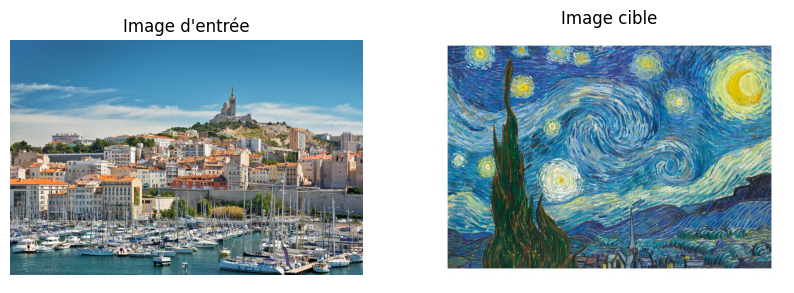

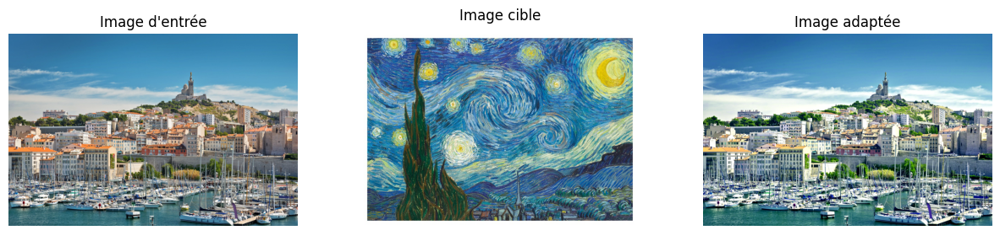

In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import cv2
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt

# Initialisation des poids et biais
def init_W(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim, in_dim) - k

def init_b(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim,) - k

# Définition du modèle CascadeGradNet
class CascadeGradNet(nn.Module):
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()
        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])

        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(init_b(embed_dim, embed_dim), requires_grad=True) for _ in range(num_layers+1)])
        self.bias[0] = nn.Parameter(init_b(embed_dim, in_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(init_b(in_dim, embed_dim), requires_grad=True)

        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim)-0.5, requires_grad=True) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1,-1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i+1].view(1,-1) * F.linear(x, self.W, self.bias[i+1])
            z = skip + self.alpha[i].view(1,-1) * self.nonlinearity[i](z)

        z = self.alpha[-1].view(1,-1) * self.nonlinearity[i](z)
        z = F.linear(z, self.W.T, self.bias[-1])

        return z

# Chargement des images
def load_image(path):
    image = Image.open(path).convert("RGB")
    transform = transforms.Compose([
        transforms.ToTensor()
    ])
    return transform(image).permute(1, 2, 0)  # Convertir en format (H, W, C)

target_image = load_image("./data/starry.jpg")
input_image = load_image("./data/marseille.jpeg")

# Affichage des images de départ
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(input_image)
ax[0].set_title("Image d'entrée")
ax[0].axis("off")

ax[1].imshow(target_image)
ax[1].set_title("Image cible")
ax[1].axis("off")

plt.show()

# Adaptation des couleurs en utilisant une distribution gaussienne
def match_color_distribution(input_img, target_img):
    input_img = input_img.view(-1, 3)
    target_img = target_img.view(-1, 3)

    # Calcul des moyennes et covariances
    input_mean = input_img.mean(dim=0)
    input_cov = torch.cov(input_img.T)

    target_mean = target_img.mean(dim=0)
    target_cov = torch.cov(target_img.T)

    # Décomposition de Cholesky
    input_eigvals, input_eigvecs = torch.linalg.eigh(input_cov)
    target_eigvals, target_eigvecs = torch.linalg.eigh(target_cov)

    # Transformation des couleurs
    whitening_transform = input_eigvecs @ torch.diag(1.0 / torch.sqrt(input_eigvals)) @ input_eigvecs.T
    coloring_transform = target_eigvecs @ torch.diag(torch.sqrt(target_eigvals)) @ target_eigvecs.T

    transformed_img = (input_img - input_mean) @ whitening_transform @ coloring_transform + target_mean

    # Remettre les valeurs entre 0 et 1
    transformed_img = torch.clamp(transformed_img, 0, 1)
    return transformed_img.view(input_image.shape)

# Appliquer l'adaptation de couleur
adapted_image = match_color_distribution(input_image, target_image)

# Affichage des résultats
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(input_image)
ax[0].set_title("Image d'entrée")
ax[0].axis("off")

ax[1].imshow(target_image)
ax[1].set_title("Image cible")
ax[1].axis("off")

ax[2].imshow(adapted_image)
ax[2].set_title("Image adaptée")
ax[2].axis("off")

plt.show()


Epoch 1/100 - Loss: 0.315860


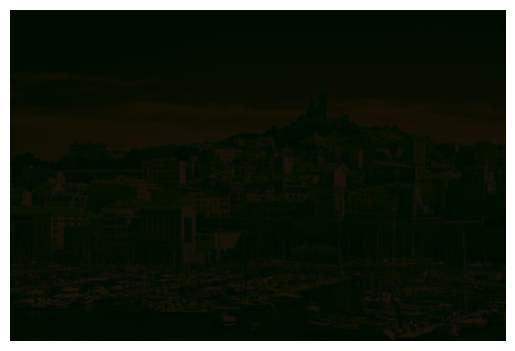

Epoch 2/100 - Loss: 0.310933


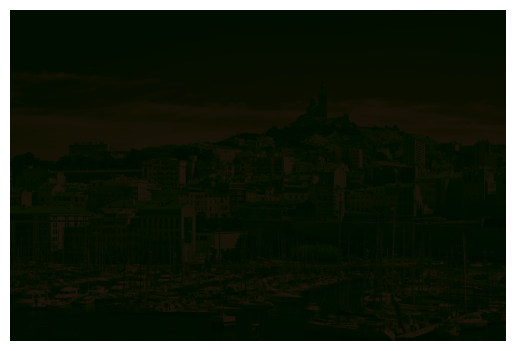

Epoch 3/100 - Loss: 0.306047


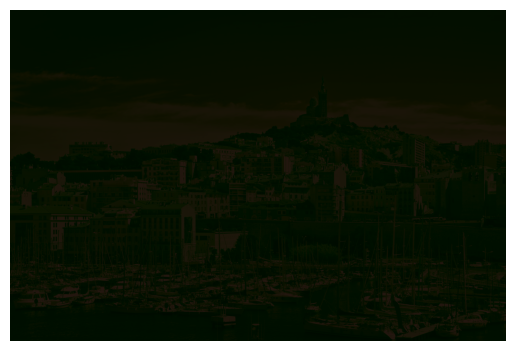

Epoch 4/100 - Loss: 0.301202


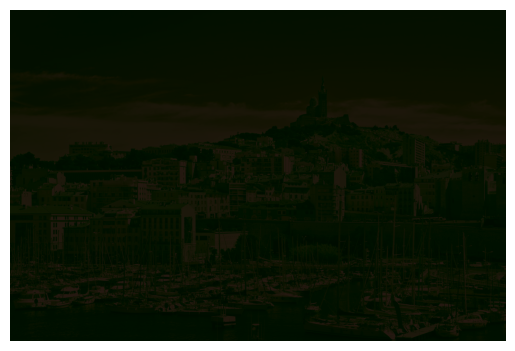

Epoch 5/100 - Loss: 0.296398


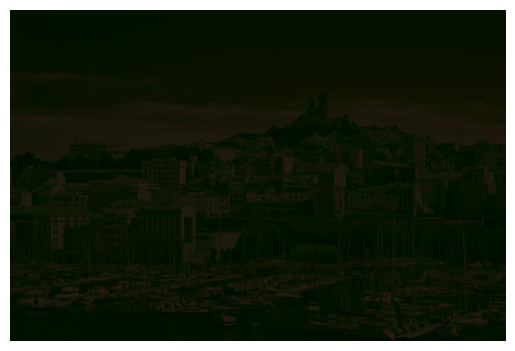

Epoch 6/100 - Loss: 0.291636


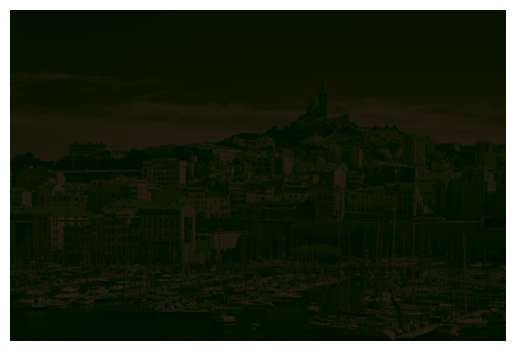

Epoch 7/100 - Loss: 0.286918


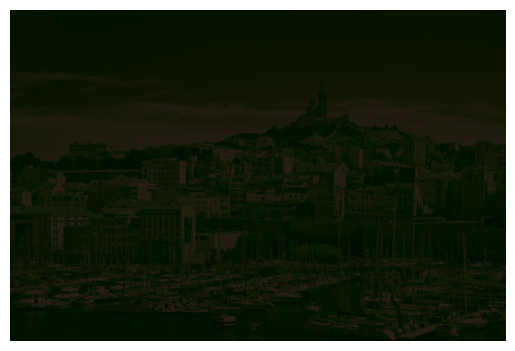

Epoch 8/100 - Loss: 0.282243


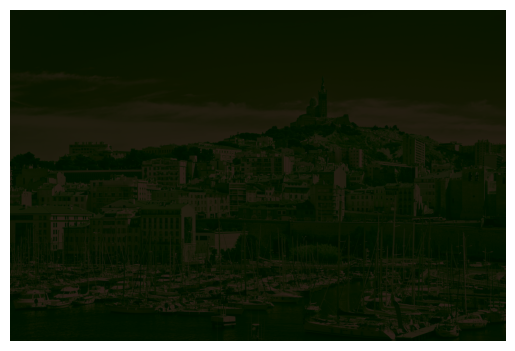

Epoch 9/100 - Loss: 0.277611


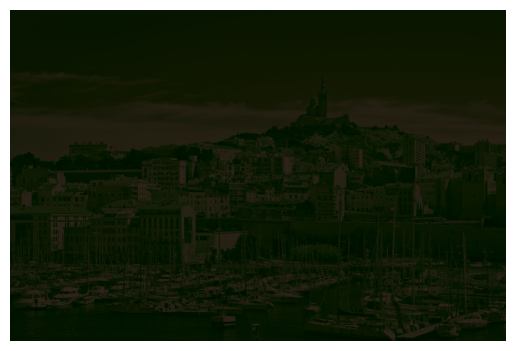

Epoch 10/100 - Loss: 0.273024


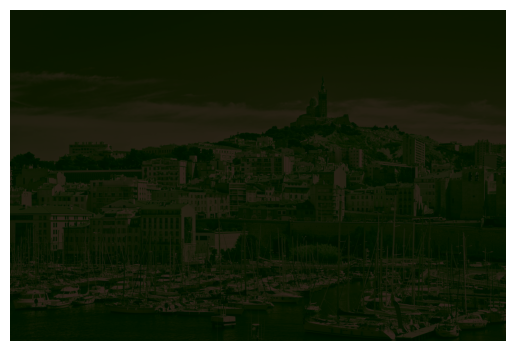

Epoch 11/100 - Loss: 0.268481


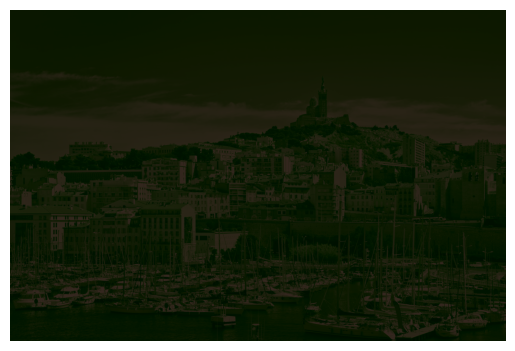

Epoch 12/100 - Loss: 0.263984


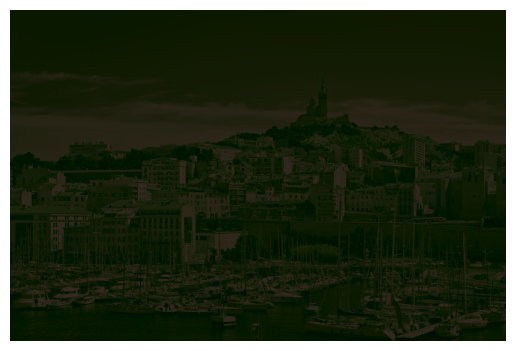

Epoch 13/100 - Loss: 0.259532


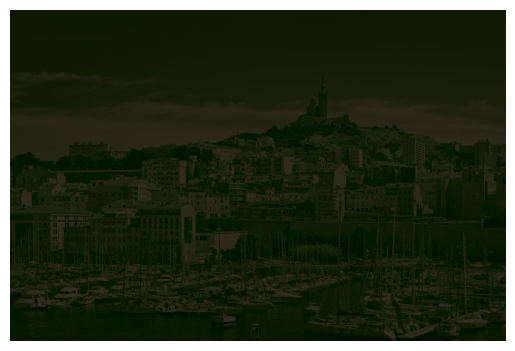

Epoch 14/100 - Loss: 0.255125


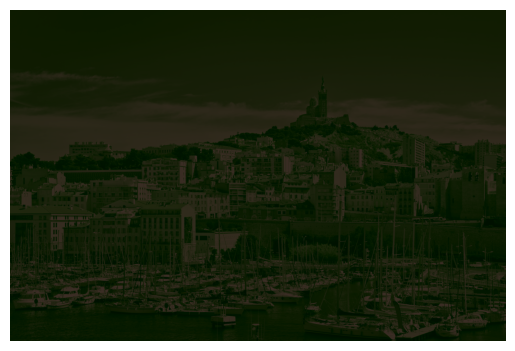

Epoch 15/100 - Loss: 0.250764


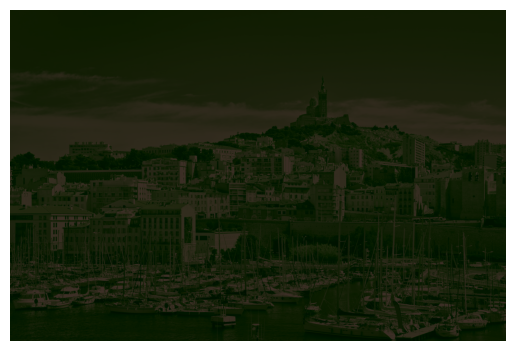

Epoch 16/100 - Loss: 0.246449


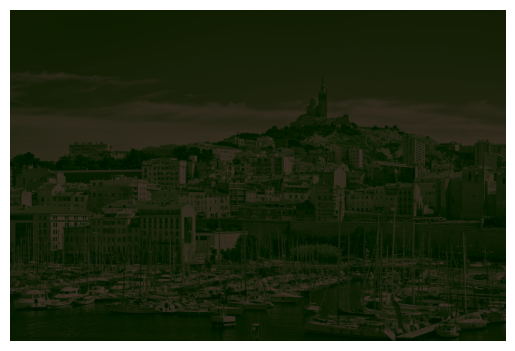

Epoch 17/100 - Loss: 0.242179


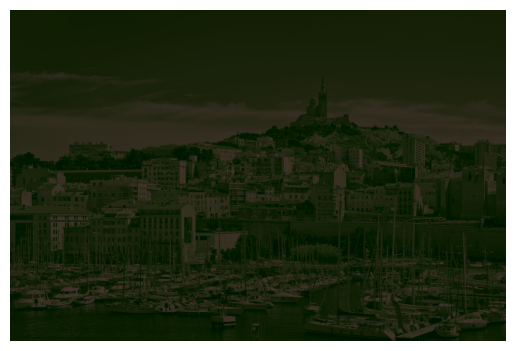

Epoch 18/100 - Loss: 0.237955


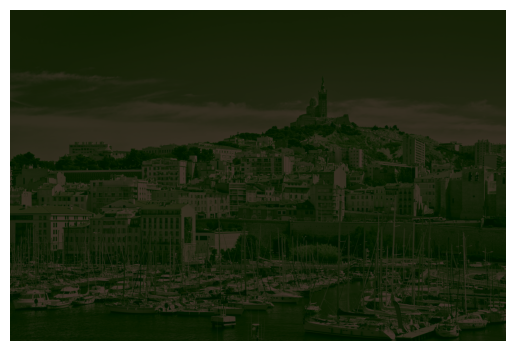

Epoch 19/100 - Loss: 0.233776


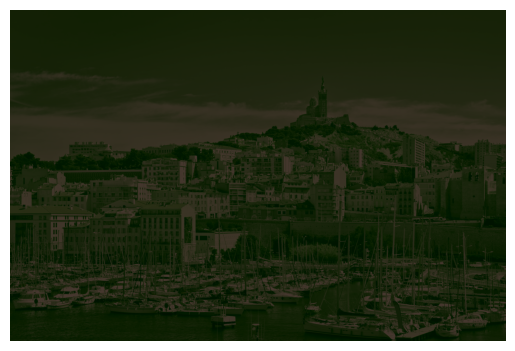

Epoch 20/100 - Loss: 0.229642


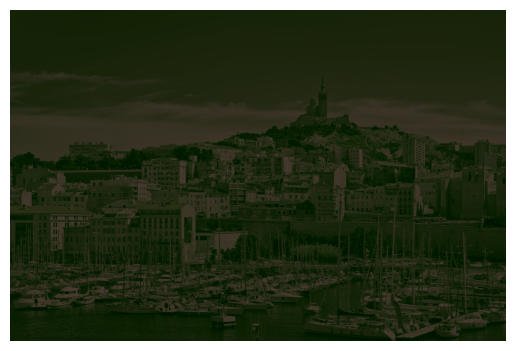

Epoch 21/100 - Loss: 0.225554


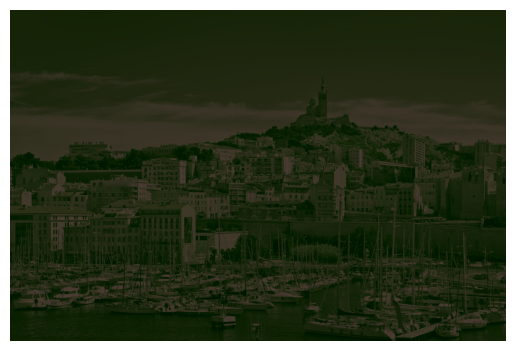

Epoch 22/100 - Loss: 0.221512


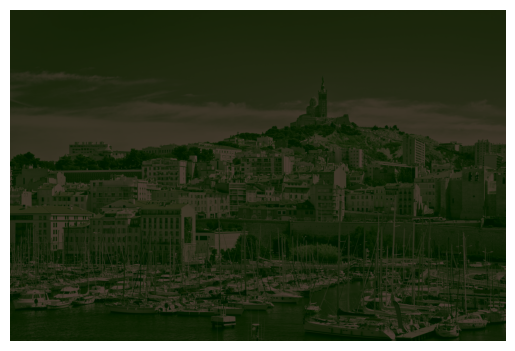

Epoch 23/100 - Loss: 0.217516


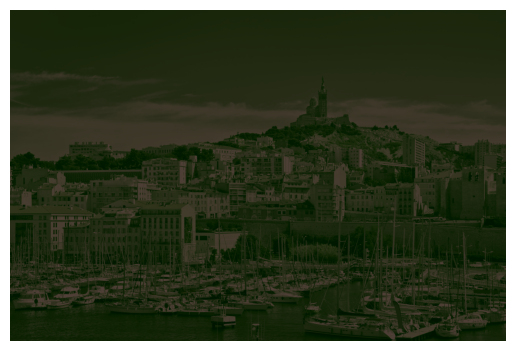

Epoch 24/100 - Loss: 0.213566


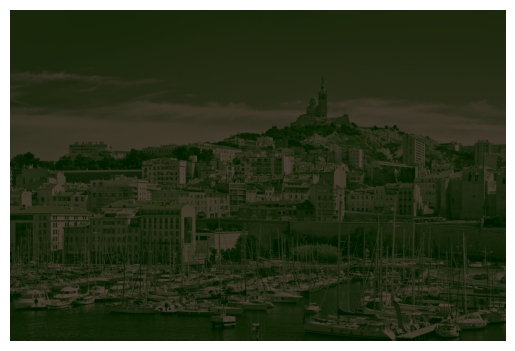

Epoch 25/100 - Loss: 0.209662


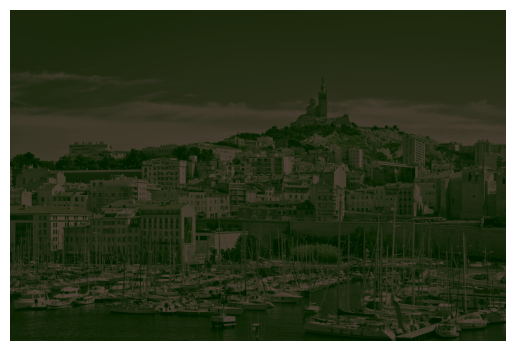

Epoch 26/100 - Loss: 0.205805


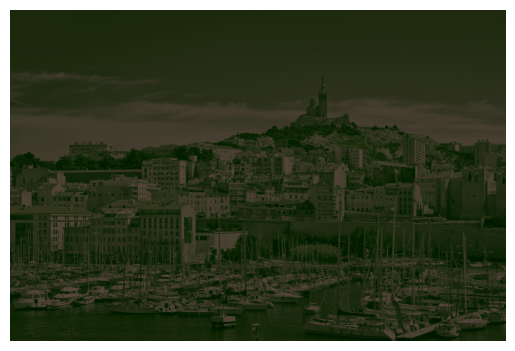

Epoch 27/100 - Loss: 0.201996


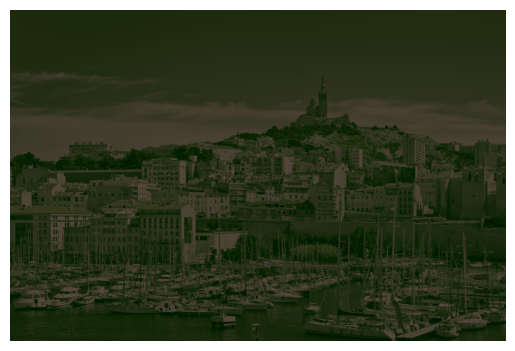

Epoch 28/100 - Loss: 0.198233


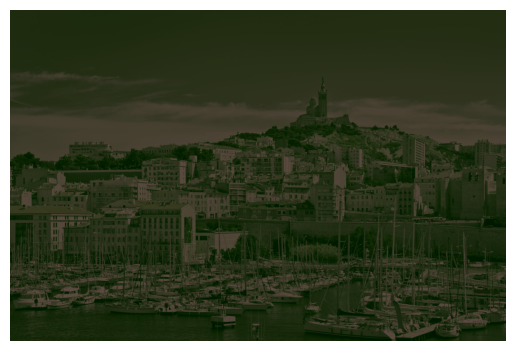

Epoch 29/100 - Loss: 0.194519


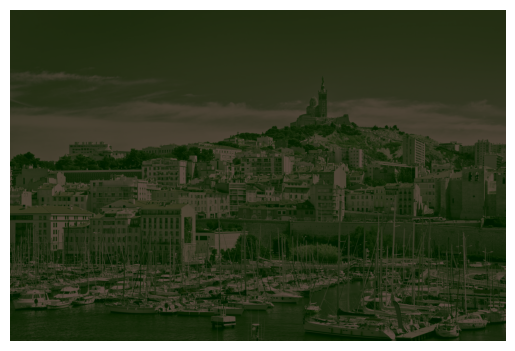

Epoch 30/100 - Loss: 0.190852


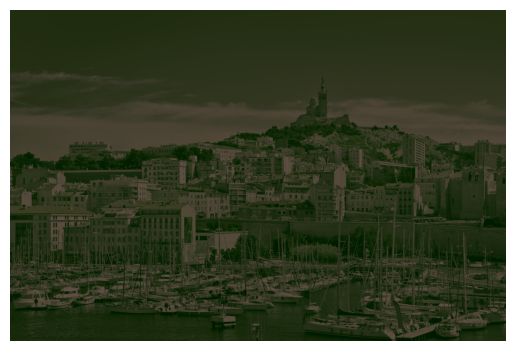

Epoch 31/100 - Loss: 0.187234


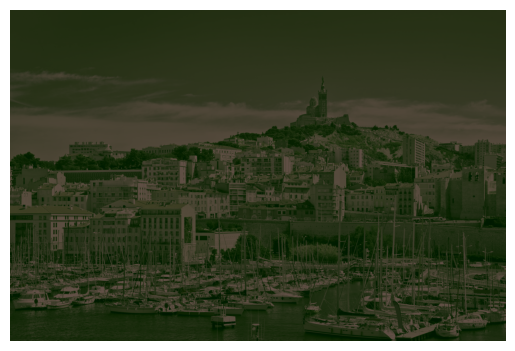

Epoch 32/100 - Loss: 0.183665


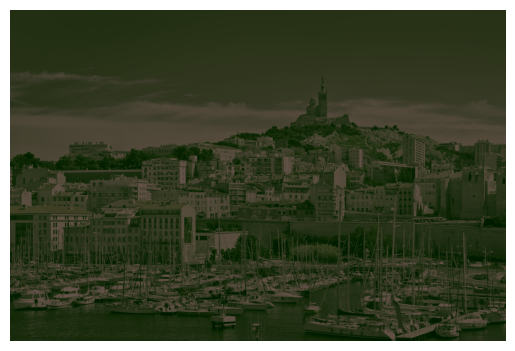

Epoch 33/100 - Loss: 0.180144


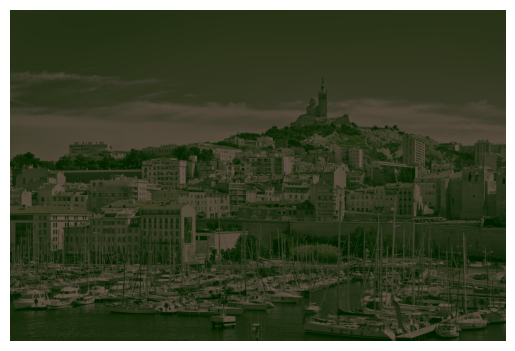

Epoch 34/100 - Loss: 0.176673


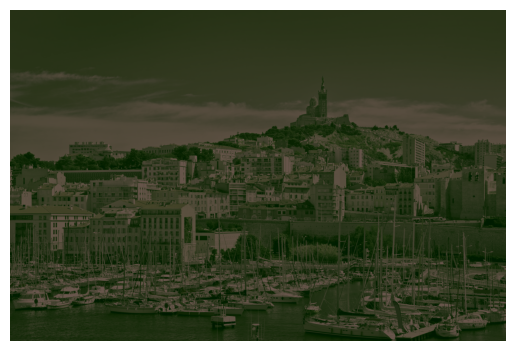

Epoch 35/100 - Loss: 0.173252


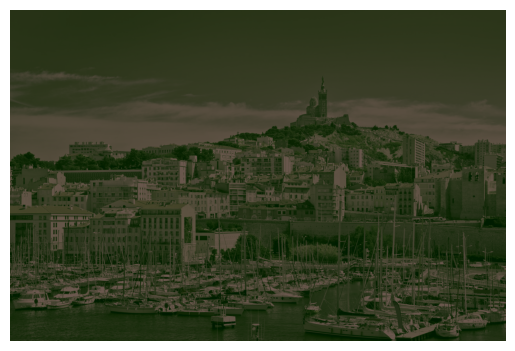

Epoch 36/100 - Loss: 0.169880


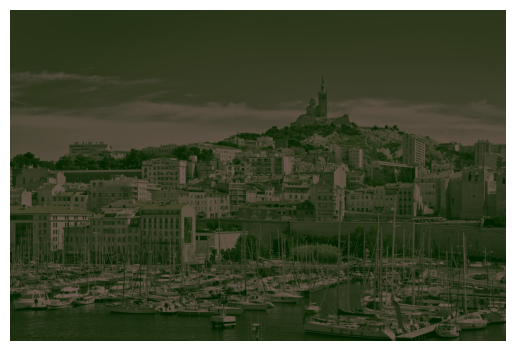

Epoch 37/100 - Loss: 0.166560


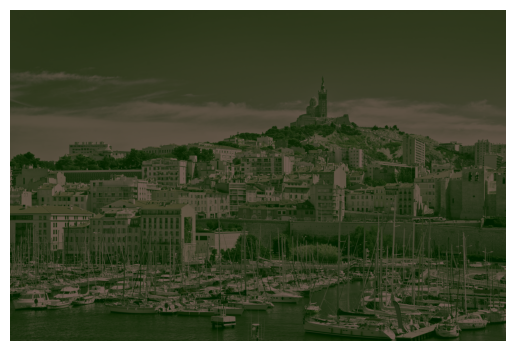

Epoch 38/100 - Loss: 0.163291


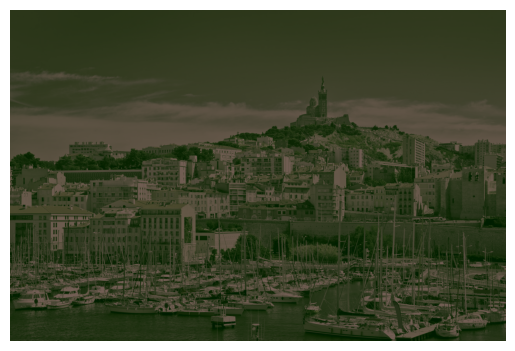

Epoch 39/100 - Loss: 0.160074


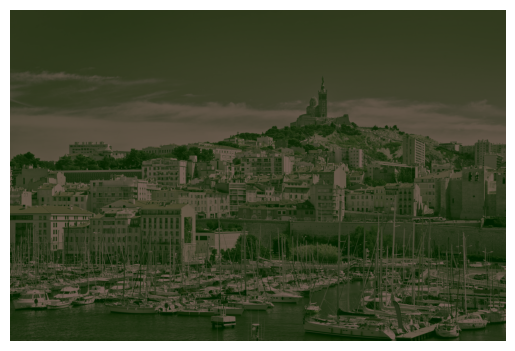

Epoch 40/100 - Loss: 0.156910


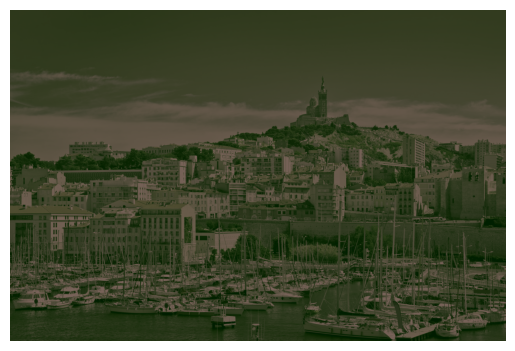

Epoch 41/100 - Loss: 0.153799


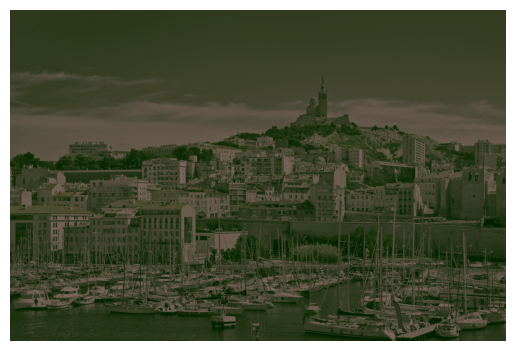

Epoch 42/100 - Loss: 0.150741


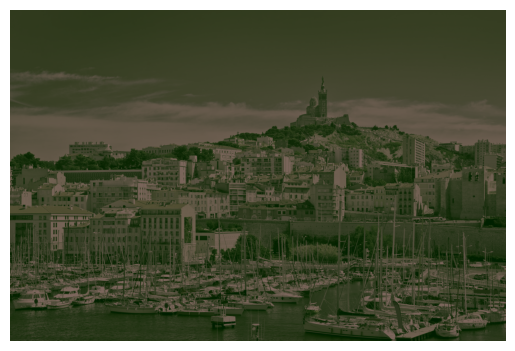

Epoch 43/100 - Loss: 0.147738


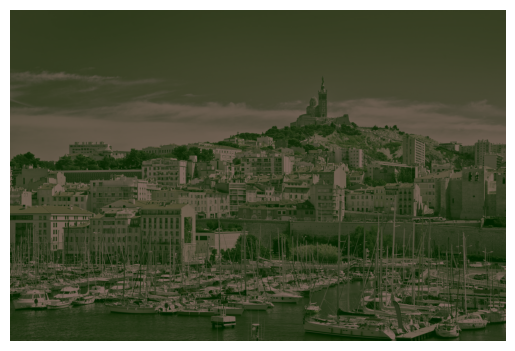

Epoch 44/100 - Loss: 0.144791


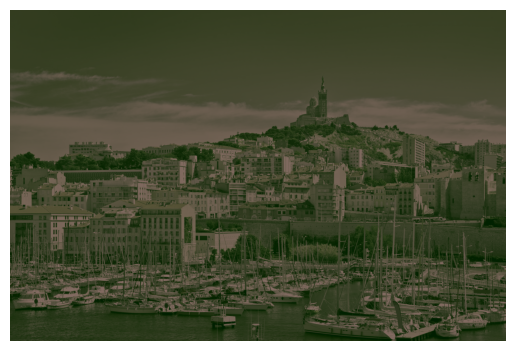

Epoch 45/100 - Loss: 0.141899


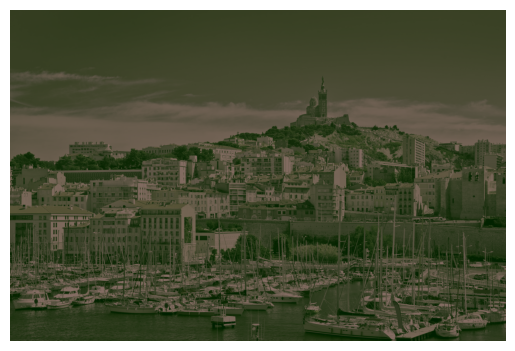

Epoch 46/100 - Loss: 0.139063


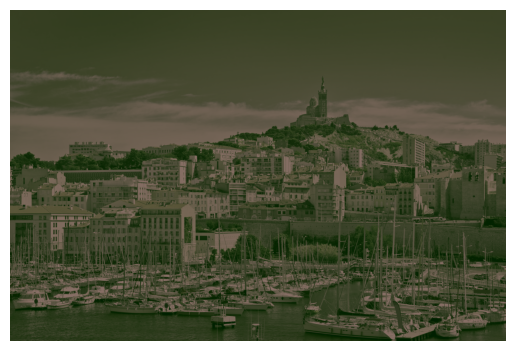

Epoch 47/100 - Loss: 0.136285


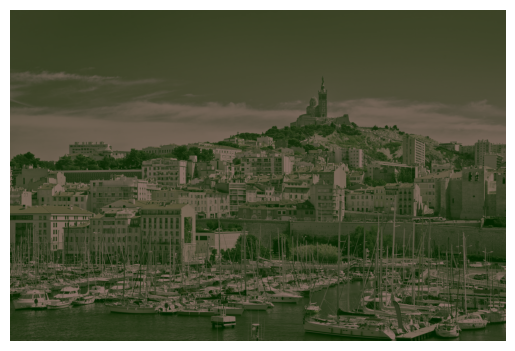

Epoch 48/100 - Loss: 0.133564


KeyboardInterrupt: 

In [40]:
import torch
import torch.nn.functional as F
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torchvision.transforms as T
import random

# ========== Utils from your CascadeGradNet ==========
def init_W(embed_dim, in_dim): 
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim, in_dim) - k

def init_b(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim,) - k

class CascadeGradNet(nn.Module):
    def __init__(self, num_layers, in_dim, embed_dim, activation):
        super().__init__()
        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])
        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(init_b(embed_dim, embed_dim), requires_grad=True) for _ in range(num_layers + 1)])
        self.bias[0] = nn.Parameter(init_b(embed_dim, in_dim), requires_grad=True)
        self.bias[-1] = nn.Parameter(init_b(in_dim, embed_dim), requires_grad=True)
        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim) - 0.5, requires_grad=True) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim) - 0.5, requires_grad=True) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1, -1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i + 1].view(1, -1) * F.linear(x, self.W, self.bias[i + 1])
            z = skip + self.alpha[i].view(1, -1) * self.nonlinearity[i](z)
        z = self.alpha[-1].view(1, -1) * self.nonlinearity[-1](z)
        z = F.linear(z, self.W.T, self.bias[-1])
        return z

# ========== Sample colors ==========
def sample_colors(image_path, n_pixels=10000):
    image = Image.open(image_path).convert('RGB')
    transform = T.Compose([T.ToTensor()])
    img_tensor = transform(image).permute(1, 2, 0).reshape(-1, 3)
    indices = torch.randperm(img_tensor.size(0))[:n_pixels]
    return img_tensor[indices], image.size

# ========== Visualisation ==========
def visualize_transformation(original_img, transformed_colors, output_path=None, size=None):
    h, w = size[1], size[0]
    img_array = transformed_colors.reshape(h, w, 3).clamp(0, 1).detach().cpu().numpy()
    plt.imshow(img_array)
    plt.axis("off")
    if output_path:
        plt.savefig(output_path, bbox_inches='tight')
    plt.show()

# ========== Training loop ==========
def train_color_mapper(source_img_path, target_img_path, epochs=10, n_pixels=10000):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Sample colors
    source_colors, size = sample_colors(source_img_path, n_pixels)
    target_colors, _ = sample_colors(target_img_path, n_pixels)

    source_colors = source_colors.to(device)
    target_colors = target_colors.to(device)

    # Model and optimizer
    model = CascadeGradNet(num_layers=3, in_dim=3, embed_dim=64, activation=nn.ReLU).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
    loss_fn = nn.MSELoss()

    for epoch in range(epochs):
        model.train()
        optimizer.zero_grad()
        output = model(source_colors)
        loss = loss_fn(output, target_colors)
        loss.backward()
        optimizer.step()

        print(f"Epoch {epoch+1}/{epochs} - Loss: {loss.item():.6f}")

        # Visualize result by recoloring original image pixels
        full_img = Image.open(source_img_path).convert('RGB')
        full_tensor = T.ToTensor()(full_img).permute(1, 2, 0).reshape(-1, 3).to(device)
        with torch.no_grad():
            recolored = model(full_tensor).reshape(size[1], size[0], 3)
        visualize_transformation(full_img, recolored, size=size)

# ========== Example call ==========
# Replace these paths with your actual images
train_color_mapper("./data/marseille.jpeg", "./data/soleil2.jpg", epochs=100, n_pixels=10000)


In [2]:
!pip install geomloss

^C


In [4]:
!pip uninstall pot

^C


Chargement des images...
Estimation de la gaussienne de style...
Initialisation du modèle...
Entraînement avec Sinkhorn (geomloss)...
[0/500] Sinkhorn Loss: 0.446214


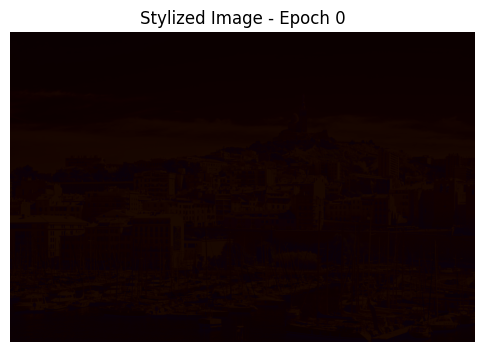

[1/500] Sinkhorn Loss: 0.450298
[2/500] Sinkhorn Loss: 0.425423
[3/500] Sinkhorn Loss: 0.425503
[4/500] Sinkhorn Loss: 0.424740
[5/500] Sinkhorn Loss: 0.422692
[6/500] Sinkhorn Loss: 0.398584
[7/500] Sinkhorn Loss: 0.399554
[8/500] Sinkhorn Loss: 0.399083
[9/500] Sinkhorn Loss: 0.380566
[10/500] Sinkhorn Loss: 0.365009


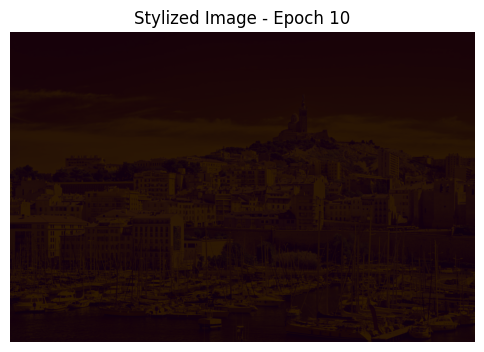

[11/500] Sinkhorn Loss: 0.363865
[12/500] Sinkhorn Loss: 0.360438
[13/500] Sinkhorn Loss: 0.362220
[14/500] Sinkhorn Loss: 0.350986
[15/500] Sinkhorn Loss: 0.345216
[16/500] Sinkhorn Loss: 0.334294
[17/500] Sinkhorn Loss: 0.334066
[18/500] Sinkhorn Loss: 0.323847
[19/500] Sinkhorn Loss: 0.317677
[20/500] Sinkhorn Loss: 0.303984


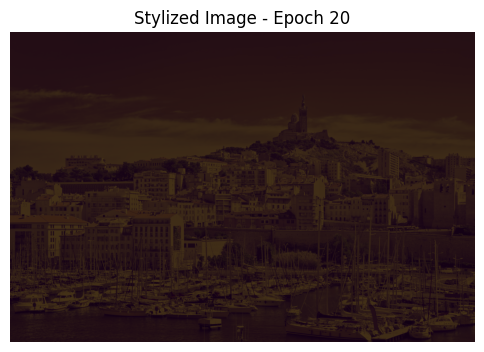

[21/500] Sinkhorn Loss: 0.302779
[22/500] Sinkhorn Loss: 0.291322
[23/500] Sinkhorn Loss: 0.293972
[24/500] Sinkhorn Loss: 0.275838
[25/500] Sinkhorn Loss: 0.267378
[26/500] Sinkhorn Loss: 0.264820
[27/500] Sinkhorn Loss: 0.263425
[28/500] Sinkhorn Loss: 0.251596
[29/500] Sinkhorn Loss: 0.251385
[30/500] Sinkhorn Loss: 0.240349


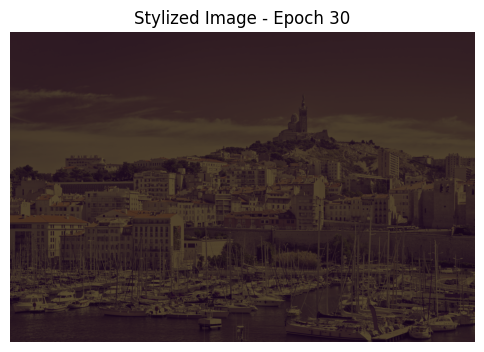

[31/500] Sinkhorn Loss: 0.236382
[32/500] Sinkhorn Loss: 0.229638
[33/500] Sinkhorn Loss: 0.216051
[34/500] Sinkhorn Loss: 0.214396
[35/500] Sinkhorn Loss: 0.210838
[36/500] Sinkhorn Loss: 0.204477
[37/500] Sinkhorn Loss: 0.196681
[38/500] Sinkhorn Loss: 0.192137
[39/500] Sinkhorn Loss: 0.177340
[40/500] Sinkhorn Loss: 0.179916


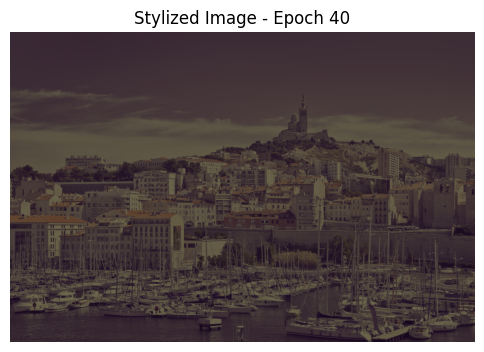

[41/500] Sinkhorn Loss: 0.169032
[42/500] Sinkhorn Loss: 0.162539
[43/500] Sinkhorn Loss: 0.166703
[44/500] Sinkhorn Loss: 0.157357
[45/500] Sinkhorn Loss: 0.151371
[46/500] Sinkhorn Loss: 0.148411
[47/500] Sinkhorn Loss: 0.139750
[48/500] Sinkhorn Loss: 0.139767
[49/500] Sinkhorn Loss: 0.123243
[50/500] Sinkhorn Loss: 0.126782


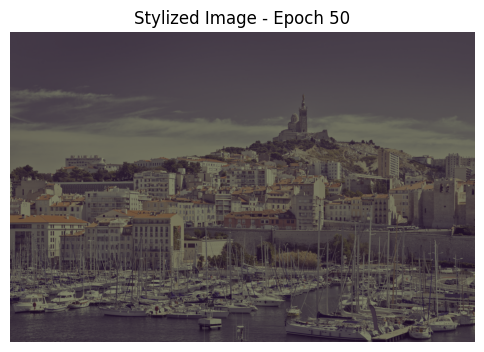

[51/500] Sinkhorn Loss: 0.117675
[52/500] Sinkhorn Loss: 0.119813
[53/500] Sinkhorn Loss: 0.110371
[54/500] Sinkhorn Loss: 0.112095
[55/500] Sinkhorn Loss: 0.103170
[56/500] Sinkhorn Loss: 0.101141
[57/500] Sinkhorn Loss: 0.094162
[58/500] Sinkhorn Loss: 0.092409
[59/500] Sinkhorn Loss: 0.081044
[60/500] Sinkhorn Loss: 0.082728


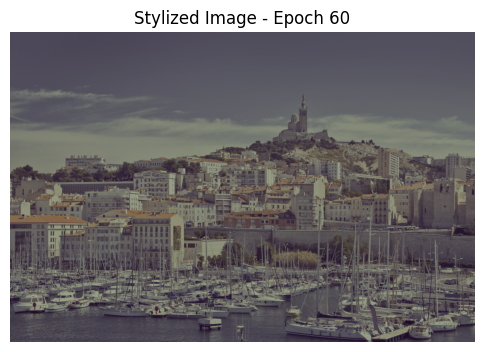

[61/500] Sinkhorn Loss: 0.081116
[62/500] Sinkhorn Loss: 0.076464
[63/500] Sinkhorn Loss: 0.072836
[64/500] Sinkhorn Loss: 0.066456
[65/500] Sinkhorn Loss: 0.065938
[66/500] Sinkhorn Loss: 0.060467
[67/500] Sinkhorn Loss: 0.055476
[68/500] Sinkhorn Loss: 0.059019
[69/500] Sinkhorn Loss: 0.052643
[70/500] Sinkhorn Loss: 0.049893


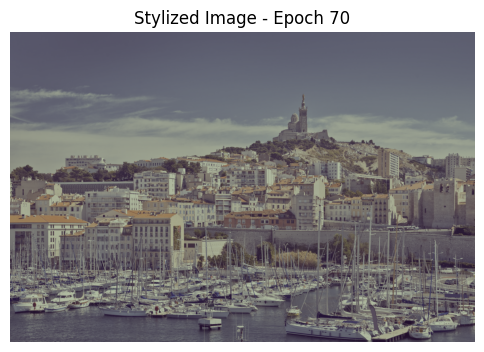

[71/500] Sinkhorn Loss: 0.050487
[72/500] Sinkhorn Loss: 0.049807
[73/500] Sinkhorn Loss: 0.047409
[74/500] Sinkhorn Loss: 0.044166
[75/500] Sinkhorn Loss: 0.041323
[76/500] Sinkhorn Loss: 0.042812
[77/500] Sinkhorn Loss: 0.036695
[78/500] Sinkhorn Loss: 0.035927
[79/500] Sinkhorn Loss: 0.036500
[80/500] Sinkhorn Loss: 0.034450


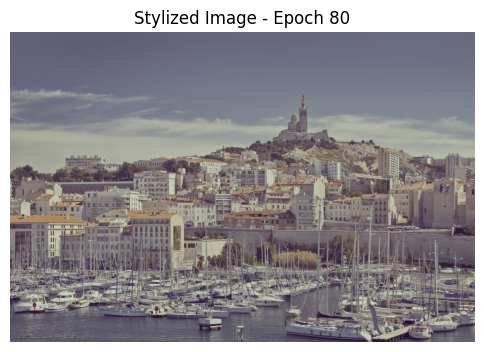

[81/500] Sinkhorn Loss: 0.032589
[82/500] Sinkhorn Loss: 0.031681
[83/500] Sinkhorn Loss: 0.031560
[84/500] Sinkhorn Loss: 0.029881
[85/500] Sinkhorn Loss: 0.029610
[86/500] Sinkhorn Loss: 0.030392
[87/500] Sinkhorn Loss: 0.028219
[88/500] Sinkhorn Loss: 0.027916
[89/500] Sinkhorn Loss: 0.028384
[90/500] Sinkhorn Loss: 0.028587


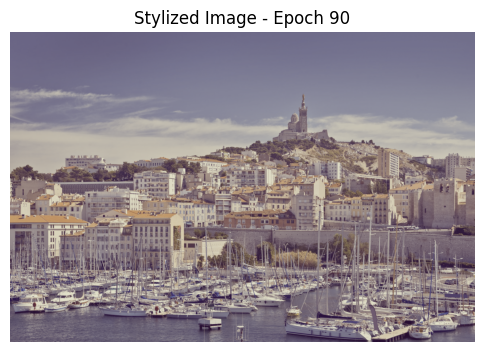

[91/500] Sinkhorn Loss: 0.026080
[92/500] Sinkhorn Loss: 0.025634
[93/500] Sinkhorn Loss: 0.024530
[94/500] Sinkhorn Loss: 0.023684
[95/500] Sinkhorn Loss: 0.025231
[96/500] Sinkhorn Loss: 0.024778
[97/500] Sinkhorn Loss: 0.024343
[98/500] Sinkhorn Loss: 0.024446
[99/500] Sinkhorn Loss: 0.021445
[100/500] Sinkhorn Loss: 0.023309


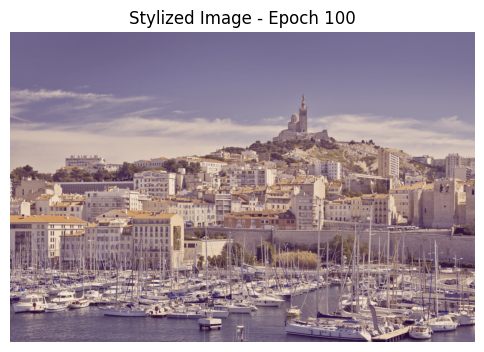

[101/500] Sinkhorn Loss: 0.021199
[102/500] Sinkhorn Loss: 0.021499
[103/500] Sinkhorn Loss: 0.019699
[104/500] Sinkhorn Loss: 0.020805
[105/500] Sinkhorn Loss: 0.020162
[106/500] Sinkhorn Loss: 0.020703
[107/500] Sinkhorn Loss: 0.019606
[108/500] Sinkhorn Loss: 0.020750
[109/500] Sinkhorn Loss: 0.020041
[110/500] Sinkhorn Loss: 0.018797


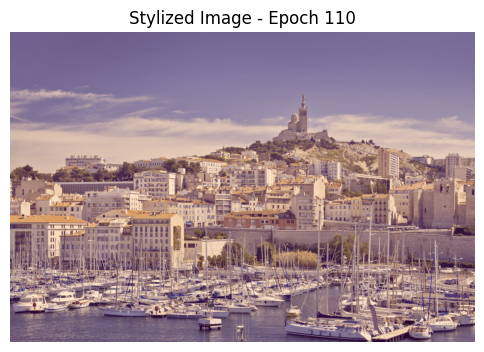

[111/500] Sinkhorn Loss: 0.017278
[112/500] Sinkhorn Loss: 0.018103
[113/500] Sinkhorn Loss: 0.016237
[114/500] Sinkhorn Loss: 0.016860
[115/500] Sinkhorn Loss: 0.015495
[116/500] Sinkhorn Loss: 0.017390
[117/500] Sinkhorn Loss: 0.016316
[118/500] Sinkhorn Loss: 0.014796
[119/500] Sinkhorn Loss: 0.016322
[120/500] Sinkhorn Loss: 0.013280


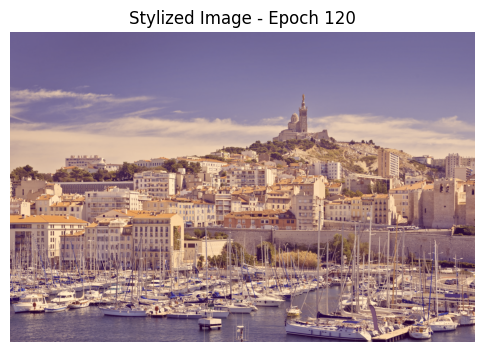

[121/500] Sinkhorn Loss: 0.013127
[122/500] Sinkhorn Loss: 0.012671
[123/500] Sinkhorn Loss: 0.014090
[124/500] Sinkhorn Loss: 0.012641
[125/500] Sinkhorn Loss: 0.012456
[126/500] Sinkhorn Loss: 0.013228
[127/500] Sinkhorn Loss: 0.010440
[128/500] Sinkhorn Loss: 0.012323
[129/500] Sinkhorn Loss: 0.009903
[130/500] Sinkhorn Loss: 0.009621


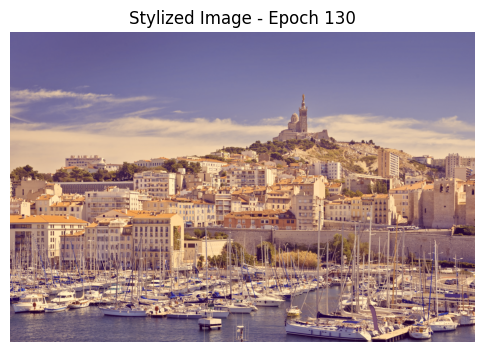

[131/500] Sinkhorn Loss: 0.010930
[132/500] Sinkhorn Loss: 0.010435
[133/500] Sinkhorn Loss: 0.011449
[134/500] Sinkhorn Loss: 0.010383
[135/500] Sinkhorn Loss: 0.009665
[136/500] Sinkhorn Loss: 0.008760
[137/500] Sinkhorn Loss: 0.008555
[138/500] Sinkhorn Loss: 0.009611
[139/500] Sinkhorn Loss: 0.009719
[140/500] Sinkhorn Loss: 0.007628


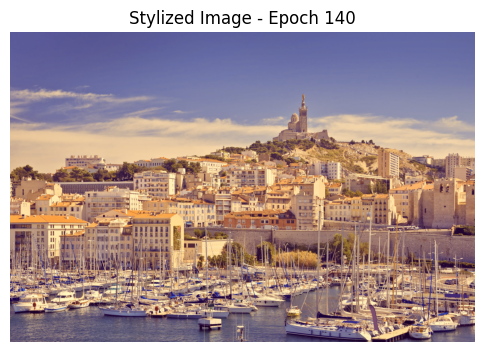

[141/500] Sinkhorn Loss: 0.009250
[142/500] Sinkhorn Loss: 0.007335
[143/500] Sinkhorn Loss: 0.009045
[144/500] Sinkhorn Loss: 0.009011
[145/500] Sinkhorn Loss: 0.008044
[146/500] Sinkhorn Loss: 0.007013
[147/500] Sinkhorn Loss: 0.008334
[148/500] Sinkhorn Loss: 0.010357
[149/500] Sinkhorn Loss: 0.005874
[150/500] Sinkhorn Loss: 0.007794


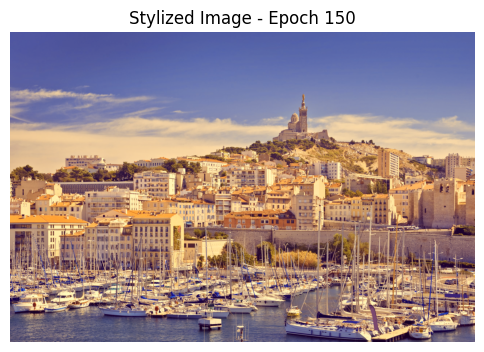

[151/500] Sinkhorn Loss: 0.009574
[152/500] Sinkhorn Loss: 0.008298
[153/500] Sinkhorn Loss: 0.007651
[154/500] Sinkhorn Loss: 0.007287
[155/500] Sinkhorn Loss: 0.005767
[156/500] Sinkhorn Loss: 0.009232
[157/500] Sinkhorn Loss: 0.006990
[158/500] Sinkhorn Loss: 0.008661
[159/500] Sinkhorn Loss: 0.006941
[160/500] Sinkhorn Loss: 0.005925


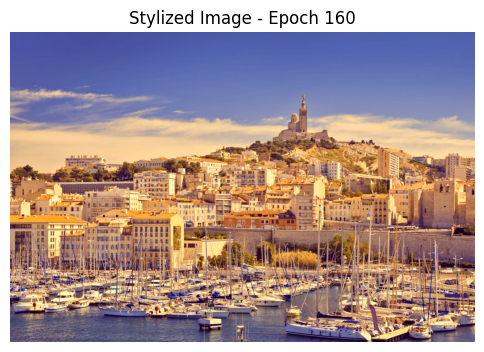

[161/500] Sinkhorn Loss: 0.006789
[162/500] Sinkhorn Loss: 0.005546
[163/500] Sinkhorn Loss: 0.005178
[164/500] Sinkhorn Loss: 0.004861
[165/500] Sinkhorn Loss: 0.005288
[166/500] Sinkhorn Loss: 0.006297
[167/500] Sinkhorn Loss: 0.004833
[168/500] Sinkhorn Loss: 0.005848
[169/500] Sinkhorn Loss: 0.005425
[170/500] Sinkhorn Loss: 0.006455


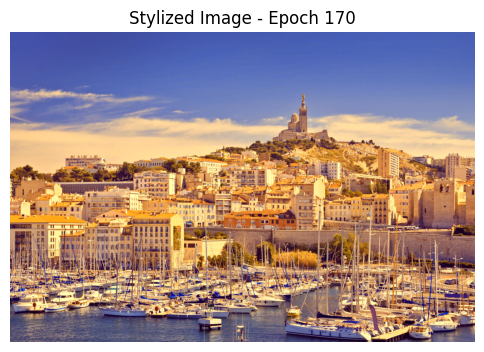

[171/500] Sinkhorn Loss: 0.007857
[172/500] Sinkhorn Loss: 0.005589
[173/500] Sinkhorn Loss: 0.004435
[174/500] Sinkhorn Loss: 0.005565
[175/500] Sinkhorn Loss: 0.004963
[176/500] Sinkhorn Loss: 0.006846
[177/500] Sinkhorn Loss: 0.007887
[178/500] Sinkhorn Loss: 0.005573
[179/500] Sinkhorn Loss: 0.009820
[180/500] Sinkhorn Loss: 0.009601


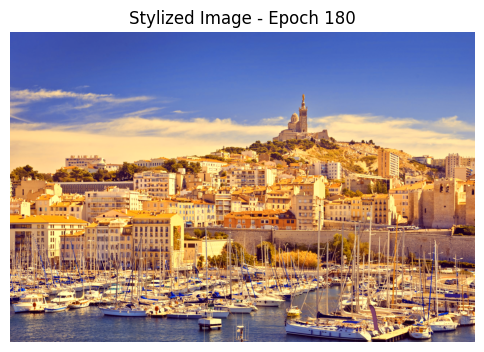

[181/500] Sinkhorn Loss: 0.008348
[182/500] Sinkhorn Loss: 0.007963
[183/500] Sinkhorn Loss: 0.007229
[184/500] Sinkhorn Loss: 0.007909
[185/500] Sinkhorn Loss: 0.007764
[186/500] Sinkhorn Loss: 0.006235
[187/500] Sinkhorn Loss: 0.006009
[188/500] Sinkhorn Loss: 0.008168
[189/500] Sinkhorn Loss: 0.006596
[190/500] Sinkhorn Loss: 0.007697


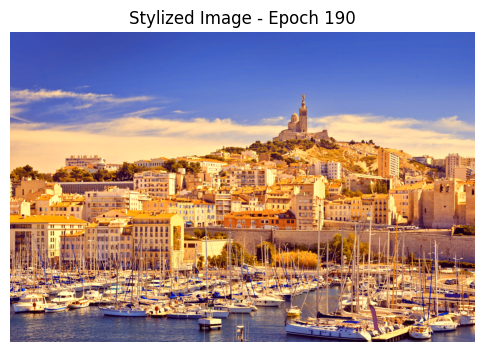

[191/500] Sinkhorn Loss: 0.010509
[192/500] Sinkhorn Loss: 0.006597
[193/500] Sinkhorn Loss: 0.009633
[194/500] Sinkhorn Loss: 0.008853
[195/500] Sinkhorn Loss: 0.009011
[196/500] Sinkhorn Loss: 0.007957
[197/500] Sinkhorn Loss: 0.006116
[198/500] Sinkhorn Loss: 0.007028
[199/500] Sinkhorn Loss: 0.009146
[200/500] Sinkhorn Loss: 0.009133


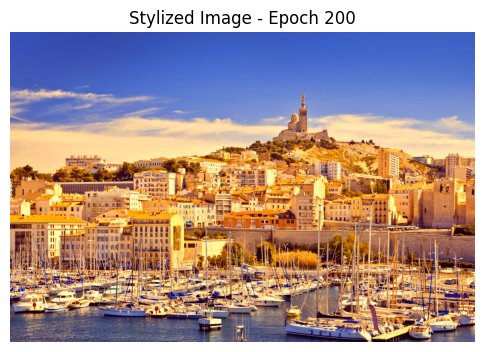

[201/500] Sinkhorn Loss: 0.006695
[202/500] Sinkhorn Loss: 0.008067
[203/500] Sinkhorn Loss: 0.008643
[204/500] Sinkhorn Loss: 0.010516
[205/500] Sinkhorn Loss: 0.011026
[206/500] Sinkhorn Loss: 0.010744
[207/500] Sinkhorn Loss: 0.010500
[208/500] Sinkhorn Loss: 0.011012
[209/500] Sinkhorn Loss: 0.011055
[210/500] Sinkhorn Loss: 0.008175


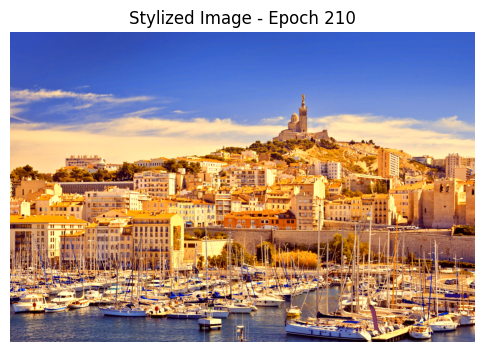

[211/500] Sinkhorn Loss: 0.009958
[212/500] Sinkhorn Loss: 0.010714
[213/500] Sinkhorn Loss: 0.009091
[214/500] Sinkhorn Loss: 0.008144
[215/500] Sinkhorn Loss: 0.011349
[216/500] Sinkhorn Loss: 0.010859
[217/500] Sinkhorn Loss: 0.011240
[218/500] Sinkhorn Loss: 0.010553
[219/500] Sinkhorn Loss: 0.009304
[220/500] Sinkhorn Loss: 0.008549


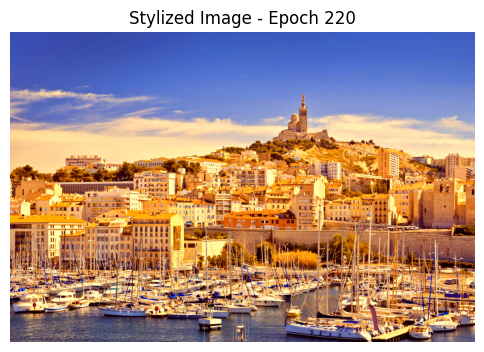

[221/500] Sinkhorn Loss: 0.007933
[222/500] Sinkhorn Loss: 0.008955
[223/500] Sinkhorn Loss: 0.006345
[224/500] Sinkhorn Loss: 0.008492
[225/500] Sinkhorn Loss: 0.011728
[226/500] Sinkhorn Loss: 0.010578
[227/500] Sinkhorn Loss: 0.010855
[228/500] Sinkhorn Loss: 0.012773
[229/500] Sinkhorn Loss: 0.011601
[230/500] Sinkhorn Loss: 0.010711


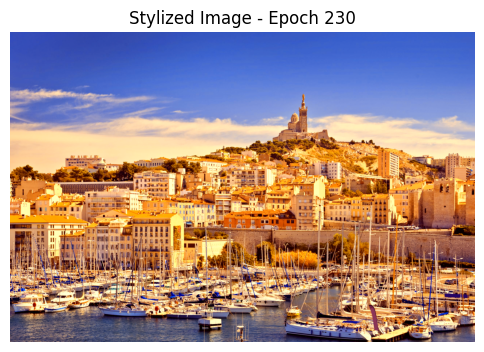

[231/500] Sinkhorn Loss: 0.010138
[232/500] Sinkhorn Loss: 0.010532
[233/500] Sinkhorn Loss: 0.011240
[234/500] Sinkhorn Loss: 0.010228
[235/500] Sinkhorn Loss: 0.008953
[236/500] Sinkhorn Loss: 0.010004
[237/500] Sinkhorn Loss: 0.008608
[238/500] Sinkhorn Loss: 0.012080
[239/500] Sinkhorn Loss: 0.009769
[240/500] Sinkhorn Loss: 0.010591


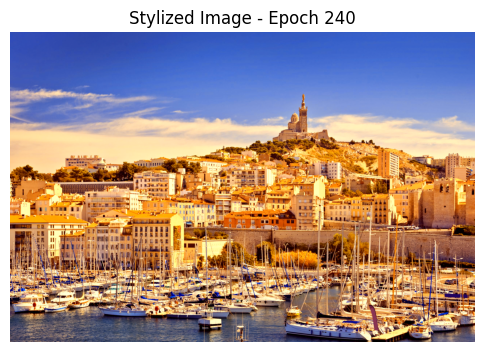

[241/500] Sinkhorn Loss: 0.010379
[242/500] Sinkhorn Loss: 0.010312
[243/500] Sinkhorn Loss: 0.007975
[244/500] Sinkhorn Loss: 0.009732
[245/500] Sinkhorn Loss: 0.010460
[246/500] Sinkhorn Loss: 0.011391
[247/500] Sinkhorn Loss: 0.010876
[248/500] Sinkhorn Loss: 0.007594
[249/500] Sinkhorn Loss: 0.008423
[250/500] Sinkhorn Loss: 0.007503


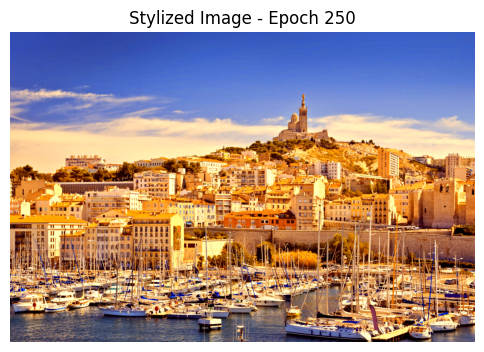

[251/500] Sinkhorn Loss: 0.011095
[252/500] Sinkhorn Loss: 0.008426
[253/500] Sinkhorn Loss: 0.009691
[254/500] Sinkhorn Loss: 0.009451
[255/500] Sinkhorn Loss: 0.012614
[256/500] Sinkhorn Loss: 0.011038
[257/500] Sinkhorn Loss: 0.010760
[258/500] Sinkhorn Loss: 0.010422
[259/500] Sinkhorn Loss: 0.009249
[260/500] Sinkhorn Loss: 0.009169


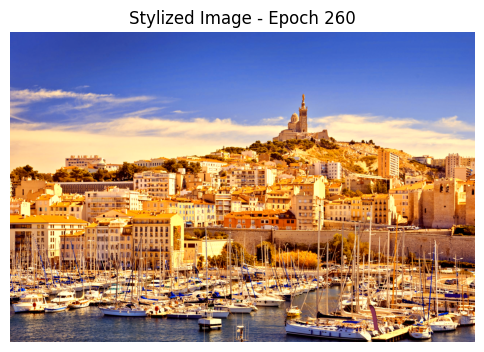

[261/500] Sinkhorn Loss: 0.011577
[262/500] Sinkhorn Loss: 0.010649
[263/500] Sinkhorn Loss: 0.011787
[264/500] Sinkhorn Loss: 0.009261
[265/500] Sinkhorn Loss: 0.008745
[266/500] Sinkhorn Loss: 0.009497
[267/500] Sinkhorn Loss: 0.009689
[268/500] Sinkhorn Loss: 0.010536
[269/500] Sinkhorn Loss: 0.009139
[270/500] Sinkhorn Loss: 0.008531


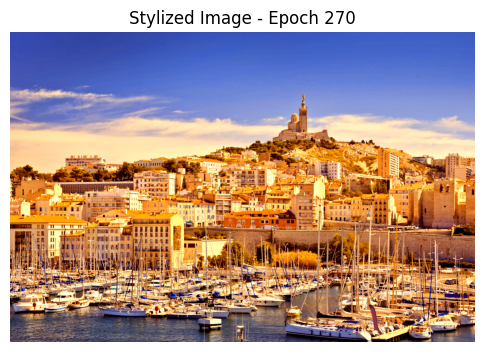

[271/500] Sinkhorn Loss: 0.009078
[272/500] Sinkhorn Loss: 0.010181
[273/500] Sinkhorn Loss: 0.009794
[274/500] Sinkhorn Loss: 0.009111
[275/500] Sinkhorn Loss: 0.011424
[276/500] Sinkhorn Loss: 0.009142
[277/500] Sinkhorn Loss: 0.009194
[278/500] Sinkhorn Loss: 0.010465
[279/500] Sinkhorn Loss: 0.012574
[280/500] Sinkhorn Loss: 0.008173


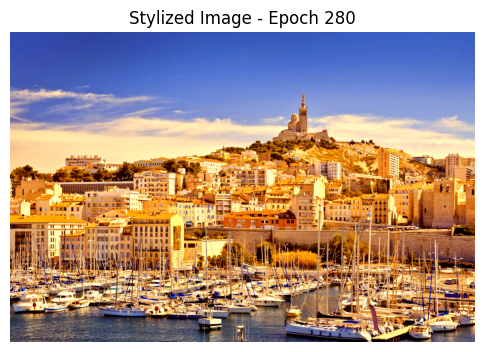

[281/500] Sinkhorn Loss: 0.007468
[282/500] Sinkhorn Loss: 0.009742
[283/500] Sinkhorn Loss: 0.010547
[284/500] Sinkhorn Loss: 0.009601
[285/500] Sinkhorn Loss: 0.008040
[286/500] Sinkhorn Loss: 0.009049
[287/500] Sinkhorn Loss: 0.009475
[288/500] Sinkhorn Loss: 0.010772
[289/500] Sinkhorn Loss: 0.011145
[290/500] Sinkhorn Loss: 0.008697


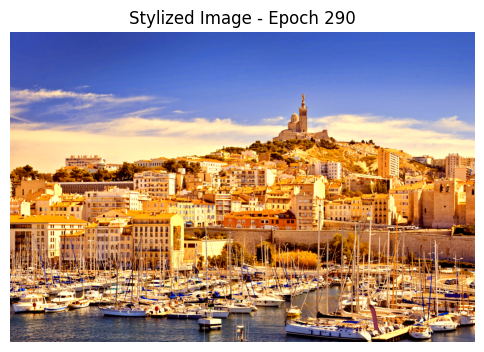

[291/500] Sinkhorn Loss: 0.010515
[292/500] Sinkhorn Loss: 0.008583
[293/500] Sinkhorn Loss: 0.010940
[294/500] Sinkhorn Loss: 0.011484
[295/500] Sinkhorn Loss: 0.010564
[296/500] Sinkhorn Loss: 0.009363
[297/500] Sinkhorn Loss: 0.010944
[298/500] Sinkhorn Loss: 0.009908
[299/500] Sinkhorn Loss: 0.012440
[300/500] Sinkhorn Loss: 0.013051


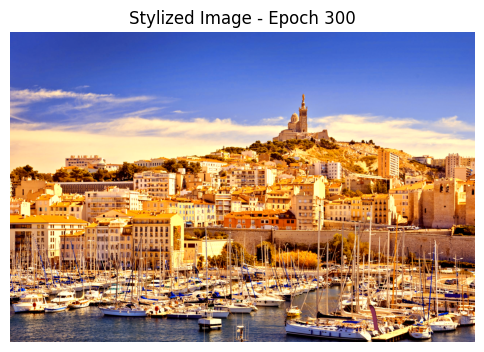

[301/500] Sinkhorn Loss: 0.012580
[302/500] Sinkhorn Loss: 0.011942
[303/500] Sinkhorn Loss: 0.012493
[304/500] Sinkhorn Loss: 0.011778
[305/500] Sinkhorn Loss: 0.009659
[306/500] Sinkhorn Loss: 0.009725
[307/500] Sinkhorn Loss: 0.012697
[308/500] Sinkhorn Loss: 0.009928
[309/500] Sinkhorn Loss: 0.007000
[310/500] Sinkhorn Loss: 0.010977


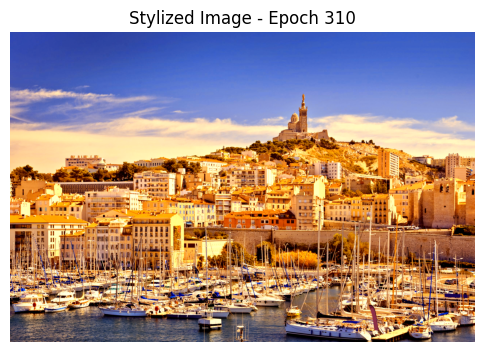

[311/500] Sinkhorn Loss: 0.009395
[312/500] Sinkhorn Loss: 0.008716
[313/500] Sinkhorn Loss: 0.009379
[314/500] Sinkhorn Loss: 0.005864
[315/500] Sinkhorn Loss: 0.010352
[316/500] Sinkhorn Loss: 0.009111
[317/500] Sinkhorn Loss: 0.011292
[318/500] Sinkhorn Loss: 0.011376
[319/500] Sinkhorn Loss: 0.010661
[320/500] Sinkhorn Loss: 0.011959


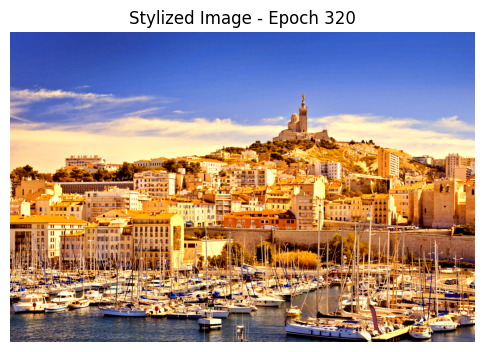

[321/500] Sinkhorn Loss: 0.012427
[322/500] Sinkhorn Loss: 0.011091
[323/500] Sinkhorn Loss: 0.010219
[324/500] Sinkhorn Loss: 0.009337
[325/500] Sinkhorn Loss: 0.011602
[326/500] Sinkhorn Loss: 0.011224
[327/500] Sinkhorn Loss: 0.009873
[328/500] Sinkhorn Loss: 0.010786
[329/500] Sinkhorn Loss: 0.009873
[330/500] Sinkhorn Loss: 0.011017


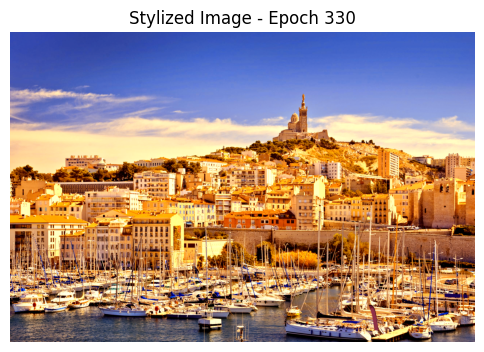

[331/500] Sinkhorn Loss: 0.008289
[332/500] Sinkhorn Loss: 0.008392


c:\Users\DAO.EZSPACE\anaconda3\envs\mva2\Lib\site-packages\geomloss\samples_loss.py:47: SyntaxWarning: invalid escape sequence '\i'
  """Creates a criterion that computes distances between sampled measures on a vector space.


KeyboardInterrupt: 

In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
from geomloss import SamplesLoss

# --- Initialisation des poids ---
def init_W(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim, in_dim) - k

def init_b(embed_dim, in_dim):
    k = np.sqrt(1 / in_dim)
    return 2 * k * torch.rand(embed_dim,) - k

# --- Modèle ---
class CascadeGradNet(nn.Module):
    def __init__(self, num_layers, in_dim, embed_dim, activation=nn.ReLU):
        super().__init__()
        self.num_layers = num_layers
        self.nonlinearity = nn.ModuleList([activation() for _ in range(num_layers)])
        self.W = nn.Parameter(init_W(embed_dim, in_dim), requires_grad=True)
        self.bias = nn.ParameterList([nn.Parameter(init_b(embed_dim, embed_dim)) for _ in range(num_layers + 1)])
        self.bias[0] = nn.Parameter(init_b(embed_dim, in_dim))
        self.bias[-1] = nn.Parameter(init_b(in_dim, embed_dim))
        self.beta = nn.ParameterList([nn.Parameter(torch.rand(embed_dim) - 0.5) for _ in range(num_layers)])
        self.alpha = nn.ParameterList([nn.Parameter(torch.rand(embed_dim) - 0.5) for _ in range(num_layers)])

    def forward(self, x):
        z = self.beta[0].view(1, -1) * F.linear(x, self.W, self.bias[0])
        for i in range(self.num_layers - 1):
            skip = self.beta[i + 1].view(1, -1) * F.linear(x, self.W, self.bias[i + 1])
            z = skip + self.alpha[i].view(1, -1) * self.nonlinearity[i](z)
        z = self.alpha[-1].view(1, -1) * self.nonlinearity[-1](z)
        z = F.linear(z, self.W.T, self.bias[-1])
        return z

# --- Sous-échantillonnage ---
def sample_batch(x, batch_size):
    idx = torch.randperm(x.shape[0])[:batch_size]
    return x[idx]

# --- Entraînement avec Sinkhorn (geomloss) ---
def train_transport_sinkhorn(model, x_input, x_target, size, epochs=1000, lr=1e-3, batch_size=2048, device='cpu', display_every=100):
    model.to(device)
    x_input = x_input.to(device)
    x_target = x_target.to(device)

    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    sinkhorn_loss = SamplesLoss(loss="sinkhorn", p=2, blur=0.01)

    for epoch in range(epochs):
        model.train()
        optimizer.zero_grad()

        x_input_batch = sample_batch(x_input, batch_size)
        x_target_batch = sample_batch(x_target, batch_size)

        x_output = model(x_input_batch).clamp(0, 1)
        loss = sinkhorn_loss(x_output, x_target_batch)

        loss.backward()
        optimizer.step()

        print(f"[{epoch}/{epochs}] Sinkhorn Loss: {loss.item():.6f}")

        if epoch % display_every == 0 or epoch == epochs - 1:
            model.eval()
            with torch.no_grad():
                stylized = model(x_input).clamp(0, 1)
            stylized_image = stylized.reshape(size[1], size[0], 3).cpu().numpy()
            plt.figure(figsize=(6, 6))
            plt.title(f"Stylized Image - Epoch {epoch}")
            plt.imshow(stylized_image)
            plt.axis('off')
            plt.show()

# --- Chargement des images ---
def image_to_colors(img_path):
    image = Image.open(img_path).convert('RGB')
    transform = transforms.ToTensor()
    tensor = transform(image).permute(1, 2, 0)  # [H, W, C]
    pixels = tensor.reshape(-1, 3)  # [N, 3]
    return pixels, image.size, tensor

def fit_gaussian(x):
    mu = x.mean(dim=0)
    cov = torch.from_numpy(np.cov(x.T.numpy())).float()
    return mu, cov

def sample_from_gaussian(mu, cov, n_samples):
    dist = torch.distributions.MultivariateNormal(mu, covariance_matrix=cov)
    return dist.sample((n_samples,))

# --- Application finale ---
def apply_transport(model, color_tensor, size):
    model.eval()
    with torch.no_grad():
        stylized = model(color_tensor).clamp(0, 1)
    stylized_image = stylized.reshape(size[1], size[0], 3).cpu().numpy()
    return stylized_image

# --- Pipeline complet ---
def style_transfer_pipeline_sinkhorn(image_source_path, image_style_path, save_path="stylized_output.jpg", epochs=1000, display_every=100, batch_size=2048):
    print("Chargement des images...")
    x_input, size, _ = image_to_colors(image_source_path)
    x_style, _, _ = image_to_colors(image_style_path)

    print("Estimation de la gaussienne de style...")
    mu_s, cov_s = fit_gaussian(x_style)
    x_target = sample_from_gaussian(mu_s, cov_s, x_input.shape[0])

    print("Initialisation du modèle...")
    model = CascadeGradNet(num_layers=3, in_dim=3, embed_dim=128)

    print("Entraînement avec Sinkhorn (geomloss)...")
    train_transport_sinkhorn(model, x_input, x_target, size,
                             epochs=epochs, lr=1e-3,
                             batch_size=batch_size,
                             display_every=display_every)

    print("Application finale du style...")
    final_image = apply_transport(model, x_input, size)

    final_pil = Image.fromarray((final_image * 255).astype(np.uint8))
    final_pil.save(save_path)
    print(f"✅ Image stylisée sauvegardée dans : {save_path}")

    # Affichage final
    plt.figure(figsize=(6, 6))
    plt.title("Résultat final")
    plt.imshow(final_image)
    plt.axis('off')
    plt.show()

# --- Exemple d'utilisation ---
# style_transfer_pipeline_sinkhorn("image_source.jpg", "image_style.jpg", epochs=500, batch_size=2048, display_every=50)
style_transfer_pipeline_sinkhorn("data/marseille.jpeg", "data/soleil2.jpg", save_path="stylized_output_sinkhorn.jpg", epochs=500, batch_size=2048, display_every=10)

NameError: name 'model' is not defined

In [4]:
def visualiser_transfert(model, image_source_path, image_style_path, size=None):
    # Charger images
    source_img = Image.open(image_source_path).convert('RGB')
    style_img = Image.open(image_style_path).convert('RGB')

    # Extraire pixels source
    x_input, img_size, _ = image_to_colors(image_source_path)
    if size is None:
        size = img_size

    # Appliquer le modèle
    stylized_image = apply_transport(model, x_input, size)

    # Convertir toutes les images pour affichage
    source_np = np.array(source_img.resize(size)) / 255.0
    style_np = np.array(style_img.resize(size)) / 255.0
    stylized_np = stylized_image  # déjà au bon format

    # Affichage côte à côte
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 3, 1)
    plt.title("Image Source")
    plt.imshow(source_np)
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.title("Style Cible")
    plt.imshow(style_np)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.title("Image Stylisée")
    plt.imshow(stylized_np)
    plt.axis("off")

    plt.tight_layout()
    plt.show()


In [5]:
# Après l'entraînement dans ton pipeline
visualiser_transfert(model, "data/marseille.jpeg", "data/soleil2.jpg")


NameError: name 'model' is not defined